# **Análisis Exploratorio de Datos**

## **Importación de Librerías**

In [ ]:
import pandas as pd
import glob
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from IPython.display import display
import plotly.express as px
from plotly.offline import plot
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from scipy.stats import chi2_contingency
from scipy import stats
import plotly.subplots as sp
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
import warnings
import json
from urllib.request import urlopen
with urlopen('https://gist.githubusercontent.com/john-guerra/43c7656821069d00dcbc/raw/be6a6e239cd5b5b803c6e7c2ec405b793a9064dd/Colombia.geo.json') as response:
    counties = json.load(response)

## **Funciones**

In [ ]:
def DescribeCategoricas(data):

  CategoricalColumns = data.select_dtypes(include=['object', 'category']).columns
  Results = pd.DataFrame()

  # Métricas para cada columna categórica
  for col in CategoricalColumns:
    # Resumen básico
    UniqueValues = data[col].nunique()
    TopValue = data[col].mode().values[0]
    FreqTopValue = data[col].value_counts().iloc[0]
    MissingValues = data[col].isnull().sum()

    Results[col] = [UniqueValues, TopValue, FreqTopValue, MissingValues]

  Results.index = ['Número de valores únicos', 'Valor más frecuente',
                     'Frecuencia del valor más frecuente', 'Valores faltantes']

  return Results

In [ ]:
def ResumenVariable(Data, Columna):
    # Valores únicos
    ValoresUnicos = Data[Columna].unique()
    print(f"Valores únicos en {Columna}: {ValoresUnicos}")

    # Valores faltantes
    ValoresFaltantes = Data[Columna].isnull().sum()
    print(f"\nValores faltantes en {Columna}: {ValoresFaltantes}")

In [ ]:
def TablaNARelacionados(data, GrupoCol, FaltanteCol):

    # Calcular los valores faltantes agrupados
    MissingValues = data.groupby(GrupoCol)[FaltanteCol].apply(lambda x: x.isnull().sum())

    MissingTable = pd.DataFrame(MissingValues).reset_index()

    MissingTable.columns = [GrupoCol, f'Valores Faltantes en {FaltanteCol}']

    display(MissingTable)

In [ ]:
# Paleta de colores personalizada
PurplePalette = [
        "#F7F4F9",  # Más claro
        "#DADAEB",  # Claro
        "#BCBDDC",  # Medio claro
        "#9E9AC8",  # Medio
        "#807DBA",  # Medio oscuro
        "#6A51A3",  # Oscuro
        "#54278F",  # Más oscuro
        "#3F007D",  # Muy oscuro
        "#2D004B",  # Casi negro
        "#1A0030"   # Negro morado
]

In [ ]:
# Diccionario de códigos de país a nombres (Top 10)
CodigosAPaises = {
    '170': 'Colombia',
    '862': 'Venezuela',
    '76': 'Brasil',
    '218': 'Ecuador',
    '604': 'Perú',
    '308': 'Granada',
    '840': 'Estados Unidos',
    '140': 'República Centroafricana',
    '500': 'Montserrat',
    '480': 'Mauricio',
    '000': 'Desconocido'
}

# Diccionario de códigos de CBMTE a nombres (Top 10)

CodigosADescripciones = {
    '0000': 'Pacientes vivos',
    'A419': 'Sepsis no especificada',
    'R571': 'Shock hipovolémico',
    'I469': 'Paro cardiaco',
    'R456': 'Violencia física',
    'R98X': 'Muerte sin asistencia',
    '8888': 'Desconocido',
    'E43X': 'Desnutrición proteicocalórica',
    '9999': 'Sin dato',
    'A09X': 'Diarrea y gastroenteritis infecciosas',
    'R092': 'Paro respiratorio'
}

OrdenCategorias = ['0 días', '1-7 días', '8-30 días', '31-365 días', '1-2 años', '> 2 años']

In [ ]:
import pandas as pd
import plotly.express as px

def PlotMissingValues(data):
    # Porcentaje de valores faltantes
    MissingPercentage = (data.isnull().sum() / len(data)) * 100
    MissingPercentage = MissingPercentage[MissingPercentage > 0]
    MissingPercentage = MissingPercentage.sort_values(ascending=False)

    # Gráfico de barras interactivo
    fig = px.bar(
        MissingPercentage,
        x=MissingPercentage.index,
        y=MissingPercentage.values,
        labels={'x': 'Variables', 'y': 'Porcentaje de Valores Faltantes (%)'},
        title='Porcentaje de Valores Faltantes por Variable',
        color=MissingPercentage.values,
        color_continuous_scale=PurplePalette,
        text=MissingPercentage.values.round(2)
    )

    max_value = MissingPercentage.max()
    y_axis_max = (max_value // 5 + 1) * 5
    y_axis_max = max(y_axis_max, 10)
    y_axis_max = y_axis_max + 10

    # Personalización del gráfico
    fig.update_layout(
        xaxis_title='Variables',
        yaxis_title='Porcentaje de Valores Faltantes',
        title_font_size=24,
        xaxis_tickangle=-45,
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(
            family="Georgia",
            size=14,
            color="black"
        ),
        title_font=dict(
            family="Georgia",
            size=24,
            color="black"
        ),
        yaxis=dict(range=[0, y_axis_max])
    )

    fig.update_traces(textposition='outside')

    fig.show()

In [ ]:
def CompararDistribucionPaises(DataAntes, DataDespues, ColumnaCodPais, CodigosAPaises, Top=10):
    import warnings
    import plotly.graph_objects as go
    import plotly.subplots as sp

    warnings.filterwarnings("ignore")

    # Obtener los top valores más frecuentes antes y después de la imputación
    top_antes = DataAntes[ColumnaCodPais].value_counts().nlargest(Top).index
    top_despues = DataDespues[ColumnaCodPais].value_counts().nlargest(Top).index

    # Filtrar los datos para incluir solo los top valores más frecuentes
    data_antes_top = DataAntes[DataAntes[ColumnaCodPais].isin(top_antes)]
    data_despues_top = DataDespues[DataDespues[ColumnaCodPais].isin(top_despues)]

    # Eliminar el ".0" de los valores en la columna de códigos y reemplazar con nombres de países
    data_antes_top[ColumnaCodPais] = (
        data_antes_top[ColumnaCodPais]
        .astype(str)
        .str.replace('.0', '', regex=False)
        .replace(CodigosAPaises)
    )
    data_despues_top[ColumnaCodPais] = (
        data_despues_top[ColumnaCodPais]
        .astype(str)
        .str.replace('.0', '', regex=False)
        .replace(CodigosAPaises)
    )

    # Calcular las frecuencias de cada categoría
    counts_antes = data_antes_top[ColumnaCodPais].value_counts().sort_values(ascending=False)
    counts_despues = data_despues_top[ColumnaCodPais].value_counts().sort_values(ascending=False)

    # Crear los subplots
    fig = sp.make_subplots(
        rows=1, cols=2,
        subplot_titles=("Distribución antes de imputar", "Distribución después de imputar")
    )

    # Gráfico de barras antes de imputar, con etiquetas sobre cada barra
    fig.add_trace(
        go.Bar(
            x=counts_antes.index,
            y=counts_antes.values,
            text=counts_antes.values,
            textposition='outside',       # Ubica el texto en la parte superior de la barra
            textangle=0,                 # Orientación horizontal del texto
            textfont=dict(color='black'),# Color de la fuente en negro
            marker_color='#9c89b8',      # Ejemplo de color (puedes cambiarlo según tu paleta)
            name="Antes"
        ),
        row=1, col=1
    )

    # Gráfico de barras después de imputar, con etiquetas sobre cada barra
    fig.add_trace(
        go.Bar(
            x=counts_despues.index,
            y=counts_despues.values,
            text=counts_despues.values,
            textposition='outside',
            textangle=0,
            textfont=dict(color='black'),
            marker_color='#5e548e',      # Otro color para diferenciarlos
            name="Después"
        ),
        row=1, col=2
    )

    # Personalización del gráfico
    fig.update_layout(
        title_text="Distribución antes y después de la imputación (COD_PAIS_R)",
        title_font_size=24,
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(
            family="Georgia",
            size=14,
            color="black"
        ),
        title_font=dict(
            family="Georgia",
            size=24,
            color="black"
        ),
        showlegend=False
    )

    # Configuración de los ejes en escala logarítmica
    fig.update_yaxes(type="log", row=1, col=1)
    fig.update_yaxes(type="log", row=1, col=2)

    # Ajustes para las etiquetas del eje x
    fig.update_xaxes(tickangle=45, categoryorder='total descending', row=1, col=1)
    fig.update_xaxes(tickangle=45, categoryorder='total descending', row=1, col=2)

    fig.show()


In [ ]:
def GraficarDistribucionCategorias(data, columna_categoria, orden_categorias=None):

    # Crear un DataFrame con la frecuencia de las categorías
    frecuencia_categorias = data[columna_categoria].value_counts().reset_index()
    frecuencia_categorias.columns = [columna_categoria, 'Frecuencia']

    # Definir el orden de las categorías
    if orden_categorias:
        frecuencia_categorias[columna_categoria] = pd.Categorical(
            frecuencia_categorias[columna_categoria],
            categories=orden_categorias,
            ordered=True
        )
        frecuencia_categorias = frecuencia_categorias.sort_values(columna_categoria)

    # Crear el gráfico de barras
    fig = px.bar(
        frecuencia_categorias,
        x=columna_categoria,
        y='Frecuencia',
        labels={columna_categoria: 'Categoría de diferencia', 'Frecuencia': 'Frecuencia'},
        title='Distribución de las categorías de diferencia',
        color=columna_categoria,
        color_discrete_sequence=PurplePalette
    )

    # Personalización del gráfico
    fig.update_layout(
        xaxis_title='Categoría de diferencia',
        yaxis_title='Frecuencia',
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(family="Georgia", size=14, color="black"),
        title_font=dict(family="Georgia", size=24, color="black"),
        showlegend=False
    )

    fig.show()

In [ ]:
def PlotDateComparisonSubplots(date_var, data_before, data_after):

    # Agrupar y contar registros por fecha en cada dataset
    df_before = (
        data_before.groupby(date_var).size().reset_index(name='Cuenta_Before')
    )
    df_after = (
        data_after.groupby(date_var).size().reset_index(name='Cuenta_After')
    )

    # Convertir a formato datetime si no lo está
    df_before[date_var] = pd.to_datetime(df_before[date_var])
    df_after[date_var]  = pd.to_datetime(df_after[date_var])

    # Ordenar por fecha
    df_before = df_before.sort_values(date_var)
    df_after  = df_after.sort_values(date_var)

    # Crear subplots con un título en cada uno
    fig = make_subplots(
        rows=1,
        cols=2,
        subplot_titles=(
            "Antes de la imputación",
            "Después de la imputación"
        ),
        shared_yaxes=True
    )

    # ---- Subplot 1: Antes de la imputación ----
    fig.add_trace(
        go.Scatter(
            x=df_before[date_var],
            y=df_before['Cuenta_Before'],
            mode='lines',
            line_shape='spline',
            line=dict(width=3, color=PurplePalette[3]),
            name="Antes"
        ),
        row=1,
        col=1
    )

    # ---- Subplot 2: Después de la imputación ----
    fig.add_trace(
        go.Scatter(
            x=df_after[date_var],
            y=df_after['Cuenta_After'],
            mode='lines',
            line_shape='spline',
            line=dict(width=3, color=PurplePalette[5]),
            name="Después"
        ),
        row=1,
        col=2
    )

    # Ajustar layout general
    fig.update_layout(
        title={
            'text': f"Comparación del inicio de síntomas antes y después de la imputación",
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'
        },
        font=dict(
            family="Georgia",
            size=14,
            color="black"
        ),
        title_font=dict(
            family="Georgia",
            size=24,
            color="black"
        ),
        plot_bgcolor='white',
        paper_bgcolor='white',
        showlegend=False,
    )

    fig.update_xaxes(
        showline=True,
        linewidth=1,
        linecolor='black',
        gridcolor='lightgray',
        tickangle=-45,
        title_text="Fecha",
        row=1,
        col=1
    )
    fig.update_xaxes(
        showline=True,
        linewidth=1,
        linecolor='black',
        gridcolor='lightgray',
        tickangle=-45,
        title_text="Fecha",
        row=1,
        col=2
    )
    fig.update_yaxes(
        showline=True,
        linewidth=1,
        linecolor='black',
        gridcolor='lightgray',
        title_text="Cantidad de registros",
        row=1,
        col=1
    )

    fig.show()


In [ ]:
def PlotTimeSeriesWithLimit(data, date_col):
    # Asegurarse de que la columna sea de tipo datetime
    if not pd.api.types.is_datetime64_any_dtype(data[date_col]):
        data[date_col] = pd.to_datetime(data[date_col], errors='coerce')

    # Crear una copia del DataFrame
    data_plot = data.copy()

    # Filtrar si es FEC_HOS o FEC_DEF para que no supere 2023-12-31
    if date_col in ['FEC_HOS', 'FEC_DEF']:
        data_plot = data_plot[data_plot[date_col] <= pd.Timestamp('2023-12-31')]

    # Agrupar por fecha (nivel de día) y contar la cantidad de registros
    df_ts = (
        data_plot.groupby(data_plot[date_col].dt.date)
                 .size()
                 .reset_index(name='count')
                 .sort_values(by=date_col)
    )

    # Crear gráfico de línea con Plotly Express
    fig = px.line(
        df_ts,
        x=date_col,
        y='count',
        title=f"Evolución de {date_col}",
        markers=True
    )

    # Personalizar el color de la línea
    fig.update_traces(line_color="#3F007D")

    # Ajustar diseño y estilo
    fig.update_layout(
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(
            family="Georgia",
            size=14,
            color="black"
        ),
        title_font=dict(
            family="Georgia",
            size=24,
            color="black"
        ),
        xaxis_title="Fecha",
        yaxis_title="Cantidad de Registros"
    )

    fig.show()


In [ ]:
def PlotBoxAndHistogram(data, variable):

    import plotly.graph_objects as go
    import plotly.subplots as sp

    # Filtrar datos si la variable es 'sem_ges'
    if variable == 'sem_ges':
        data_plot = data[data[variable] != 0]
    else:
        data_plot = data.copy()

    # Crear subplots: 1 fila, 2 columnas
    fig = sp.make_subplots(
        rows=1, cols=2,
        subplot_titles=(f"Boxplot de {variable}", f"Histograma de {variable}")
    )

    # Boxplot en la primera columna
    fig.add_trace(
        go.Box(
            y=data_plot[variable],
            boxmean=True,
            marker_color=PurplePalette[6],
            name=f"Boxplot de {variable}"
        ),
        row=1, col=1
    )

    # Histograma en la segunda columna
    fig.add_trace(
        go.Histogram(
            x=data_plot[variable],
            nbinsx=30,
            marker_color=PurplePalette[3],
            marker_line_color='black',   # Líneas de separación
            marker_line_width=1,           # Grosor de las líneas
            name=f"Histograma de {variable}",
            texttemplate='%{y}',
            textposition='outside'
        ),
        row=1, col=2
    )

    # Personalización del diseño general
    fig.update_layout(
        title_text=f"Distribución de {variable}",
        title_font_size=24,
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(
            family="Georgia",
            size=14,
            color="black"
        ),
        showlegend=False
    )

    # Etiquetas de ejes
    # - Columna 1 (boxplot)
    fig.update_xaxes(title_text='Observaciones', row=1, col=1)
    fig.update_yaxes(title_text=variable, row=1, col=1)

    # - Columna 2 (histograma)
    fig.update_xaxes(title_text=variable, row=1, col=2)
    fig.update_yaxes(title_text='Frecuencia', row=1, col=2)

    # Ajustar ángulo de las etiquetas en el histograma
    fig.update_xaxes(tickangle=45, row=1, col=2)

    fig.show()


## **Importación de Datos**

Para este estudio se descargaron de forma individual los datasets correspondientes a cada año entre 2018 y 2023, provenientes del **Sistema Nacional de Vigilancia en Salud Pública (Sivigila)**. Posteriormente, se unieron estos archivos en un único dataset consolidado que originalmente contaba con 75 variables.

Una vez integrado el dataset, se aplicaron dos filtros fundamentales: primero, se restringió la base de datos a los casos reportados exclusivamente para mujeres, y segundo, se normalizó la variable `EDAD` utilizando la unidad de medida indicada en `UNI_MED` para convertirla a años. Con este proceso se actualizaron los registros de edad en el mismo campo, y se eliminaron aquellos casos donde la edad superaba los 80 años. El resultado final fue un conjunto de datos depurado que cuenta con **584,450 registros**, el cual servirá como base para el análisis exploratorio y la construcción de modelos predictivos.

In [ ]:
Data = pd.read_csv("/content/drive/MyDrive/data.csv")
display(Data.head())

<ipython-input-9-0da35a8f5dd6>:1: DtypeWarning:

Columns (10,37,52,53,56,58,69) have mixed types. Specify dtype option on import or set low_memory=False.



,Partición,CONSECUTIVE,COD_EVE,FEC_NOT,SEMANA,ANO,COD_PRE,COD_SUB,EDAD,UNI_MED,...,Pais_ocurrencia,Nombre_evento,Departamento_ocurrencia,Municipio_ocurrencia,Pais_residencia,Departamento_residencia,Municipio_residencia,Departamento_Notificacion,Municipio_notificacion,COD_EVE.1
0,NaN,8913028,875,2022-09-13,37,2022,875800714,1,15.0,1,...,COLOMBIA,VCM VIF VSX,ATLANTICO,SOLEDAD,COLOMBIA,ATLANTICO,SOLEDAD,ATLANTICO,SOLEDAD,NaN
1,NaN,8917556,875,2022-03-05,9,2022,1100106453,1,28.0,1,...,COLOMBIA,VCM VIF VSX,BOGOTA,BOGOTA,COLOMBIA,BOGOTA,BOGOTA,BOGOTA,BOGOTA,NaN
2,NaN,8917557,875,2022-02-07,6,2022,6808100797,1,31.0,1,...,COLOMBIA,VCM VIF VSX,SANTANDER,BARRANCABERMEJA,COLOMBIA,SANTANDER,BARRANCABERMEJA,SANTANDER,BARRANCABERMEJA,NaN
3,NaN,8917558,875,2022-11-25,47,2022,2575400078,3,32.0,1,...,COLOMBIA,VCM VIF VSX,CUNDINAMARCA,SOACHA,COLOMBIA,CUNDINAMARCA,SOACHA,CUNDINAMARCA,SOACHA,NaN
4,NaN,8913029,875,2022-05-27,21,2022,1100130289,2,14.0,1,...,COLOMBIA,VCM VIF VSX,BOGOTA,BOGOTA,COLOMBIA,BOGOTA,BOGOTA,BOGOTA,BOGOTA,NaN


In [ ]:
import pandas as pd

# Convertir la columna FEC_NOT a datetime
Data['FEC_NOT'] = pd.to_datetime(Data['FEC_NOT'], format='%Y-%m-%d', errors='coerce')

# Filtrar para conservar solo registros con fecha de notificación a partir del 1 de enero de 2018
# y que en la columna ANO sean mayores o iguales a 2018
Data = Data[(Data['FEC_NOT'] >= pd.Timestamp('2018-01-01')) & (Data['ANO'] >= 2018)]

# Verificar los resultados
print("Fecha mínima después del filtrado:", Data['FEC_NOT'].min())
print("Número de registros después del filtrado:", len(Data))


Fecha mínima después del filtrado: 2018-01-01 00:00:00
Número de registros después del filtrado: 584450


In [ ]:
print(f"Cantidad de registros: {Data.shape[0]}, Cantidad de variables: {Data.shape[1]}")

Cantidad de registros: 584450, Cantidad de variables: 75


## **Análisis y limpieza preliminar**

### **Eliminación inicial de variables no relevantes**

Tras la consolidación de los archivos, se realizó una selección inicial de columnas que no aportaban información relevante para el análisis. Se descartaron variables relacionadas con datos internos del registro de Sivigila, tales como la fecha de ajuste y el número de registro, los cuales no resultaban útiles para el análisis de reincidencia. Asimismo, se eliminaron columnas con información redundante o constante, como el código del evento (registrado siempre como 875, dado que todos los casos corresponden a violencia basada en género) y campos duplicados, tales como los códigos y nombres de lugares (país, departamento y municipio) de residencia, notificación y ocurrencia.

Adicionalmente, y en concordancia con la restricción de la base de datos únicamente a casos de mujeres, se eliminó la variable "SEXO". Con la asesoría de expertos en el tema, se identificaron y retiraron otras variables consideradas menos pertinentes, garantizando así un conjunto de datos más limpio y focalizado para el análisis posterior. Como resultado, la base de datos final quedó con **584,450 registros y 42 variables**, optimizando su estructura para análisis posteriores.

In [ ]:
DeleteColumns = [
    'Partición', 'COD_EVE', 'COD_PRE', 'COD_SUB', 'nombre_nacionalidad', 'AREA', 'COD_ASE', 'nom_grupo', 'AJUSTE',
    'FEC_ARC_XL', 'FEC_AJU', 'FM_FUERZA', 'FM_UNIDAD', 'FM_GRADO', 'confirmados', 'va_sispro', 'consecutive_origen',
    'COD_EVE.1', 'CONSECUTIVE', 'Nom_upgd', 'Pais_ocurrencia', 'Departamento_ocurrencia','Municipio_ocurrencia',
    'Pais_residencia','Municipio_residencia', 'Departamento_Notificacion','Municipio_notificacion', 'FECHA_NTO',
    'Nombre_evento', 'CER_DEF', 'OCUPACION', 'nom_est_f_caso', 'SEXO', 'nacionalidad', 'fuente'
  ]

Data = Data.drop(columns=DeleteColumns, errors='ignore')

In [ ]:
print(f"Cantidad de registros: {Data.shape[0]}, Cantidad de variables: {Data.shape[1]}")

Cantidad de registros: 584450, Cantidad de variables: 40


### **Asignación inicial del tipo de variable**

Después de consolidar y limpiar preliminarmente la base de datos, se realizó una asignación inicial del tipo de variable acorde a su naturaleza, estableciendo una base sólida para análisis posteriores. Así, se transformaron a cadenas de texto variables que representan información categórica, tales como `UNI_MED`, `nacionalidad`, `SEXO` y los códigos correspondientes a la ubicación de ocurrencia, notificación o residencia (`COD_PAIS`, `COD_DPTO` y `COD_MUN`), entre otros. De igual forma, se procedió a convertir las variables temporales (`FEC_NOT`, `FEC_CON`, `INI_SIN`, `FEC_HOS` y `FEC_DEF`) al formato de fecha, lo que permitió organizar cronológicamente la información. Finalmente, se transformaron a valores numéricos, en formato entero, aquellas variables cuantitativas relevantes como `SEMANA`, `ANO`, `EDAD` y `sem_ges`. Esta asignación preliminar, que puede ajustarse según los requerimientos específicos en fases posteriores del estudio, garantiza la consistencia y calidad de los datos para el análisis.

In [ ]:
# Conversión a cadenas (string)
Data['UNI_MED'] = Data['UNI_MED'].astype(str)
Data['COD_PAIS_O'] = Data['COD_PAIS_O'].astype(str)
Data['COD_DPTO_O'] = Data['COD_DPTO_O'].astype(str)
Data['COD_MUN_O'] = Data['COD_MUN_O'].astype(str)
Data['TIP_SS'] = Data['TIP_SS'].astype(str)
Data['PER_ETN'] = Data['PER_ETN'].astype(str)
Data['GRU_POB'] = Data['GRU_POB'].astype(str)
Data['GP_DISCAPA'] = Data['GP_DISCAPA'].astype(str)
Data['GP_DESPLAZ'] = Data['GP_DESPLAZ'].astype(str)
Data['GP_MIGRANT'] = Data['GP_MIGRANT'].astype(str)
Data['GP_CARCELA'] = Data['GP_CARCELA'].astype(str)
Data['GP_GESTAN'] = Data['GP_GESTAN'].astype(str)
Data['GP_INDIGEN'] = Data['GP_INDIGEN'].astype(str)
Data['GP_POBICFB'] = Data['GP_POBICFB'].astype(str)
Data['GP_MAD_COM'] = Data['GP_MAD_COM'].astype(str)
Data['GP_DESMOVI'] = Data['GP_DESMOVI'].astype(str)
Data['GP_PSIQUIA'] = Data['GP_PSIQUIA'].astype(str)
Data['GP_VIC_VIO'] = Data['GP_VIC_VIO'].astype(str)
Data['GP_OTROS'] = Data['GP_OTROS'].astype(str)
Data['COD_PAIS_R'] = Data['COD_PAIS_R'].astype(str)
Data['COD_DPTO_R'] = Data['COD_DPTO_R'].astype(str)
Data['COD_MUN_R'] = Data['COD_MUN_R'].astype(str)
Data['COD_DPTO_N'] = Data['COD_DPTO_N'].astype(str)
Data['COD_MUN_N'] = Data['COD_MUN_N'].astype(str)
Data['TIP_CAS'] = Data['TIP_CAS'].astype(str)
Data['PAC_HOS'] = Data['PAC_HOS'].astype(str)
Data['CON_FIN'] = Data['CON_FIN'].astype(str)
Data['CBMTE'] = Data['CBMTE'].astype(str)
Data['Estado_final_de_caso'] = Data['Estado_final_de_caso'].astype(str)

# Conversión a fechas
Data['FEC_NOT'] = pd.to_datetime(Data['FEC_NOT'], format='%Y-%m-%d', errors='coerce')
Data['FEC_CON'] = pd.to_datetime(Data['FEC_CON'], format='%Y-%m-%d', errors='coerce')
Data['INI_SIN'] = pd.to_datetime(Data['INI_SIN'], format='%Y-%m-%d', errors='coerce')
Data['FEC_HOS'] = pd.to_datetime(Data['FEC_HOS'], format='%Y-%m-%d', errors='coerce')
Data['FEC_DEF'] = pd.to_datetime(Data['FEC_DEF'], format='%Y-%m-%d', errors='coerce')

# Conversión a numéricos (enteros)
Data['SEMANA'] = pd.to_numeric(Data['SEMANA'], errors='coerce').astype('Int64')
Data['ANO'] = pd.to_numeric(Data['ANO'], errors='coerce').astype('Int64')
Data['EDAD'] = pd.to_numeric(Data['EDAD'], errors='coerce').astype('float')
Data['sem_ges'] = pd.to_numeric(Data['sem_ges'], errors='coerce').astype('Int64')

### **Análisis preliminar de variables numéricas y temporales**

In [ ]:
display(Data.describe())

,FEC_NOT,SEMANA,ANO,EDAD,sem_ges,FEC_CON,INI_SIN,FEC_HOS,FEC_DEF
count,584450,584450.0,584450.0,584450.000000,30805.0,584446,550790,94622,449
mean,2021-03-25 02:06:55.824792832,27.247814,2020.704189,24.165971,19.475702,2021-03-21 21:25:44.514977024,2021-04-03 00:44:51.499845888,2021-06-01 18:43:31.029147392,2020-12-08 10:57:27.661470720
min,2018-01-01 00:00:00,1.0,2018.0,0.000002,1.0,2008-07-03 00:00:00,2001-01-01 00:00:00,2017-12-31 00:00:00,2018-01-01 00:00:00
25%,2019-08-28 00:00:00,14.0,2019.0,13.000000,10.0,2019-08-25 00:00:00,2019-09-25 00:00:00,2019-11-22 00:00:00,2019-04-13 00:00:00
50%,2021-05-26 00:00:00,28.0,2021.0,22.000000,18.0,2021-05-23 00:00:00,2021-06-25 00:00:00,2021-09-12 00:00:00,2021-01-29 00:00:00
75%,2022-10-20 00:00:00,40.0,2022.0,33.000000,28.0,2022-10-18 00:00:00,2022-11-02 00:00:00,2022-12-11 00:00:00,2022-06-25 00:00:00
max,2023-12-31 00:00:00,53.0,2023.0,80.000000,45.0,2023-12-30 00:00:00,2023-12-30 00:00:00,2023-12-30 00:00:00,2023-12-26 00:00:00
std,NaN,14.831161,1.747905,15.733137,10.881358,NaN,NaN,NaN,NaN


La descripción estadística de las variables numéricas ofrece una visión global de la distribución y el rango de valores en el conjunto de datos. A continuación, se presentan algunos puntos destacados:

- **Fechas de Notificación (FEC_NOT):**  
  - El conteo (*count*) de 586.153 indica que la gran mayoría de los registros cuentan con una fecha de notificación válida.  
  - La fecha mínima es **2018-01-01** y la máxima es **2023-12-31**, lo que confirma que el filtrado temporal se aplicó correctamente.  

- **Semana Epidemiológica (SEMANA) y Año (AÑO):**  
  - La `SEMANA` tiene un valor medio cercano a 27, lo cual sugiere que la mayoría de los casos se concentran hacia la mitad del año epidemiológico.  
  - El `AÑO` presenta un promedio de 2020.8, consistente con un rango que va de 2018 a 2023, tal como se definió en el filtrado.  

- **Edad (EDAD):**  
  - Con una media de alrededor de 24.3 años y una mediana cercana a 20, se observa que la población atendida es predominantemente joven.  
  - El mínimo es 0 y el máximo 80, confirmando la restricción de eliminar casos con edades superiores a 80 años.  

- **Gestación (sem_pes):**  
  - Está presente en 380.661 registros, lo que indica que no todas las víctimas reportaron este dato (o no aplicaba).  
  - El promedio se sitúa en torno a 12.2 semanas, con un rango de 1 a 45, abarcando desde inicios del embarazo hasta prácticamente el término.  

- **Fechas de Consulta (FEC_CON), Inicio de Síntomas (INI_SIN), Hospitalización (FEC_HOS) y Defunción (FEC_DEF):**  
  - No todos los casos cuentan con estas variables, de ahí que el *count* sea menor en comparación con `FEC_NOT`.  
  - El número de hospitalizaciones `FEC_HOS` registradas es de 9.444, mientras que solo 449 casos tienen fecha de defunción `FEC_DEF`, lo que refleja que son desenlaces menos frecuentes.  
  - El rango de fechas en cada una se mantiene dentro del período 2018–2023, y la media se ubica alrededor de mediados de 2021, lo cual coincide con la distribución general de las notificaciones.  

En conjunto, estas estadísticas confirman que el filtrado temporal y por edad se ha aplicado correctamente, y muestran que la mayoría de las víctimas son mujeres jóvenes, con un rango amplio en variables como la semana epidemiológica y la fecha de notificación. Además, la menor frecuencia de hospitalizaciones y defunciones subraya la importancia de explorar qué factores se asocian con desenlaces más graves dentro de esta población.

## **Análisis preliminar de variables categóricas**

Para explorar las variables categóricas en el conjunto de datos, se implementó una función que identifica columnas de tipo “object” o “category” y, para cada una, calcula estadísticas de interés como el número de valores únicos, el valor más frecuente, su frecuencia absoluta y la cantidad de valores faltantes. A continuación, se muestra la salida resultante de la ejecución de esta función.

In [ ]:
DescribeCategoricas(Data)

,UNI_MED,COD_PAIS_O,COD_DPTO_O,COD_MUN_O,TIP_SS,PER_ETN,GRU_POB,estrato,GP_DISCAPA,GP_DESPLAZ,...,COD_DPTO_R,COD_MUN_R,COD_DPTO_N,COD_MUN_N,TIP_CAS,PAC_HOS,CON_FIN,CBMTE,Estado_final_de_caso,Departamento_residencia
Número de valores únicos,5,48,35,595,6,6,1,7,2,2,...,35,594,33,1112,1,2,2,183,1,35
Valor más frecuente,1,170,5,1,S,6,nan,1,2,2,...,5,1,5,11001,1,2,1,nan,1,ANTIOQUIA
Frecuencia del valor más frecuente,571467,581679,102346,271478,306757,549699,584450,236218,581061,578565,...,102474,273627,102899,82100,584450,489828,584001,584057,584450,102474
Valores faltantes,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Se observa que varias variables categóricas presentan un alto grado de concentración en una o pocas categorías. Por ejemplo, `TIP_CAS` tiene un único valor, lo que indica que todos los registros corresponden a un mismo tipo de caso según la clasificación utilizada, en este caso: "sospechoso". Otras variables, como `PAC_HOS` (hospitalización) y `CON_FIN` (condición final), muestran un valor dominante *2* ("no hospitalizado") y *1* ("vivo"), respectivamente que abarca la mayoría de los registros, lo que sugiere que, en la práctica, el número de casos hospitalizados y de desenlaces fatales es menor en comparación con el total. Asimismo, variables como `Departamento_residencia` evidencian un número considerable de valores únicos, lo que denota la diversidad geográfica de la población estudiada, pero también presentan un volumen notable de datos faltantes (por ejemplo, 102807), factor que será importante manejar mediante estrategias de imputación o filtrado. Este panorama confirma la necesidad de un tratamiento cuidadoso de los datos categóricos para evitar sesgos y garantizar la robustez de los modelos que se implementarán posteriormente.

## **Análisis de Datos Faltantes**

En cualquier investigación basada en datos, la presencia de valores faltantes constituye un desafío significativo que puede afectar la calidad y la confiabilidad de los resultados. Según Rubin (1976) \cite{rubin1976inference}, los datos faltantes pueden deberse a múltiples causas, incluyendo errores de recolección, ausencia de registro o la no aplicabilidad de ciertas variables en casos específicos. En este estudio, resulta esencial identificar y gestionar adecuadamente estos valores, ya que su presencia podría sesgar los análisis posteriores y disminuir la eficacia de los modelos predictivos.

Como parte de este proceso, para las variables categóricas se consideraron como valores faltantes las cadenas vacías (`''`), espacios en blanco (`' '`), así como las representaciones de valores nulos (`'NaN'`, `'NULL'`, `'nan'`, `'null'`). El análisis de datos faltantes no solo ayuda a cuantificar su magnitud, sino también a evaluar posibles patrones en su distribución, lo cual es determinante para seleccionar la estrategia de imputación o eliminación más adecuada. A continuación, se presenta un examen detallado de los valores faltantes en el dataset, destacando las variables con mayor impacto y proponiendo soluciones para minimizar su efecto en el análisis y la construcción de modelos.

In [ ]:
# Columnas categóricas
CategoricalColumns = Data.select_dtypes(include=['object', 'category']).columns

# Valores faltantes en columnas categóricas
MissingCategorical = Data[CategoricalColumns].isnull().sum()

# Cadenas vacías y otros valores a NA
Data[CategoricalColumns] = Data[CategoricalColumns].replace(['', ' ', 'NaN', 'NULL', 'nan', 'null'], pd.NA)

# Verificar nuevamente los valores faltantes
MissingCategoricalUpdated = Data[CategoricalColumns].isnull().sum()
print(MissingCategoricalUpdated[MissingCategoricalUpdated > 0])

GRU_POB       584450
COD_PAIS_R    180028
CBMTE         584057
dtype: int64


In [ ]:
PlotMissingValues(Data)

En la gráfica se observa que varias variables presentan un alto porcentaje de valores faltantes, con algunas superando incluso el 90%. Esto sugiere que, o bien no resultan aplicables para la mayoría de los casos (como podría ser el caso de una fecha de defunción cuando la víctima sobrevive), o bien existe un subregistro importante en la captura de dicha información. Por ejemplo, variables como `GRU_POB` y `CBMTE` muestran prácticamente el 100% de datos faltantes, lo que podría indicar que se trata de campos muy específicos o que su registro no es obligatorio en la notificación.

En contraste, otras variables como `FEC_CON` tienen un porcentaje nulo o muy bajo de datos faltantes, lo que indica una mayor consistencia en el registro de estos campos. Esta disparidad refuerza la necesidad de un tratamiento diferenciado de los valores faltantes según su naturaleza: algunas variables podrían requerir imputación selectiva (si la ausencia de datos sigue un patrón predecible), mientras que en otros casos podría ser necesario descartar la variable o transformarla en un indicador binario (por ejemplo, “información disponible” vs. “no disponible”), dependiendo de la relevancia para el análisis o el modelado. En las secciones siguientes, se abordará cada variable con alto porcentaje de valores faltantes para decidir el mejor enfoque de tratamiento.

### **Tratamiento de datos faltantes según su naturaleza**

#### **Análisis del Grupo Poblacional (`GRU_POB`)**

En el análisis de la variable `GRU_POB` (grupo poblacional), se identificó que los valores únicos no estaban relacionados con la naturaleza de la variable, ya que consistían en números sin un significado claro o consistente. Sin embargo, se observó que existían 12 variables relacionadas, como `GP_DISCAPA` (discapacitado), `GP_DESPLAZ` (desplazado), `GP_MIGRANT` (migrante), entre otras, las cuales contenían valores de 1 (Sí pertenece) y 2 (No pertenece). Estas variables permiten categorizar a las víctimas en grupos poblacionales específicos, lo que resulta relevante para entender las dinámicas de la violencia de género en contextos particulares. Dado que `GRU_POB` no proporcionaba información útil, se decidió utilizar estas variables relacionadas para clasificar a las víctimas en grupos poblacionales, sin depender de la variable original. Este enfoque permitió mantener la información relevante y mejorar la calidad del análisis.

In [ ]:
ResumenVariable(Data, 'GRU_POB')

Valores únicos en GRU_POB: [<NA>]

Valores faltantes en GRU_POB: 584450


In [ ]:
# Valores faltantes en columnas relacionadas
RelatedColumns = ['GP_DISCAPA', 'GP_DESPLAZ', 'GP_MIGRANT', 'GP_CARCELA',
                  'GP_GESTAN', 'GP_INDIGEN', 'GP_POBICFB', 'GP_MAD_COM',
                  'GP_DESMOVI', 'GP_PSIQUIA', 'GP_VIC_VIO', 'GP_OTROS']

display(Data[RelatedColumns].isnull().sum())
print ("\nLas variables relacionadas no contienen valores faltantes.")

,0
GP_DISCAPA,0
GP_DESPLAZ,0
GP_MIGRANT,0
GP_CARCELA,0
GP_GESTAN,0
GP_INDIGEN,0
GP_POBICFB,0
GP_MAD_COM,0
GP_DESMOVI,0
GP_PSIQUIA,0



Las variables relacionadas no contienen valores faltantes.


In [ ]:
# Eliminación la columna GRU_POB
Data = Data.drop(columns=['GRU_POB'])

# Verificar que la columna ha sido eliminada
print(f"Cantidad de registros: {Data.shape[0]}, Cantidad de variables: {Data.shape[1]}")

Cantidad de registros: 584450, Cantidad de variables: 39


```{admonition} Imposibilidad de unificar el grupo poblacional
:class: tip
Dentro del análisis de estas variables relacionadas con el grupo poblacional, se consideró la posibilidad de unificar en una sola columna el grupo poblacional al que pertenecía la víctima, con el objetivo de reducir la dimensionalidad de la base de datos. Sin embargo, esta propuesta no fue viable debido a que una víctima podía pertenecer a dos o más grupos poblacionales simultáneamente (por ejemplo, ser desplazada y migrante al mismo tiempo). Por lo tanto, se decidió mantener las variables separadas para preservar la precisión y la integridad de la información, evitando la pérdida de datos relevantes sobre la pertenencia de las víctimas a múltiples grupos poblacionales.
```

#### **Análisis de la causa básica de muerte (`CBMTE`) y fecha de defunción (`FEC_DEF`)**

El análisis de los valores faltantes en las variables `CBMTE` (causa básica de muerte) y `FEC_DEF` (fecha de defunción) revela que ambas presentan un porcentaje extremadamente alto de datos ausentes, cercano al 99.9%. Este fenómeno no es sorprendente, ya que estas variables solo son aplicables a los casos en los que la víctima falleció, lo cual representa una proporción mínima dentro del conjunto de datos. En este contexto, los valores faltantes no son el resultado de errores en la recolección, sino que reflejan la naturaleza de la variable: la mayoría de los casos no terminan en muerte, por lo que estos campos no son relevantes para la mayoría de los registros. Para confirmar la anterior hipótesis análicemos más a detalle esta variable.

Inicialmente, se realizó una comparación de los datos faltantes en estas variables con la categoría de `CON_FIN` (condición final), que indicaba el estado final de la víctima: 1 si la mujer estaba viva, 2 si había fallecido y 0 si no se sabía o no se respondía. Esta comparación confirmó que los valores faltantes en `CBMTE` y `FEC_DEF` coincidían casi en su totalidad con los casos en los que `CON_FIN` era igual a 1 (viva). Esto reforzó la idea de que los valores faltantes en estas variables no eran aleatorios, sino que estaban directamente relacionados con la naturaleza del evento (es decir, solo aplicaban a los casos de fallecimiento).



In [ ]:
TablaNARelacionados(Data, 'CON_FIN', 'CBMTE')
TablaNARelacionados(Data, 'CON_FIN', 'FEC_DEF')

,CON_FIN,Valores Faltantes en CBMTE
0,1,584001
1,2,56


,CON_FIN,Valores Faltantes en FEC_DEF
0,1,584001
1,2,0


Luego, se verificó que los valores únicos en la condición final de la víctima (`CON_FIN`) eran consistentes (0, 1 y 2) y que no había valores faltantes en esta variable. Dado que eliminar los registros con valores faltantes o aplicar métodos tradicionales de imputación en estas variables no era apropiado en este contexto, se optó por imputar valores que indicaran que la víctima estaba viva. Para esto, en la variable `CBMTE`, que sigue la clasificación *CIE-10*, se imputó el código **“0000”**, el cual no corresponde a ninguna causa de muerte dentro de este sistema. Además, se verificó que este valor no aparecía previamente en la columna. Para la variable FEC_DEF, correspondiente a la fecha de defunción, se imputó la fecha **“2099-12-31”** (31 de diciembre de 2099), una fecha no válida en el contexto actual del estudio, y se validó previamente que no estuviera presente en esta columna. Este enfoque permitió mantener la integridad de los datos y asegurar que los registros imputados no se confundieran con casos reales de fallecimiento.



In [ ]:
# Convertir CON_FIN a numérico (y manejar errores con 'coerce')
Data['CON_FIN'] = pd.to_numeric(Data['CON_FIN'], errors='coerce')
ResumenVariable(Data, 'CON_FIN')

Valores únicos en CON_FIN: [1 2]

Valores faltantes en CON_FIN: 0


In [ ]:
# Imputar "0000" en CBMTE para pacientes vivos
Data.loc[Data['CON_FIN'] == 1, 'CBMTE'] = Data.loc[Data['CON_FIN'] == 1, 'CBMTE'].fillna("0000")

# Imputar "2090-12-31" en FEC_DEF para pacientes vivos
FechaDefVivos = pd.to_datetime('2090-12-31')
Data.loc[Data['CON_FIN'] == 1, 'FEC_DEF'] = Data.loc[Data['CON_FIN'] == 1, 'FEC_DEF'].fillna(FechaDefVivos)

In [ ]:
# Valores faltantes en CBMTE según CON_FIN después de la imputación
TablaNARelacionados(Data, 'CON_FIN', 'CBMTE')

# Valores faltantes en CBMTE según FEC_DEF después de la imputación
TablaNARelacionados(Data, 'CON_FIN', 'FEC_DEF')

,CON_FIN,Valores Faltantes en CBMTE
0,1,0
1,2,56


,CON_FIN,Valores Faltantes en FEC_DEF
0,1,0
1,2,0


Finalmente, tras la imputación, se verificó que los datos faltantes restantes en `CBMTE` y `FEC_DEF` correspondían únicamente a casos en los que la víctima había fallecido o en los que se desconocía si había fallecido, lo que confirmó que la imputación se realizó correctamente. Sin embargo, se observó que aún existían registros de personas fallecidas que no estaban reportados en estas variables, lo que sugiere posibles inconsistencias en la recolección de datos. Cabe destacar que, tras la imputación, las variables `CBMTE` y `FEC_DEF`, que inicialmente presentaban alrededor de un 99% de datos faltantes, redujeron este porcentaje a **0.01%** y **0%** respectivamente, lo que indica un manejo efectivo de los valores faltantes y una mejora significativa en la calidad del dataset.


In [ ]:
PlotMissingValues(Data)

#### **Análisis de las semanas de gestación (`sem_ges`)**

La variable `sem_ges`, que indica el semestre de gestación de las víctimas, presentó un alto porcentaje de valores faltantes, lo cual es esperable dado que no todas las víctimas de violencia de género están en embarazo. Este tipo de valores faltantes, conocidos como faltantes estructurales, no son el resultado de errores en la recolección, sino que reflejan la naturaleza de la variable: solo es aplicable a un subconjunto específico de los datos. A continuación, se detalla el análisis y el tratamiento realizado para manejar estos valores faltantes de manera adecuada, asegurando que no se pierda información relevante y que se mantenga la integridad del dataset.

Al igual que en el caso de la causa básica de muerte y la fecha de defunción, para la variable de semanas de gestación (`sem_ges`) se contó con la variable `GP_GESTAN`, la cual indica si la víctima estaba en estado de embarazo o no (1: gestante, 2: no gestante). Inicialmente, se realizó una comparación de los datos faltantes en `sem_ges` por las categorías de `GP_GESTAN`, lo que mostró que **553,111** de estos valores faltantes correspondían a casos en los que la víctima no estaba embarazada. Este análisis confirmó que la mayoría de los valores faltantes en `sem_ges` eran estructurales, es decir, no aplicables a las víctimas que no se encontraban en estado de gestación. Este hallazgo permitió abordar el tratamiento de los valores faltantes de manera más precisa, asegurando que no se perdiera información relevante y que se mantuviera la coherencia en el análisis de los datos.

In [ ]:
TablaNARelacionados(Data, 'GP_GESTAN', 'sem_ges')

,GP_GESTAN,Valores Faltantes en sem_ges
0,1,1912
1,2,551733


Debido a esto, se tomó la decisión de imputar el valor 0 en la cantidad de semanas de gestación (`sem_ges`) para las víctimas no gestantes, indicando que no estaban embarazadas. Posteriormente, se realizó nuevamente la comparación de datos faltantes por categoría en GP_GESTAN, lo que confirmó el éxito de la imputación, ya que los valores faltantes restantes correspondían únicamente a casos en los que la víctima estaba embarazada o en los que no se había registrado su estado de gestación. Adicionalmente, se generó nuevamente el gráfico de valores faltantes, donde se observó una reducción significativa en el porcentaje de valores faltantes en sem_ges, pasando de **94.74%** a **0.33%**. Este resultado refleja un manejo efectivo de los valores faltantes estructurales y una mejora notable en la calidad y utilidad del dataset para análisis posteriores.



In [ ]:
# Imputar 0 en sem_ges para no gestantes (GP_GESTAN == '2')
Data.loc[Data['GP_GESTAN'] == '2', 'sem_ges'] = Data.loc[Data['GP_GESTAN'] == '2', 'sem_ges'].fillna(0)

TablaNARelacionados(Data, 'GP_GESTAN', 'sem_ges')

,GP_GESTAN,Valores Faltantes en sem_ges
0,1,1912
1,2,0


In [ ]:
PlotMissingValues(Data)

#### **Análisis de la Fecha de hospitalización (`FEC_HOS`)**
La variable `FEC_HOS`, que registra la fecha de hospitalización de las víctimas, presentó un alto porcentaje de valores faltantes, lo cual es esperable dado que no todas las víctimas de violencia de género requieren hospitalización. Al igual que en casos anteriores, se hizo uso de una variable adicional para confirmar si los valores faltantes en `FEC_HOS` eran de naturaleza estructural. En este caso, se utilizó la variable `PAC_HOS`, la cual indica si un paciente fue hospitalizado (1) o no (2). Esta variable permitió verificar que los valores faltantes en `FEC_HOS` correspondían principalmente a casos en los que la víctima no requirió hospitalización, confirmando así que se trataba de faltantes estructurales. Este análisis fue fundamental para determinar el tratamiento adecuado de los valores faltantes en esta variable, asegurando que no se perdiera información relevante y que se mantuviera la coherencia en el análisis de los datos.

In [ ]:
TablaNARelacionados(Data, 'PAC_HOS', 'FEC_HOS')

,PAC_HOS,Valores Faltantes en FEC_HOS
0,1,0
1,2,489828


En este caso, al igual que con `FEC_DEF` (fecha de defunción), se decidió imputar una fecha lejana y no coherente dentro del contexto del estudio, previamente verificada para asegurar que no estuviera presente en la columna, para aquellos casos en los que la víctima no fue hospitalizada. Esta fecha se utilizó como un marcador que indica la ausencia de hospitalización, manteniendo la integridad de los datos sin afectar los registros válidos. Posteriormente, se confirmó la efectividad de esta imputación al observar los datos faltantes en `FEC_HOS` según la variable `PAC_HOS`. Este hallazgo resalta la importancia de mejorar los procesos de registro para garantizar la completitud de la información en futuras actualizaciones del dataset.



In [ ]:
# Imputar "2099-12-31" en FEC_HOS para no hospitalizados (PAC_HOS == '2')
FechaNoHospitalizado= pd.to_datetime('2099-12-31')
Data.loc[Data['PAC_HOS'] == '2', 'FEC_HOS'] = Data.loc[Data['PAC_HOS'] == '2', 'FEC_HOS'].fillna(FechaNoHospitalizado)

TablaNARelacionados(Data, 'PAC_HOS', 'FEC_HOS')

,PAC_HOS,Valores Faltantes en FEC_HOS
0,1,0
1,2,0


In [ ]:
PlotMissingValues(Data)

#### **Análisis del Código de país de residencia (`COD_PAIS_R`)**

En el análisis de la variable `COD_PAIS_R` (código de país de residencia), se identificó que existía una alta proporción de valores faltantes. Sin embargo, se notó que la variable `Departamento_residencia`, la cual proporcionaba información sobre el departamento de residencia de las víctimas proporciona información relavante que permitía evitar la eliminación de esta variable. Para abordar este problema, se realizó una verificación de los datos únicos en `Departamento_residencia`, identificando cuántos de estos correspondían a Colombia.


In [ ]:
# Valores únicos en Departamento_residencia

ResumenVariable(Data, 'Departamento_residencia')

# Lista de departamentos válidos de Colombia
DepartamentosColombia = [
    'VALLE', 'NARIÑO', 'BOGOTA', 'SANTANDER', 'ANTIOQUIA', 'BOLIVAR', 'HUILA',
    'CAQUETA', 'BOYACA', 'CAUCA', 'META', 'GUAJIRA', 'CESAR', 'CUNDINAMARCA',
    'TOLIMA', 'ATLANTICO', 'CALDAS', 'QUINDIO', 'GUAVIARE', 'SUCRE', 'MAGDALENA',
    'PUTUMAYO', 'RISARALDA', 'CORDOBA', 'VICHADA', 'NORTE SANTANDER', 'CASANARE',
    'ARAUCA', 'AMAZONAS', 'GUAINIA', 'CHOCO', 'SAN ANDRES', 'VAUPES'
]

Valores únicos en Departamento_residencia: ['ATLANTICO' 'BOGOTA' 'SANTANDER' 'CUNDINAMARCA' 'CAUCA' 'NARIÑO'
 'BOLIVAR' 'VALLE' 'ANTIOQUIA' 'CALDAS' 'TOLIMA' 'GUAINIA' 'RISARALDA'
 'CHOCO' 'NORTE SANTANDER' 'CORDOBA' 'HUILA' 'QUINDIO' 'SAN ANDRES' 'META'
 'MAGDALENA' 'CESAR' 'BOYACA' 'CASANARE' 'SUCRE' 'PUTUMAYO' 'CAQUETA'
 'ARAUCA' 'EXTERIOR' 'GUAJIRA' 'VICHADA' 'GUAVIARE' 'VAUPES' 'AMAZONAS'
 'PROCEDENCIA DESCONOCIDA']

Valores faltantes en Departamento_residencia: 0


Una vez confirmado que la mayoría de los registros pertenecían a departamentos colombianos, se procedió a imputar el código “170” en `COD_PAIS_R` para todos los casos en los que el departamento de residencia se encontraba dentro de Colombia. Este código, que corresponde a Colombia según estándares internacionales, se utilizó para garantizar la coherencia y precisión en la clasificación de la residencia de las víctimas. Este enfoque permitió reducir significativamente los valores faltantes en `COD_PAIS_R`, mejorando la calidad y utilidad del dataset para análisis posteriores. Además, se verificó que los valores imputados no generaran inconsistencias o duplicaciones en los registros, asegurando la integridad de los datos.



In [ ]:
CodigoColombia = "170.0"

Condicion = (Data['Departamento_residencia'].isin(DepartamentosColombia)) & (Data['COD_PAIS_R'].isna())

Data.loc[Condicion, 'COD_PAIS_R'] = CodigoColombia

Sin embargo, se evidenciaron dos valores únicos en `Departamento_residencia`: ‘EXTERIOR’ y ‘PROCEDENCIA DESCONOCIDA’, los cuales no permitieron imputar el código “170” (Colombia) en `COD_PAIS_R`. Esto se debió a que estos casos correspondían a **víctimas cuya residencia estaba fuera de Colombia o no podía ser determinada**, como en los casos de personas provenientes de países como Venezuela, Brasil, Estados Unidos, entre otros. Dado que no era posible asignar un código de país de residencia preciso para estos registros, se decidió dejarlos como valores faltantes, los cuales serán tratados en una etapa posterior del análisis. Este enfoque aseguró que no se introdujeran errores o inconsistencias en los datos, manteniendo la integridad del dataset mientras se busca una solución adecuada para estos casos específicos.



In [ ]:
# Condición: Departamento_residencia no es un departamento de Colombia
NoEsColombia = ~Data['Departamento_residencia'].isin(DepartamentosColombia)

# Dejar COD_PAIS_R como está (no cambiarlo a NA) si ya tiene un valor válido
Data.loc[NoEsColombia & Data['COD_PAIS_R'].notna(), 'COD_PAIS_R'] = Data.loc[NoEsColombia & Data['COD_PAIS_R'].notna(), 'COD_PAIS_R']

# Si Departamento_residencia no es de Colombia y COD_PAIS_R es NA, dejarlo como NA
Data.loc[NoEsColombia & Data['COD_PAIS_R'].isna(), 'COD_PAIS_R'] = pd.NA

```{note}
Adicionalmente, aunque la variable Departamento_residencia fue útil para imputar `COD_PAIS_R` en la mayoría de los casos, se procedió con su eliminación del dataset. Esta decisión se tomó debido a que la información contenida en Departamento_residencia ya estaba codificada en la variable `COD_DPTO_R`, la cual representa el código del departamento de residencia. Desde el inicio del análisis, se estableció como práctica eliminar las variables que estaban duplicadas en formato de texto y código, con el fin de reducir la redundancia y optimizar la estructura de la base de datos. Esta eliminación no afectó la integridad de la información, ya que `COD_DPTO_R` conserva los datos necesarios para el análisis, manteniendo la coherencia y eficiencia en el manejo del dataset.
```

In [ ]:
Data = Data.drop(columns=['Departamento_residencia'])

In [ ]:
# Verificar que la columna ha sido eliminada
print(f"Cantidad de registros: {Data.shape[0]}, Cantidad de variables: {Data.shape[1]}")

Cantidad de registros: 584450, Cantidad de variables: 38


### **Tratamiento de datos faltantes según su porcentaje**

Una vez abordados los valores faltantes estructurales en variables como `CBMTE`, `FEC_DEF`, `sem_ges`, `GRU_POB` y `FEC_HOS`, el siguiente paso fue enfocarse en los valores faltantes restantes, los cuales no están relacionados con la naturaleza de las variables, sino que representan datos que realmente faltan en el dataset. Estos valores faltantes pueden deberse a **errores en la recolección, omisiones en el registro o falta de información en los sistemas de reporte**. Para manejar estos casos, se realizó un análisis detallado del porcentaje de valores faltantes por variable, con el fin de determinar las estrategias más adecuadas para su tratamiento, ya sea mediante imputación, eliminación o mantenimiento, según su impacto en el análisis. A continuación, se detalla el enfoque adoptado para cada categoría de valores faltantes, basado en su porcentaje y relevancia para el estudio.



In [ ]:
PlotMissingValues(Data)

#### **Análisis de las variables: `sem_ges`, `CBMTE` y `FEC_CON`**

En el análisis de datos, es común considerar la eliminación de filas con valores faltantes cuando estos representan menos del 1% del total de registros, ya que su impacto en el análisis es mínimo y no justifica la aplicación de técnicas de imputación más complejas [Little and Rubin, 2019, Rubin, 1976]. Este umbral del 1% se utiliza ampliamente en la práctica, ya que permite mantener la integridad del dataset sin afectar significativamente su tamaño o representatividad.






In [ ]:
VarsToCheck = ['sem_ges', 'CBMTE', 'FEC_CON']

# Máscara para identificar filas con al menos un valor faltante en las variables indicadas
MissingMask = Data[VarsToCheck].isnull().any(axis=1)

# Número de registros y el porcentaje que representan
NumMissing = MissingMask.sum()
TotalRows = len(Data)
PercentageMissing = (NumMissing / TotalRows) * 100

print(f"Número de registros con faltantes en {VarsToCheck}: {NumMissing}")
print(f"Porcentaje de registros a eliminar: {PercentageMissing:.2f}%")

# DataFrame sin esas filas
Data = Data[~MissingMask]

print(f"Número de registros tras eliminación: {len(Data)}")


Número de registros con faltantes en ['sem_ges', 'CBMTE', 'FEC_CON']: 1971
Porcentaje de registros a eliminar: 0.34%
Número de registros tras eliminación: 582479


Al analizar las variables `sem_pes`, `CBMTE` y `FEC_CON`, se encontró que 1.971 registros presentaban valores faltantes, lo que equivale al **0.34%** del total del conjunto de datos. Debido a que esta proporción era mínima y no comprometía la representatividad de la muestra, se decidió eliminar estos registros, quedando finalmente **582.479 observaciones** en el dataset.

In [ ]:
PlotMissingValues(Data)

#### **Análisis del Código del País de Residencia (`COD_PAIS_R`)**

La variable `COD_PAIS_R`, que registra el código del país de residencia de las víctimas, presentaba un **0.23%** de valores faltantes. A pesar de anteriormente haber tomado la decisión de eliminar los registros de aquellas variables con un porcentaje de valores faltantes menor a 1%, se tomó una decisión diferente en este caso particular con el fin de no eliminar los registros y perder la diversidad de esta variable. Anteriormente, se había abordado este problema imputando el código “170” (que corresponde a Colombia) en los casos donde el departamento de residencia (`Departamento_residencia`) indicaba un departamento colombiano. Sin embargo, los registros restantes con valores faltantes en `COD_PAIS_R` correspondían a casos donde la residencia estaba marcada como “Extranjero” o “Procedencia desconocida”, lo que hacía incorrecto imputar el código “170” o utilizar técnicas de imputación clásicas.

Para manejar estos casos de manera adecuada, se tomó la decisión de imputar el código **“000”** en `COD_PAIS_R`, indicando que el país de residencia de la víctima es desconocido. Este enfoque permitió mantener la integridad de los datos sin eliminar filas, evitando la pérdida de información valiosa. Además, se verificó que el código “000” no estuviera presente previamente en el dataset, asegurando que no generara confusiones o interpretaciones erróneas. Esta solución garantizó que los registros con residencia desconocida fueran identificados de manera clara y consistente, sin afectar el análisis posterior.

In [ ]:
ResumenVariable(Data, 'COD_PAIS_R')

Valores únicos en COD_PAIS_R: ['170.0' '862.0' '140.0' '76.0' '212.0' '270.0' '840.0' '702.0' '604.0'
 '152.0' '705.0' '591.0' '218.0' '174.0' '250.0' '124.0' '32.0' '178.0'
 '470.0' '175.0' '826.0' '484.0' '706.0' '570.0' <NA> '500.0' '50.0'
 '474.0' '760.0' '520.0' '662.0' '480.0' '234.0' '4.0' '660.0' '540.0'
 '51.0' '634.0' '84.0' '724.0' '222.0' '188.0' '36.0' '533.0' '308.0'
 '275.0' '86.0' '184.0' '417.0' '422.0' '180.0' '554.0' '768.0']

Valores faltantes en COD_PAIS_R: 1365


In [ ]:
# Copia de los datos antes de la imputación
DataCopy = Data.copy()

# Reemplazar los valores faltantes con '000' en la columna 'COD_PAIS_R'
Data.loc[:, 'COD_PAIS_R'] = Data['COD_PAIS_R'].fillna('000')

# Mostrar el resumen de la variable sin generar warnings
print(ResumenVariable(Data, 'COD_PAIS_R'))

Valores únicos en COD_PAIS_R: ['170.0' '862.0' '140.0' '76.0' '212.0' '270.0' '840.0' '702.0' '604.0'
 '152.0' '705.0' '591.0' '218.0' '174.0' '250.0' '124.0' '32.0' '178.0'
 '470.0' '175.0' '826.0' '484.0' '706.0' '570.0' '000' '500.0' '50.0'
 '474.0' '760.0' '520.0' '662.0' '480.0' '234.0' '4.0' '660.0' '540.0'
 '51.0' '634.0' '84.0' '724.0' '222.0' '188.0' '36.0' '533.0' '308.0'
 '275.0' '86.0' '184.0' '417.0' '422.0' '180.0' '554.0' '768.0']

Valores faltantes en COD_PAIS_R: 0
None


In [ ]:
CompararDistribucionPaises(
    DataAntes=DataCopy,
    DataDespues=Data,
    ColumnaCodPais='COD_PAIS_R',
    CodigosAPaises=CodigosAPaises,
    Top=10
)

La gráfica muestra cómo, tanto antes como después de la imputación, Colombia sigue siendo el país con mayor frecuencia reportada en la variable `COD_PAIS_R`, seguido por Venezuela y un grupo de otros países con recuentos considerablemente menores. La comparación entre ambos gráficos evidencia que la distribución de los países principales se mantiene, aunque los valores absolutos pueden variar ligeramente tras la imputación. Esto indica que, al reemplazar los datos faltantes, no se alteró de manera sustancial el patrón global de la variable, conservando la primacía de Colombia y la contribución más moderada de otras nacionalidades en el conjunto de datos.

In [ ]:
PlotMissingValues(Data)

#### **Análisis de la fecha de Inicio de Síntomas (`INI_SIN`)**

La variable `INI_SIN`, que registra la fecha de inicio de síntomas (en este caso, de violencia), presentaba un **5.67%** de valores faltantes. Dado que esta variable está relacionada con eventos temporales clave, como la fecha de consulta (`FEC_CON`), la fecha de notificación (`FEC_NOT`), la fecha de hospitalización (`FEC_HOS`) y la fecha de defunción (`FEC_DEF`), es fundamental que la imputación respete la línea temporal de los eventos. Según la literatura, en contextos donde las variables están interrelacionadas temporalmente, es crucial mantener un orden lógico en la imputación para evitar inconsistencias en los datos [Little and Rubin, 2019].

En este caso, el inicio de síntomas (`INI_SIN`) debe ocurrir antes que cualquier otra fecha relacionada con la atención médica o el desenlace del caso. Por lo tanto, se decidió calcular la diferencia entre la fecha de inicio de síntomas y la fecha de consulta (`FEC_CON`), ya que esta es la más cercana en el orden lógico de eventos. Luego, se imputaron los valores faltantes en `INI_SIN` utilizando la mediana de estas diferencias. La **mediana** es una medida robusta que minimiza el impacto de valores atípicos, lo que la hace adecuada para este tipo de imputación [Rubin, 1976].

Este enfoque garantizó que los valores imputados en `INI_SIN` respetaran la línea temporal del dataset, asegurando que la fecha de inicio de síntomas siempre fuera anterior a las fechas de consulta, notificación, hospitalización o defunción. Además, al utilizar la mediana, se redujo el riesgo de introducir sesgos o distorsiones en los datos, lo que es crucial para mantener la integridad del análisis.

Inicialmente, se verificó que las variables `INI_SIN`(fecha de inicio de síntomas) y `FEC_CON` (fecha de consulta) estuvieran en el formato correcto (datetime), asegurando que no hubiera inconsistencias en el tipo de datos. Además, se realizó una copia del dataset antes de proceder con la imputación, con el fin de conservar la integridad del dataset original hasta confirmar que la imputación se ejecutó de manera exitosa y correcta.

Se calculó la cantidad de valores faltantes en `INI_SIN`, la cual resultó igual a **33,001 registros**. Posteriormente, se confirmó que no hubiera casos en los que la fecha de inicio de síntomas (`INI_SIN`) fuera posterior a la fecha de consulta (`FEC_CON`), ya que esto violaría el orden lógico de los eventos. Esta verificación fue crucial para garantizar que los datos fueran coherentes antes de proceder con la imputación.

In [ ]:
# Convertir las columnas a datetime
Data['INI_SIN'] = pd.to_datetime(Data['INI_SIN'], errors='coerce')
Data['FEC_CON'] = pd.to_datetime(Data['FEC_CON'], errors='coerce')

# Copia de DataImpt
DataCopy = Data.copy()

In [ ]:
# Valores faltantes en INI_SIN
print("Valores faltantes en INI_SIN:", DataCopy['INI_SIN'].isnull().sum())

Valores faltantes en INI_SIN: 33001


In [ ]:
# Identificar casos donde INI_SIN > FEC_CON
Inconsistencias = DataCopy[DataCopy['INI_SIN'] > DataCopy['FEC_CON']]
print("Casos inconsistentes (INI_SIN > FEC_CON):", len(Inconsistencias))

Casos inconsistentes (INI_SIN > FEC_CON): 0


Se creó una nueva columna llamada **`DiferenciaDias`**, que corresponde a la diferencia en días entre la fecha de inicio de síntomas (`INI_SIN`) y la fecha de consulta (`FEC_CON`). Sin embargo, debido a los valores faltantes en `INI_SIN`, la columna `DiferenciaDias` también presentó valores faltantes, lo cual era esperado.

Posteriormente, se verificó que no hubiera diferencias negativas en `DiferenciaDias`, ya que esto indicaría que la fecha de consulta ocurrió antes que la fecha de inicio de síntomas, lo que violaría el orden lógico de los eventos. Esta verificación confirmó que no existían inconsistencias temporales en los datos disponibles.

Finalmente, se analizaron los valores extremos de `DiferenciaDias` para determinar si era necesario agrupar los datos en categorías. Este análisis permitió identificar si había valores atípicos que pudieran distorsionar la imputación, como diferencias de días excesivamente grandes o pequeñas. En caso de encontrar valores extremos, se consideraría agrupar las diferencias en rangos temporales para facilitar la imputación y reducir el impacto de posibles outliers.

In [ ]:
# Calcular la diferencia en días
DataCopy['DiferenciaDias'] = (DataCopy['FEC_CON'] - DataCopy['INI_SIN']).dt.days

# Verificar la nueva columna
display(DataCopy[['INI_SIN', 'FEC_CON', 'DiferenciaDias']].head(10))

,INI_SIN,FEC_CON,DiferenciaDias
0,2022-09-13,2022-09-13,0.0
1,2022-03-05,2022-03-05,0.0
2,NaT,2022-02-07,NaN
3,2022-11-24,2022-11-25,1.0
4,2022-05-26,2022-05-26,0.0
5,2022-05-17,2022-05-17,0.0
6,2022-11-23,2022-11-24,1.0
7,2022-09-11,2022-09-11,0.0
8,2022-09-19,2022-09-20,1.0
9,2022-11-17,2022-11-17,0.0


In [ ]:
# Identificar diferencias negativas
DiferenciasNegativas = DataCopy[DataCopy['DiferenciaDias'] < 0]
print(f"Diferencias negativas en la diferencia de días: {DiferenciasNegativas[['FEC_CON', 'INI_SIN', 'DiferenciaDias']].shape[0]}")

Diferencias negativas en la diferencia de días: 0


In [ ]:
# Filtrar los casos con diferencias mayores a 365 días
CasosExtremos = DataCopy[DataCopy['DiferenciaDias'] > 365]
display(CasosExtremos[['FEC_CON', 'INI_SIN', 'DiferenciaDias']])

,FEC_CON,INI_SIN,DiferenciaDias
193,2022-08-16,2021-06-10,432.0
266,2022-12-12,2002-12-06,7311.0
356,2022-01-26,2012-01-15,3664.0
830,2022-04-04,2021-04-02,367.0
1179,2022-01-16,2021-01-13,368.0
...,...,...,...
371627,2019-12-30,2018-02-19,679.0
371641,2020-07-10,2001-11-30,6797.0
371731,2020-05-03,2017-01-01,1218.0
371868,2020-08-04,2019-07-01,400.0


Se creó una nueva columna llamada `Categoria_Diferencia`, que clasifica la diferencia en días entre la fecha de inicio de síntomas (`INI_SIN`) y la fecha de consulta (`FEC_CON`) en las siguientes categorías:

- 0 días: Consulta el mismo día que inician los síntomas.

- 1-7 días: Consulta dentro de la primera semana.

- 8-30 días: Consulta dentro del primer mes.

- 31-365 días: Consulta dentro del primer año.

- 1-2 años: Consulta entre 1 y 2 años después de iniciar los síntomas.

- Mayor a 2 años: Consulta más de 2 años después de iniciar los síntomas.

Esta categorización permite agrupar los datos de manera más manejable y facilita el análisis de los patrones temporales entre el inicio de los síntomas y la consulta. Además, ayuda a identificar posibles casos atípicos o extremos que podrían requerir un tratamiento especial durante la imputación.

In [ ]:
# Definir las condiciones y elecciones para las nuevas categorías
Condiciones = [
    (DataCopy['DiferenciaDias'] == 0),
    (DataCopy['DiferenciaDias'] >= 1) & (DataCopy['DiferenciaDias'] <= 7),
    (DataCopy['DiferenciaDias'] >= 8) & (DataCopy['DiferenciaDias'] <= 30),
    (DataCopy['DiferenciaDias'] >= 31) & (DataCopy['DiferenciaDias'] <= 365),
    (DataCopy['DiferenciaDias'] > 365) & (DataCopy['DiferenciaDias'] <= 730),  # 1-2 años
    (DataCopy['DiferenciaDias'] > 730)  # > 2 años
]

Choices = ['0 días', '1-7 días', '8-30 días', '31-365 días', '1-2 años', '> 2 años']

# Actualizar la columna Categoria_Diferencia
DataCopy['Categoria_Diferencia'] = np.select(Condiciones, Choices, default='Desconocido')

# Verificar la distribución de las nuevas categorías
display(DataCopy['Categoria_Diferencia'].value_counts())

,count
Categoria_Diferencia,
0 días,356925
1-7 días,123106
31-365 días,36436
Desconocido,33001
8-30 días,29757
> 2 años,2135
1-2 años,1119


Para imputar los valores faltantes en `INI_SIN` (fecha de inicio de síntomas), se siguió un proceso estructurado basado en las categorías de diferencia de días (`Categoria_Diferencia`), que clasifican el tiempo transcurrido entre el inicio de los síntomas y la fecha de consulta (`FEC_CON`). Primero, se calcularon las medianas de `DiferenciaDias` para cada categoría, excluyendo la categoría “Desconocido”, lo que permitió obtener una medida robusta del tiempo típico entre el inicio de los síntomas y la consulta para cada grupo. Luego, se calculó la mediana global de `DiferenciaDias`para casos donde no se pudo asignar una categoría específica. Posteriormente, se imputaron los valores faltantes en `INI_SIN` restando la mediana correspondiente a cada categoría de la fecha de consulta (`FEC_CON`). Para los casos en la categoría “Desconocido”, se utilizó la mediana global. Este enfoque garantizó que la imputación respetara la línea temporal de los eventos y mantuviera la coherencia en los datos, asegurando que la fecha de inicio de síntomas fuera siempre anterior a la fecha de consulta. Finalmente, se verificaron los valores imputados para confirmar que el proceso se ejecutó correctamente.



In [ ]:
# Calcular la mediana de Dias_Diferencia para cada categoría (excluyendo "Desconocido")
MedianasPorCategoria = DataCopy[DataCopy['Categoria_Diferencia'] != 'Desconocido'].groupby('Categoria_Diferencia')['DiferenciaDias'].median()

display(MedianasPorCategoria)

,DiferenciaDias
Categoria_Diferencia,
0 días,0.0
1-2 años,457.0
1-7 días,2.0
31-365 días,83.0
8-30 días,14.0
> 2 años,1826.0


In [ ]:
# Crear una copia del DataFrame antes de la imputación
DataBeforeImpt = DataCopy.copy()

In [ ]:
# Calcular la mediana global de Dias_Diferencia (excluyendo "Desconocido")
MedianaGlobal = DataCopy[DataCopy['Categoria_Diferencia'] != 'Desconocido']['DiferenciaDias'].median()

# Imputar los valores faltantes en INI_SIN
for categoria, mediana in MedianasPorCategoria.items():
    Mask = (DataCopy['INI_SIN'].isnull()) & (DataCopy['Categoria_Diferencia'] == categoria)
    DataCopy.loc[Mask, 'INI_SIN'] = DataCopy['FEC_CON'] - pd.Timedelta(days=mediana)

# Imputar los valores faltantes en "Desconocido" usando la mediana global
MaskDesconocido = (DataCopy['INI_SIN'].isnull()) & (DataCopy['Categoria_Diferencia'] == 'Desconocido')
DataCopy.loc[MaskDesconocido, 'INI_SIN'] = DataCopy['FEC_CON'] - pd.Timedelta(days=MedianaGlobal)

# Verificar los valores imputados
display(DataCopy[['INI_SIN', 'FEC_CON', 'DiferenciaDias', 'Categoria_Diferencia']].head())

,INI_SIN,FEC_CON,DiferenciaDias,Categoria_Diferencia
0,2022-09-13,2022-09-13,0.0,0 días
1,2022-03-05,2022-03-05,0.0,0 días
2,2022-02-07,2022-02-07,NaN,Desconocido
3,2022-11-24,2022-11-25,1.0,1-7 días
4,2022-05-26,2022-05-26,0.0,0 días


Para la fase final de la imputación, se verificó que no quedaran valores faltantes en `INI_SIN` después del proceso, confirmando que todos los registros habían sido imputados correctamente. Luego, se recalculó la columna `DiferenciaDias` utilizando las fechas de inicio de síntomas imputadas y la fecha de consulta (`FEC_CON`), asegurando que no hubiera valores faltantes en esta variable. Finalmente, se analizó la distribución de las categorías en `Categoria_Diferencia` después de la imputación, lo que permitió evaluar si la imputación había alterado significativamente la distribución original de los tiempos entre el inicio de los síntomas y la consulta. Este análisis confirmó que la imputación mantuvo la coherencia temporal y la integridad de los datos, preparándolos para su uso en análisis posteriores.


In [ ]:
# Verificar valores faltantes en INI_SIN después de la imputación
print("Valores faltantes en INI_SIN:", DataCopy['INI_SIN'].isnull().sum())

Valores faltantes en INI_SIN: 0


In [ ]:
# Recalcular Dias_Diferencia después de la imputación
DataCopy['DiferenciaDias'] = (DataCopy['FEC_CON'] - DataCopy['INI_SIN']).dt.days

display(DataCopy[['INI_SIN', 'FEC_CON', 'DiferenciaDias', 'Categoria_Diferencia']].head())

,INI_SIN,FEC_CON,DiferenciaDias,Categoria_Diferencia
0,2022-09-13,2022-09-13,0,0 días
1,2022-03-05,2022-03-05,0,0 días
2,2022-02-07,2022-02-07,0,Desconocido
3,2022-11-24,2022-11-25,1,1-7 días
4,2022-05-26,2022-05-26,0,0 días


In [ ]:
# Recalcular categorías
Condiciones = [
    (DataCopy['DiferenciaDias'] == 0),
    (DataCopy['DiferenciaDias'] >= 1) & (DataCopy['DiferenciaDias'] <= 7),
    (DataCopy['DiferenciaDias'] >= 8) & (DataCopy['DiferenciaDias'] <= 30),
    (DataCopy['DiferenciaDias'] >= 31) & (DataCopy['DiferenciaDias'] <= 365),
    (DataCopy['DiferenciaDias'] > 365) & (DataCopy['DiferenciaDias'] <= 730),  # 1-2 años
    (DataCopy['DiferenciaDias'] > 730)  # > 2 años
]

Choices = ['0 días', '1-7 días', '8-30 días', '31-365 días', '1-2 años', '> 2 años']

# Actualizar la columna Categoria_Diferencia
DataCopy['Categoria_Diferencia'] = np.select(Condiciones, Choices, default='Desconocido')

# Verificar la distribución de las nuevas categorías
display(DataCopy[['INI_SIN', 'FEC_CON', 'DiferenciaDias', 'Categoria_Diferencia']].head())

,INI_SIN,FEC_CON,DiferenciaDias,Categoria_Diferencia
0,2022-09-13,2022-09-13,0,0 días
1,2022-03-05,2022-03-05,0,0 días
2,2022-02-07,2022-02-07,0,0 días
3,2022-11-24,2022-11-25,1,1-7 días
4,2022-05-26,2022-05-26,0,0 días


In [ ]:
GraficarDistribucionCategorias(
    data=DataCopy,
    columna_categoria='Categoria_Diferencia',
    orden_categorias=OrdenCategorias
)

El gráfico muestra la distribución de las categorías de diferencia (`Categoria_Diferencia`) después de la imputación de la fecha de inicio de síntomas (`INI_SIN`). La categoría más frecuente es **“0 días”**, lo que indica que la mayoría de las víctimas buscan atención médica el mismo día en que inician los síntomas. Le sigue en frecuencia la categoría **“1-7 días”**, que refleja un número significativo de casos en los que las víctimas buscan ayuda dentro de la primera semana. Las categorías **“31-365 días”** y **“8-30 días”** tienen frecuencias menores, sugiriendo que un grupo más reducido de víctimas tarda entre un mes y un año en buscar atención. Finalmente, las categorías **“> 2 años”** y **“1-2 años”** son las menos frecuentes, lo que indica que son menos comunes los casos en los que las víctimas tardan más de un año en buscar ayuda. Esta distribución confirma que la mayoría de las víctimas buscan atención en un plazo muy corto, mientras que los casos con tiempos más prolongados son menos frecuentes, y la imputación mantuvo la coherencia temporal de los datos.



In [ ]:
PlotDateComparisonSubplots('INI_SIN', Data, DataCopy)

La gráfica muestra la distribución de la fecha de inicio de síntomas antes (panel izquierdo) y después (panel derecho) de la imputación. En la primera imagen se aprecian vacíos y fluctuaciones marcadas en ciertos periodos, lo que indica la ausencia de registros o la falta de reporte en algunas fechas. Tras la imputación (panel derecho), se observa un patrón más continuo, donde las brechas se reducen y la serie se estabiliza a lo largo del tiempo. Esto sugiere que la estrategia de imputación permitió rellenar de forma coherente los valores faltantes, sin generar picos anómalos y respetando el orden lógico de los eventos en la línea temporal.

In [ ]:
# Copiar todas las imputaciones al dataframe original
Data = DataCopy.copy()

### **Conclusión del Análisis de Valores Faltantes**

El análisis y tratamiento de los valores faltantes en el dataset se inició corrigiendo e imputando aquellas variables con datos faltantes estructurales, como `CBMTE`, `FEC_DEF`, `sem_ges` y `GRU_POB`, las cuales presentaban valores ausentes debido a la naturaleza de los datos (por ejemplo, no todas las víctimas están embarazadas o fallecen). Posteriormente, se abordaron las variables con datos faltantes no estructurales, como `INI_SIN` y `COD_PAIS_R`, utilizando técnicas específicas como la imputación por mediana, respaldada por la literatura para garantizar la precisión y minimizar sesgos. Además, se respetó la línea temporal en variables como `INI_SIN`, asegurando que los eventos mantuvieran un orden lógico. La verificación posterior a la imputación confirmó que los valores faltantes fueron manejados adecuadamente, reduciendo su impacto sin distorsionar la distribución original de los datos. Este proceso permitió obtener un dataset más completo y confiable, listo para su uso en análisis posteriores y modelos predictivos.



In [ ]:
# Verificar valores faltantes

# Contar valores faltantes por columna
ValoresFaltantes = Data.isnull().sum()

# Crear un DataFrame con los resultados
TablaFaltantes = pd.DataFrame({
    'Variable': ValoresFaltantes.index,
    'Valores Faltantes': ValoresFaltantes.values
})

# Calcular el porcentaje de valores faltantes por columna
PorcentajeFaltantes = (Data.isnull().sum() / len(Data)) * 100

# Crear un DataFrame con los resultados
TablaFaltantes = pd.DataFrame({
    'Variable': ValoresFaltantes.index,
    'Valores Faltantes': ValoresFaltantes.values,
    'Porcentaje Faltantes': PorcentajeFaltantes.values
})

display(TablaFaltantes)


,Variable,Valores Faltantes,Porcentaje Faltantes
0,FEC_NOT,0,0.0
1,SEMANA,0,0.0
2,ANO,0,0.0
3,EDAD,0,0.0
4,UNI_MED,0,0.0
5,COD_PAIS_O,0,0.0
6,COD_DPTO_O,0,0.0
7,COD_MUN_O,0,0.0
8,TIP_SS,0,0.0
9,PER_ETN,0,0.0


## **Creación de la Variable Desenlace Grave**

En el estudio de la violencia de género, resulta prioritario identificar los casos que presentan desenlaces graves —como hospitalizaciones o fallecimientos— para enfocar estrategias de prevención y respuesta. Con este fin, se definió la nueva variable **`Desenlace_Grave`**, la cual clasifica los registros en función de la hospitalización y la condición final de la víctima. Dicha variable se convertirá en la **variable objetivo** (target) en los modelos predictivos, permitiendo estimar la probabilidad de que un caso culmine en un desenlace grave.

### **Análisis de Variables Relacionadas**
Se emplearon las variables `PAC_HOS` y `CON_FIN` para determinar el estado final de la víctima:

- `PAC_HOS`: Indica si la víctima fue hospitalizada (1: sí, 2: no).

- `CON_FIN`: Describe la condición final de la víctima (1: viva, 2: muerta).

Para su construcción se definieron las siguientes reglas:

- **0: Víctima viva y no hospitalizada**
  - Si CON_FIN = 1 (viva) y PAC_HOS = 2 (no hospitalizada).

- **1: Víctima viva y hospitalizada**
  - Si CON_FIN = 1 (viva) y PAC_HOS = 1 (hospitalizada).

- **2: Víctima fallecida**
  - Si CON_FIN = 2 (muerta).

Este enfoque garantiza que la variable `Desenlace_Grave` refleje de manera clara y coherente el estado final de las mujeres en el estudio, facilitando su uso como variable objetivo en los modelos predictivos.

In [ ]:
Data['PAC_HOS'] = Data['PAC_HOS'].astype(int)
Data['CON_FIN'] = Data['CON_FIN'].astype(int)

In [ ]:
def CrearDesenlaceGrave(row):
    if row['CON_FIN'] == 2:  # Víctima fallecida
        return 2
    elif row['CON_FIN'] == 1 and row['PAC_HOS'] == 1:  # Víctima viva y hospitalizada
        return 1
    elif row['CON_FIN'] == 1 and row['PAC_HOS'] == 2:  # Víctima viva y no hospitalizada
        return 0
    else:
        return None

Data['Desenlace_Grave'] = Data.apply(CrearDesenlaceGrave, axis=1)

### **Verificación de la nueva variable**

Se verificó la nueva variable `Desenlace_Grave` comparándola con las variables originales `PAC_HOS` y `CON_FIN` para asegurar que la clasificación fuera correcta.

Se muestran los primeros 10 registros para validar la creación de la variable.

In [ ]:
display(Data[['CON_FIN', 'PAC_HOS', 'Desenlace_Grave']].head(10))

,CON_FIN,PAC_HOS,Desenlace_Grave
0,1,2,0
1,1,2,0
2,1,2,0
3,1,2,0
4,1,1,1
5,1,2,0
6,1,2,0
7,1,2,0
8,1,2,0
9,1,2,0


###**Justificación y Relevancia**

La creación de la variable `Desenlace_Grave` es fundamental para el análisis de la violencia de género, ya que permite identificar y priorizar los casos más graves, como hospitalizaciones y muertes. Según Campbell [Campbell, Webster, Koziol-McLain, Block, Campbell, Curry, Gary, Glass, McFarlane, Sachs, and others, 2003], la evaluación del riesgo en casos de violencia de género debe incluir indicadores claros de desenlaces graves, como la hospitalización y la mortalidad, para diseñar intervenciones efectivas. Además, García-Moreno [García-Moreno, Jansen, Ellsberg, Heise, and Watts, 2005], destacan que la identificación temprana de casos de alto riesgo es clave para prevenir desenlaces fatales y mejorar la atención a las víctimas.

Esta variable no solo servirá como la variable objetivo en los modelos predictivos, sino que también proporcionará una base sólida para la toma de decisiones en políticas públicas y estrategias de intervención. Como señala Heise y García-Moreno [García-Moreno, Jansen, Ellsberg, Heise, and Watts, 2005, Heise and Garcia-Moreno, 2002], la priorización de recursos en casos de violencia de género puede salvar vidas y reducir los costos sociales y económicos asociados.

## **Análisis de Valores Atípicos**

En el análisis de datos, los valores atípicos son observaciones que se desvían notablemente del resto de la distribución y pueden distorsionar tanto las estadísticas descriptivas como los modelos predictivos. Estos valores extremos pueden surgir por errores en la entrada de datos, problemas en la medición o, en algunos casos, pueden representar fenómenos genuinamente inusuales.

La identificación de valores atípicos se realiza comúnmente mediante técnicas gráficas, como los diagramas de caja, que utilizan los bigotes para señalar observaciones que se encuentran fuera del rango intercuartílico. Según Tukey (1977) {cite:ps}`tukey1977exploratory`, estas herramientas permiten detectar de forma intuitiva aquellas observaciones que pueden influir de manera desproporcionada en el análisis.

Una vez identificados, es crucial evaluar el contexto de cada valor atípico: en algunos casos, se pueden corregir errores en la captura de datos, mientras que en otros puede ser más apropiado imputar o, en situaciones extremas, eliminar estos registros para no comprometer la robustez del análisis. Este tratamiento cuidadoso de los valores atípicos asegura que las conclusiones extraídas sean representativas y confiables para la toma de decisiones y el desarrollo de intervenciones.

In [ ]:
NumericCols = Data.select_dtypes(include=['number']).columns.tolist()
DatetimeCols = Data.select_dtypes(include=['datetime']).columns.tolist()

print("Columnas numéricas:", NumericCols)
print("Columnas de fecha:", DatetimeCols)

Columnas numéricas: ['SEMANA', 'ANO', 'EDAD', 'sem_ges', 'DiferenciaDias']
Columnas de fecha: ['FEC_NOT', 'FEC_CON', 'INI_SIN', 'FEC_HOS', 'FEC_DEF']


### **Análisis de  Valores Atípicos en Variables Numéricas**

#### **Análisis de Atípicos en la Semana Epidemeológica (`SEMANA`)**

In [ ]:
PlotBoxAndHistogram(Data, 'SEMANA')

El **boxplot** de la variable `SEMANA` muestra una distribución bastante concentrada entre los valores 1 y 53, con una mediana cercana a la semana 27. La línea que indica el valor medio (*mean ≈ 27*) coincide de forma aproximada con la mediana, lo que sugiere una distribución relativamente simétrica. Los valores máximo y mínimo se ubican en torno a 1 y 53, lo que es esperable si se trata de semanas epidemiológicas a lo largo de un año. No se aprecian puntos aislados o bigotes particularmente alargados, por lo que **no hay indicios claros de valores atípicos en esta variable**.

En el **histograma**, se observa una distribución relativamente uniforme a lo largo de las 53 semanas, aunque se detectan ligeros incrementos en la zona central (alrededor de las semanas 20 a 30). Esto indica que la mayoría de los registros se concentran de forma similar en cada semana, sin presentar acumulaciones extremas ni valores fuera de rango. En conjunto, ambos gráficos sugieren que `SEMANA` no presenta outliers significativos y mantiene un comportamiento bastante estable a lo largo del tiempo.

#### **Análisis de Atípicos en el Año de Notificación (`AÑO`)**




In [ ]:
PlotBoxAndHistogram(Data, 'ANO')

El **boxplot** refleja que los datos de la variable `ANO` se concentran entre 2018 y 2023, con una mediana alrededor de 2020–2021 y sin valores fuera de este rango. El máximo (2023) y el mínimo (2018) coinciden con los límites definidos para la inclusión de registros, de modo que **no se observan valores atípicos** por fuera del intervalo esperado.

En el **histograma**, se aprecia que la mayoría de los registros se distribuyen de manera relativamente uniforme a lo largo de estos seis años, aunque en algunos años —como 2021 y 2022— la frecuencia es algo mayor. Este comportamiento concuerda con la idea de que el dataset se construyó a partir de los casos reportados en Sivigila entre 2018 y 2023, sin mostrar concentraciones atípicas ni años con recuentos extremadamente bajos o altos en comparación con el resto.

#### **Análisis de Atípicos en Edad**

In [ ]:
PlotBoxAndHistogram(Data, 'EDAD')

La variable `EDAD` se concentra principalmente en el rango de 0 a 60 años, con una mediana cercana a 23 y una media en torno a 28, lo que sugiere que **la mayoría de las víctimas son mujeres jóvenes**. El boxplot muestra que las observaciones se extienden hasta los 80 años, sin indicios de valores por encima de ese límite. Sin embargo, se observa una presencia moderada de valores en edades avanzadas, lo que podría interpretarse como casos menos frecuentes o potencialmente atípicos.

La decisión de **cortar el dataset en los 80 años** se justifica por el enfoque del estudio en la violencia de género en Colombia, donde la probabilidad de reportes a edades muy avanzadas tiende a ser baja y, en algunos casos, puede responder a errores de registro. Aun así, **no todos los valores extremos son necesariamente erróneos**, y en este estudio no contamos con variables adicionales que permitan verificar si los casos de edad avanzada corresponden a errores de digitación o a situaciones reales. Por ello, se ha optado por conservarlos mientras no exista evidencia clara de que se trate de inconsistencias. Mantener estos registros puede resultar valioso para no perder la visión de grupos minoritarios o situaciones menos frecuentes dentro de la violencia de género.

#### **Análisis de Atípicos en Semana de Gestación (`sem_ges`)**

In [ ]:
PlotBoxAndHistogram(Data, 'sem_ges')

La distribución de `sem_ges` mostrada en la gráfica considera únicamente a las mujeres que reportaron estar embarazadas, excluyendo el valor 0 que se imputó para quienes no estaban en esta condición. El **boxplot** revela que la mayoría de las mujeres embarazadas se encuentran alrededor de las 20 a 25 semanas de gestación, con una mediana cercana a 20 semanas. Aunque la distribución abarca desde el primer trimestre hasta casi las 40 semanas, la mayor concentración de casos se ubica en la franja de 15 a 25 semanas.

El **histograma** confirma esta tendencia, mostrando un pico de frecuencia en el rango intermedio de gestación y una menor proporción de casos en los extremos (primeras semanas y etapas finales del embarazo). El hecho de que se imputara 0 a las mujeres no embarazadas y, posteriormente, se excluyeran esos valores de la gráfica, permite una visión más clara de la distribución real de las semanas de gestación en aquellas víctimas que sí estaban embarazadas.

####**Análisis de Atípicos en Diferencia de Días entre Inicio de Síntomas (`INI_SIN`) y Fecha de Consulta (`FEC_CON`)**

In [ ]:
PlotBoxAndHistogram(Data, 'DiferenciaDias')

La variable **`DiferenciaDias`**, que mide la cantidad de días transcurridos entre la fecha de inicio de síntomas (`INI_SIN`) y la fecha de consulta (`FEC_CON`), presenta una distribución marcadamente asimétrica. El **boxplot** muestra un gran número de casos con diferencia de 0 o 1 día, lo cual indica que muchas víctimas consultan el mismo día que inicia la violencia o muy poco tiempo después. Sin embargo, existe un rango extendido que alcanza varios miles de días (más de 20 años), lo que podría corresponder tanto a situaciones en las que la violencia se prolongó sin notificación formal como a posibles inconsistencias en el registro de datos.

El **histograma** confirma que la mayoría de los casos se concentra cerca de los 0 días, con una cola larga hacia la derecha. Esto pone de manifiesto dos grupos distintos: uno mayoritario que busca atención de forma inmediata o casi inmediata, y otro minoritario en el que la notificación ocurre años después del inicio de la violencia, sea por circunstancias reales (como el silencio prolongado de la víctima) o por errores en la captura de fechas. En análisis posteriores, se contrastará esta variable con la información detallada de `INI_SIN` para evaluar la plausibilidad de estos valores tan elevados y determinar si requieren un tratamiento específico o suponen información valiosa sobre patrones de violencia de larga duración.

### **Análisis de  Valores Atípicos en Variables Temporales**

#### **Análsis de Atípicos en Fecha de Notificación (`FEC_NOT`)**




In [ ]:
PlotTimeSeriesWithLimit(Data, 'FEC_NOT')

La serie temporal muestra la evolución diaria del número de notificaciones (`FEC_NOT`) entre 2018 y 2024, con una tendencia general al alza a medida que avanzan los años. Sin embargo, se observan fluctuaciones importantes y algunos picos que podrían considerarse atípicos:

1. **Aumentos y descensos puntuales:** A lo largo del gráfico se aprecian días con notificaciones inusualmente altas o bajas. Estas variaciones pueden deberse a factores estacionales (por ejemplo, fines de semana o festivo), cambios en los protocolos de registro o incluso errores en la captura de datos.

2. **Tendencia ascendente:** El nivel de notificaciones parece incrementarse gradualmente hacia 2022 y 2023, lo que podría indicar una mayor cobertura del sistema de vigilancia, una mejor concienciación de la población para reportar casos o un crecimiento real en la incidencia.

3. **Puntos extremos (outliers):** Si bien no hay picos extremadamente alejados del resto, existen días que destacan por reportar cifras mucho más altas o bajas que el promedio cercano. Estos podrían corresponder a:
   - **Eventos aislados de violencia de mayor magnitud** que derivan en múltiples reportes en una misma fecha.
   - **Retrasos o acumulaciones en la notificación**, donde varios casos se ingresan en bloque.
   - **Fallas en el sistema o en el registro**, resultando en días con recuentos inusualmente bajos.

En el contexto del análisis de valores atípicos, conviene evaluar si estos picos se repiten con cierta frecuencia (indicando patrones estacionales o administrativos) o si representan errores puntuales de digitación. Un examen más detallado de las fechas con valores extremos podría ayudar a determinar si es necesario un tratamiento especial de estos registros o si reflejan la realidad de la notificación en esos días.

##### **Decisión**

Aunque gráficamente no se observan valores atípicos en la fecha de notificación (`FEC_NOT`), el presente estudio se circunscribe al período comprendido hasta el 31 de diciembre de 2023, coincidiendo con los datos descargados desde Sivigila y el año epidemiológico establecido. Por este motivo, todos aquellos registros que superen esta fecha—incluyendo algunos correspondientes a inicios de 2024—serán eliminados. Con ello, se garantiza la coherencia temporal de la base de datos y se preserva la validez de los análisis enfocados en la violencia de género reportada hasta 2023.

In [ ]:
# Mantener solo los registros cuya fecha de notificación sea hasta el 2023
Data = Data[Data['FEC_NOT'] <= pd.Timestamp('2023-12-31')]

# Verificar la fecha máxima en el DataFrame
print("Fecha máxima en FEC_NOT después del filtrado:", Data['FEC_NOT'].max())


Fecha máxima en FEC_NOT después del filtrado: 2023-12-31 00:00:00


In [ ]:
print(f"Cantidad de registros: {Data.shape[0]}, Cantidad de variables: {Data.shape[1]}")

Cantidad de registros: 582479, Cantidad de variables: 41


#### **Análsis de Atípicos en Fecha de Consulta (`FEC_CON`)**


In [ ]:
PlotTimeSeriesWithLimit(Data, 'FEC_CON')

In [ ]:
PlotTimeSeriesWithLimit(Data, 'FEC_DEF')

In [ ]:
PlotTimeSeriesWithLimit(Data, 'FEC_HOS')

In [ ]:
PlotTimeSeriesWithLimit(Data, 'INI_SIN')

````{admonition}
En el protocolo de vigilancia epidemiológica del evento se señala que el cierre de la base de datos se realiza anualmente, quedando registrados los casos que según la fecha de consulta correspondan a cada año epidemiológico; sin embargo, según fecha del hecho (fecha de inicio de síntomas) quedarán registrados casos ocurridos en diferentes vigencias, sin que esto signifique la modificación de las bases de datos oficiales de años anteriores.
````

```{important}

## **Limitaciones de los Datos**

Durante el análisis exploratorio se tuvo en cuenta que existen importantes limitaciones en la calidad y trazabilidad de la información en el contexto colombiano, las cuales no pudieron ser subsanadas debido a restricciones inherentes en el sistema de recolección de datos. Estas limitaciones incluyen:

1. **Falta de Integración Institucional:** No existe un sistema unificado que permita cruzar información entre entidades como la Fiscalía, la Policía Nacional y Medicina Legal. Esto conlleva a la posible duplicidad de registros, ya que un mismo caso puede ser reportado por diferentes instituciones sin que se disponga de un mecanismo para consolidarlos.

2. **Anonimización y Reincidencia**: Al estar la base de datos anonimizada, es imposible rastrear si la misma víctima aparece en múltiples registros a lo largo del tiempo. Esto limita la capacidad de realizar análisis sobre la reincidencia, ya que no se puede determinar si se trata de episodios únicos o recurrentes.

3. **Subregistro y Heterogeneidad en los Reportes:** Las diferencias en los criterios de registro entre instituciones y regiones pueden dar lugar a subregistros o sesgos en la información. Algunos casos pueden no ser reportados en absoluto, mientras que otros pueden duplicarse, afectando la estandarización y la calidad global de los datos.

Estas limitaciones fueron consideradas durante todo el proceso del análisis exploratorio de datos (EDA), y se manejaron en función de lo disponible, sin poder implementar correcciones estructurales.

### **Recomendación a Futuro:**
Para futuros estudios, se recomienda el desarrollo e implementación de un sistema centralizado de trazabilidad que permita integrar y depurar los registros provenientes de las diversas entidades involucradas. Tal sistema facilitaría la identificación de duplicidades y posibilitaría el seguimiento longitudinal de los casos, lo cual mejoraría significativamente la confiabilidad y utilidad de los datos para la toma de decisiones y la formulación de políticas públicas.

```

````{note}
Aunque podría considerarse eliminar los casos en los que la fecha de notificación y la de consulta superan los 90 días, en este estudio se han mantenido dichos registros, ya que representan un porcentaje reducido del total y reflejan la complejidad del sistema de reporte. Existen múltiples fuentes de notificación (Medicina Legal, Policía, ICBF, entre otras) que no se encuentran plenamente articuladas. Por ejemplo, un caso puede ser reportado inicialmente ante la Policía sin que la víctima requiera atención médica inmediata; sin embargo, posteriormente, al solicitarse una valoración por Medicina Legal, se le exige la historia clínica, lo que impulsa a la víctima a acudir a una institución de salud mucho tiempo después del hecho. Este y otros escenarios similares justifican la permanencia de registros con diferencias de más de 90 días, evitando subestimar la magnitud de la violencia de género y respetando la diversidad de rutas y tiempos de atención que se dan en la práctica.
````

##**Proceso de Eliminación de Variables Redundantes**


1.   Preparación de los Datos:
Se excluyeron las columnas de tipo datetime y aquellas que contenían fechas (por ejemplo, FEC_NOT, FEC_CON, INI_SIN, FEC_HOS, FEC_DEF), ya que no son relevantes para el análisis de colinealidad.

Las columnas categóricas (como SEXO, TIP_SS, CBMTE, Categoria_Diferencia) se convirtieron al tipo category para facilitar su análisis.
2.   Cálculo de Asociaciones:

Se calculó una matriz de asociación que combina el coeficiente de Cramér’s V para variables categóricas, luego, con la prueba Kolmogorov-Smirnoff se verifica normalidad en los datos para usar la correlación de Pearson, o Spearman según el resultado del test para variables numéricas.

Se utilizó un umbral de 0.8 para identificar pares de variables altamente asociadas.

3.   Eliminación Iterativa:

Se eliminaron las variables con asociaciones superiores al umbral, priorizando aquellas con mayor redundancia en el dataset. Sin embargo, se realizó una revisión detallada de la naturaleza de cada variable para asegurar que no se eliminaran variables clave para el análisis.







In [ ]:
def cramers_v(x, y):
    """Calcula el coeficiente de correlación de Cramér's V entre dos variables categóricas."""
    confusion_matrix = pd.crosstab(x, y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r, k = confusion_matrix.shape
    return np.sqrt(phi2 / min((k - 1), (r - 1)))

def calculate_association_matrix(data):
    """
    Calcula una matriz de asociación para variables categóricas y numéricas.
    Usa Cramér's V para categóricas y Pearson para numéricas.
    """
    num_cols = ["SEMANA", "ANO", "EDAD", "UNI_MED", "sem_ges", "DiferenciaDias"]
    data[num_cols] = data[num_cols].astype(float)
    cat_cols = ["TIP_SS", "estrato", "Categoria_Diferencia", "CBMTE",
    "PER_ETN", "GP_DISCAPA", "GP_DESPLAZ", "GP_MIGRANT", "GP_CARCELA",
    "GP_GESTAN", "GP_INDIGEN", "GP_POBICFB", "GP_MAD_COM", "GP_DESMOVI",
    "GP_PSIQUIA", "GP_VIC_VIO", "GP_OTROS", "TIP_CAS", "PAC_HOS",
    "CON_FIN", "Estado_final_de_caso", "Desenlace_Grave",
    "COD_PAIS_O", "COD_DPTO_O", "COD_MUN_O", "COD_PAIS_R",
    "COD_DPTO_R", "COD_MUN_R", "COD_DPTO_N", "COD_MUN_N"]

    # Inicializar matriz de asociación
    association_matrix = pd.DataFrame(index=data.columns, columns=data.columns)

    # Calcular asociaciones
    for col1 in data.columns:
        for col2 in data.columns:
            if col1 == col2:
                association_matrix.loc[col1, col2] = 1.0  # Correlación consigo misma
            elif col1 in num_cols and col2 in num_cols:
                # Normalidad para numéricas
                estadistico1, p_value1 = stats.kstest((data[col2].dropna()-data[col2].dropna().mean())/data[col2].dropna().std(), stats.norm.cdf)
                estadistico2, p_value2 = stats.kstest((data[col2].dropna()-data[col2].dropna().mean())/data[col2].dropna().std(), stats.norm.cdf)
                if p_value1 > 0.05 and p_value2 > 0.05:
                   association_matrix.loc[col1, col2] = data[col1].corr(data[col2], method='pearson')
                else:
                   association_matrix.loc[col1,col2] = data[col1].corr(data[col2], method='spearman')
            elif col1 in cat_cols and col2 in cat_cols:
                # Cramér's V para categóricas
                association_matrix.loc[col1, col2] = cramers_v(data[col1], data[col2])


    return association_matrix.abs()  # Usar valores absolutos

def remove_highly_correlated_features(data, threshold=0.8):
    """
    Elimina variables iterativamente cuando la asociación entre pares supera el umbral.
    Imprime las variables eliminadas y la razón.
    """
    print(f"Iniciando eliminación iterativa con un umbral de {threshold}...")

    # Excluir columnas de tipo datetime (ya que son fechas)
    datetime_cols = data.select_dtypes(include=['datetime64[ns]']).columns
    if len(datetime_cols) > 0:
        print(f"Excluyendo columnas de tipo datetime: {list(datetime_cols)}")
        data = data.drop(columns=datetime_cols)

    # Excluir columnas que sean fechas según su nombre (por ejemplo, que contengan "FEC_" o "INI_")
    date_indicators = ['FEC_', 'INI_']
    date_cols = [col for col in data.columns if any(ind in col for ind in date_indicators)]
    if len(date_cols) > 0:
        print(f"Excluyendo columnas de fecha (por nombre): {list(date_cols)}")
        data = data.drop(columns=date_cols)

    # Convertir a categóricas las columnas de tipo object restantes
    potential_cat_cols = data.select_dtypes(include=['object']).columns
    if len(potential_cat_cols) > 0:
        print(f"Convirtiendo columnas categóricas a tipo 'category': {list(potential_cat_cols)}")
        data[potential_cat_cols] = data[potential_cat_cols].astype('category')

    while True:
        # Calcular matriz de asociación
        association_matrix = calculate_association_matrix(data)

        # Obtener pares de variables altamente asociadas (solo el triángulo superior)
        upper_triangle = association_matrix.where(
            np.triu(np.ones(association_matrix.shape), k=1).astype(bool)
        )
        high_corr_pairs = upper_triangle.stack().sort_values(ascending=False)

        # Si no hay asociaciones altas, salir del bucle
        if high_corr_pairs.empty or high_corr_pairs.iloc[0] < threshold:
            print("No hay más variables altamente asociadas para eliminar.")
            break

        # Obtener el par de variables más asociadas
        var1, var2 = high_corr_pairs.index[0]
        corr_value = high_corr_pairs.iloc[0]

        # Decidir cuál eliminar basado en la media de asociación con otras variables
        mean_assoc_var1 = association_matrix[var1].mean()
        mean_assoc_var2 = association_matrix[var2].mean()

        if mean_assoc_var1 > mean_assoc_var2:
            to_remove = var1
            reason = f"alta asociación con '{var2}' (valor: {corr_value:.2f})"
        else:
            to_remove = var2
            reason = f"alta asociación con '{var1}' (valor: {corr_value:.2f})"

        # Eliminar la variable con mayor redundancia
        data.drop(columns=[to_remove], inplace=True)

        # Imprimir la variable eliminada y la razón
        print(f"Eliminada '{to_remove}' debido a {reason}.")

    print("Proceso de eliminación completado.")
    return data


In [ ]:
data1 = remove_highly_correlated_features(data, threshold=0.8)

Iniciando eliminación iterativa con un umbral de 0.8...
Excluyendo columnas de fecha (por nombre): ['FEC_NOT', 'FEC_CON', 'INI_SIN', 'FEC_HOS', 'FEC_DEF']
Convirtiendo columnas categóricas a tipo 'category': ['TIP_SS', 'estrato', 'CBMTE', 'Categoria_Diferencia']


<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-inpu

Eliminada 'Desenlace_Grave' debido a alta asociación con 'CON_FIN' (valor: 1.00).


<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-inpu

Eliminada 'COD_MUN_N' debido a alta asociación con 'COD_DPTO_N' (valor: 1.00).


<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-inpu

Eliminada 'CBMTE' debido a alta asociación con 'CON_FIN' (valor: 1.00).


<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-inpu

Eliminada 'COD_DPTO_R' debido a alta asociación con 'COD_DPTO_N' (valor: 0.98).


<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-inpu

Eliminada 'COD_DPTO_O' debido a alta asociación con 'COD_DPTO_N' (valor: 0.97).


<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-inpu

Eliminada 'COD_MUN_O' debido a alta asociación con 'COD_MUN_R' (valor: 0.94).


<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))
<ipython-inpu

No hay más variables altamente asociadas para eliminar.
Proceso de eliminación completado.


<ipython-input-17-46dbc5faa6b9>:8: RuntimeWarning: invalid value encountered in scalar divide
  return np.sqrt(phi2 / min((k - 1), (r - 1)))


###Revisión de las Variables Eliminadas y su Naturaleza


1.   Desenlace_Grave:

  * Naturaleza: Esta variable indica si el paciente fue hospitalizado o murió.

  * Razón de eliminación: Alta asociación con CON_FIN (Condición final del paciente).

  * Revisión: La variable Desenlace_Grave es la variable objetivo del estudio, creada específicamente para predecir desenlaces graves. Su alta asociación con CON_FIN es esperada, ya que se construyó a partir de esta variable y PAC_HOS.

  * Decisión: Se conserva Desenlace_Grave como variable objetivo.
2.   CBMTE (Causa básica de muerte):
  * Naturaleza: Esta variable indica la causa de muerte del paciente.

  * Razón de eliminación: Alta asociación con CON_FIN (Condición final del paciente).

  * Revisión: Estas variables se relacionan altamente pues CBMTE tendrá un valor no nulo siempre que CON_FIN indique que el paciente murió.

  * Decisión: Se conserva CBMTE, pues el dato de causa de muerte es importante en el área de estudio.

3. Variables Geográficas (COD_MUN_N, COD_DPTO_O, COD_DPTO_N, COD_MUN_O):

  * Naturaleza: Estas variables identifican el municipio y departamento de notificación y ocurrencia.

  * Razón de eliminación: Alta asociación entre variables geográficas (por ejemplo, COD_MUN_N con COD_DPTO_N).

  * Revisión: Según la literatura, la información geográfica es crucial para entender las dinámicas de la violencia de género, ya que permite identificar patrones regionales y focalizar intervenciones [Heise and Garcia-Moreno, 2002]. Eliminar estas variables limitaría la capacidad de análisis a nivel municipal y departamental.

  * Decisión: Se conservan todas las variables geográficas para permitir un análisis más amplio y detallado.  
  



##**Análisis gráfico**

### **Funciones para gráficos**




In [ ]:
PurplePalette = [
    "#E6C2FF",
    "#D4A5FF",
    "#BE89F0",
    "#A86DDE",
    "#9251CC",
    "#7735B0",
    "#5A1E95",
    "#3F007D",
    "#2D004B",
    "#1A0030"
]

BarColors = [
    "#3F007D",
    "#5A1E95",
    "#7735B0",
    "#9251CC",
    "#A86DDE",
    "#BE89F0",
    "#D4A5FF",
    "#E6C2FF"
]

In [ ]:
def AnalisisUnivariadoFechasFusion(data, date_col='FEC_NOT'):

    data[date_col] = pd.to_datetime(data[date_col], errors='coerce')
    fecha_limite = pd.to_datetime("2023-12-31")

    # --- Prepara los datos para la gráfica de línea ---
    df_line = data.dropna(subset=[date_col])
    df_line = df_line[df_line[date_col] <= fecha_limite]
    df_line = df_line.groupby(date_col).size().reset_index(name='count')

    # --- Prepara los datos para la gráfica de barras (por año) ---
    df_bar = data.dropna(subset=[date_col])
    df_bar = df_bar[df_bar[date_col] <= fecha_limite].copy()
    df_bar['year'] = df_bar[date_col].dt.year
    df_group = df_bar.groupby('year').size().reset_index(name='count')
    df_group = df_group.sort_values(by='year')

    # Colores para las barras con tonos de morado
    colors = [BarColors[i % len(BarColors)] for i in range(len(df_group))]

    # Crear figura con dos subplots (línea arriba, barras abajo)
    fig = make_subplots(
        rows=2, cols=1,
        subplot_titles=(
            f"Distribución de casos diarios por {date_col}",
            f"Conteo de casos por año ({date_col})"
        ),
        vertical_spacing=0.15
    )

    # --- Subplot 1: Línea de casos diarios ---
    fig.add_trace(
        go.Scatter(
            x=df_line[date_col],
            y=df_line['count'],
            mode='lines',
            line=dict(color=PurplePalette[7], width=3),
            name=f"Casos diarios"
        ),
        row=1, col=1
    )

    # --- Subplot 2: Barras de casos por año ---
    fig.add_trace(
        go.Bar(
            x=df_group['year'],
            y=df_group['count'],
            marker_color=colors,
            text=df_group['count'],
            textposition='outside',
            name="Casos por año"
        ),
        row=2, col=1
    )

    # Configurar layout general
    fig.update_layout(
        title={
            'text': f"Análisis Univariado de {date_col}",
            'y': 0.98,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top',
            'font': dict(family="Georgia", size=24, color="black")
        },
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(family="Georgia", size=14, color="black"),
        width=1000,
        height=800,
        margin=dict(l=60, r=40, t=80, b=60),
        showlegend=False
    )

    # Configurar ejes para el subplot de la línea
    fig.update_xaxes(
        title_text=f"Fecha ({date_col})", showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False,
        row=1, col=1
    )
    fig.update_yaxes(
        title_text="Cantidad de Casos", showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False,
        row=1, col=1
    )

    # Configurar ejes para el subplot de barras
    fig.update_xaxes(
        title_text="Año", showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False,
        row=2, col=1
    )
    fig.update_yaxes(
        title_text="Cantidad de Casos", showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False,
        row=2, col=1
    )

    fig.show()


In [ ]:
def AnalisisUnivariadoVariable(data, var, ver=False, color="#3F007D"):

    # Verificar que la columna exista
    if var not in data.columns:
        print(f"La columna '{var}' no existe en el DataFrame.")
        return

    # Tomar la serie y descartar nulos
    serie = data[var].dropna()
    if serie.empty:
        print(f"No hay datos válidos para la variable '{var}'.")
        return

    # Intentar convertir a numérico
    try:
        serie = pd.to_numeric(serie, errors='coerce').dropna()
    except:
        pass

    # Crear la figura
    fig = go.Figure()

    # Lógica diferenciada según la variable
    if var == "ANO":
        # Bar chart discreto por año
        df_agg = serie.value_counts().sort_index().reset_index()
        df_agg.columns = [var, 'count']

        fig.add_trace(go.Bar(
            x=df_agg[var],
            y=df_agg['count'],
            marker_color=color,
            marker_line_color='black',
            marker_line_width=1
        ))

        fig.update_layout(
            title=f"Frecuencia del Año",
            xaxis_title=var,
            yaxis_title="Frecuencia"
        )
        # Eje X categórico para que no salte años
        fig.update_xaxes(type='category')

    elif var == "sem_ges":
        # Histograma omitiendo valores = 0, bins de 1 en 1 (1 a 45)
        serie_ges = serie[serie > 0]
        if serie_ges.empty:
            print("No hay valores > 0 para 'sem_ges'.")
            return

        fig.add_trace(go.Histogram(
            x=serie_ges,
            marker_color=color,
            marker_line_color='black',
            marker_line_width=1,
            xbins=dict(start=1, end=46, size=1)  # bins de 1 en 1, hasta ~45
        ))

        fig.update_layout(
            title=f"Histograma Semanas de Gestación",
            xaxis_title=var,
            yaxis_title="Frecuencia"
        )

    elif var == "EDAD" and ver == False:
        # Histograma por rangos de edad personalizados de 5 en 5 hasta 80
        bins = [0, 5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 999]
        labels = [
            "0-5", "6-10", "11-15", "16-20", "21-25", "26-30",
            "31-35", "36-40", "41-45", "46-50", "51-55", "56-60",
            "61-65", "66-70", "71-75", "76-80", "80+"
        ]
        cat_edad = pd.cut(serie, bins=bins, labels=labels, right=True)
        df_edad = cat_edad.value_counts().sort_index().reset_index()
        df_edad.columns = ['grupo_edad', 'count']

        fig.add_trace(go.Bar(
            x=df_edad['grupo_edad'],
            y=df_edad['count'],
            marker_color=color,
            marker_line_color='black',
            marker_line_width=1
        ))

        fig.update_layout(
            title=f"Distribución de Edad por rangos de edad",
            xaxis_title="Grupo de edad",
            yaxis_title="Frecuencia"
        )
        fig.update_xaxes(type='category')

    elif var == "EDAD" and ver==True:
        # Histograma por etapas del ciclo vital
        bins = [0, 5, 12, 17, 29, 59, 999]  # Definimos los límites de los ciclos vitales
        labels = [
            "Infancia", "Niñez", "Adolescencia", "Adultez Temprana",
            "Adultez Media", "Adultez Avanzada"
        ]
        cat_edad = pd.cut(serie, bins=bins, labels=labels, right=True)  # Etiquetamos según los rangos
        df_edad = cat_edad.value_counts().sort_index().reset_index()  # Contamos los registros por grupo
        df_edad.columns = ['ciclo_vital', 'count']  # Renombramos las columnas para claridad

        # Graficamos el histograma
        fig.add_trace(go.Bar(
            x=df_edad['ciclo_vital'],
            y=df_edad['count'],
            marker_color=color,
            marker_line_color='black',
            marker_line_width=1
        ))

        # Configuración del gráfico
        fig.update_layout(
            title=f"Distribución de Edad por Ciclo Vital",
            xaxis_title="Ciclo Vital",
            yaxis_title="Frecuencia"
        )
        fig.update_xaxes(type='category')

    elif var == "DiferenciaDias":

        fig.add_trace(go.Box(
            y=data['DiferenciaDias'],  # Variable numérica
            name='DiferenciaDias',      # Título del boxplot
            marker_color=color,   # Color del boxplot
            boxmean=True,               # Mostrar la media en el boxplot
        ))

        # Ajustar el diseño del gráfico
        fig.update_layout(
            title="Boxplot de DiferenciaDias",  # Título del gráfico
            yaxis_title="Diferencia en días",   # Título para el eje Y
            xaxis_title="DiferenciaDias",       # Título para el eje X (en este caso no tiene categorías, solo la variable numérica)
            template="plotly_white",            # Estilo visual
            showlegend=False,                   # Opcionalmente desactivamos la leyenda
        )


    else:
        # Histograma simple por defecto
        fig.add_trace(go.Histogram(
            x=serie,
            marker_color=color,
            marker_line_color='black',
            marker_line_width=1
        ))
        fig.update_layout(
            title=f"Histograma de {var}",
            xaxis_title=var,
            yaxis_title="Frecuencia"
        )

    # Estética general
    fig.update_layout(
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(family="Georgia", size=14, color="black"),
        width=900,
        height=500,
        margin=dict(l=60, r=40, t=80, b=60)
    )
    fig.update_xaxes(
        showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False
    )
    fig.update_yaxes(
        showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False
    )

    fig.show()


In [ ]:
# Diccionario que mapea cada columna a su nombre descriptivo
GrupoPoblacionalDesc = {
    "GP_DISCAPA": "Personas en condición de discapacidad",
    "GP_DESPLAZ": "Desplazados",
    "GP_MIGRANT": "Migrantes",
    "GP_CARCELA": "Personas privadas de la libertad",
    "GP_GESTAN": "Gestantes",
    "GP_INDIGEN": "Indígenas",
    "GP_POBICFB": "Población infantil a cargo del ICBF",
    "GP_MAD_COM": "Madres comunitarias",
    "GP_DESMOVI": "Desmovilizados",
    "GP_PSIQUIA": "Personas en centros psiquiátricos",
    "GP_VIC_VIO": "Víctimas de violencia armada",
    "GP_OTROS":   "Otros grupos poblacionales"
}

def AnalisisGruposPoblacionalesLogY_Desc(data, gp_cols=None):
    # Si no se pasan columnas, usar un listado por defecto
    if gp_cols is None:
        gp_cols = [
            "GP_DISCAPA", "GP_DESPLAZ", "GP_MIGRANT", "GP_CARCELA",
            "GP_GESTAN", "GP_INDIGEN", "GP_POBICFB", "GP_MAD_COM",
            "GP_DESMOVI", "GP_PSIQUIA", "GP_VIC_VIO", "GP_OTROS"
        ]

    # Calcular el conteo de valor 1 en cada columna
    data_list = []
    for col in gp_cols:
        if col not in data.columns:
            print(f"La columna '{col}' no existe en el DataFrame.")
            continue
        count_1 = (data[col] == 1).sum()
        data_list.append((col, count_1))

    # Convertir a DataFrame para ordenar
    df = pd.DataFrame(data_list, columns=['col', 'count'])
    # Ordenar de mayor a menor
    df.sort_values(by='count', ascending=False, inplace=True)

    # Crear figura
    fig = go.Figure()

    # Agregar cada columna como un trace independiente
    for i, row in df.iterrows():
        col_code = row['col']
        col_count = row['count']

        # Nombre descriptivo (para la leyenda)
        desc = GrupoPoblacionalDesc.get(col_code, col_code)

        fig.add_trace(go.Bar(
            x=[col_code],        # Código corto en eje X
            y=[col_count],       # Conteo
            name=desc,           # Nombre largo en la leyenda
            marker_color=BarColors[i % len(BarColors)],
            marker_line_color='black',
            marker_line_width=1,
            text=[col_count],
            textposition='outside'
        ))

    # Ajustar el diseño
    fig.update_layout(
        title={
            'text': "Pertenencia a Grupos Poblacionales",
            'y': 0.9,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top',
            'font': dict(family="Georgia", size=22, color="black")
        },
        xaxis_title="Grupos Poblacionales (código)",
        yaxis_title="Cantidad de Víctimas",
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(family="Georgia", size=14, color="black"),
        width=1300,
        height=600,
        margin=dict(l=60, r=40, t=80, b=60),
        showlegend=True  # Mostrar la leyenda
    )

    # Eje Y en escala logarítmica
    fig.update_yaxes(type='log', showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False)

    # Para que respete el orden de X tal como está en df (mayor a menor)
    fig.update_xaxes(
        categoryorder='array',
        categoryarray=df['col'].tolist(),
        showgrid=True,
        gridwidth=0.5,
        gridcolor='lightgray',
        zeroline=False
    )

    fig.show()


In [ ]:
# Diccionario de mapeos para las variables categóricas
MappingAll = {
    "CON_FIN": {
        1: "Vivo",
        2: "Muerto",
        0: "No sabe/no responde"
    },
    "TIP_SS": {
        "P": "Excepción",
        "C": "Contributivo",
        "N": "No asegurado",
        "E": "Especial",
        "S": "Subsidiado",
        "I": "Indeterminado/pendiente"
    },
    "PER_ETN": {
        1: "Indígena",
        2: "Romano/Gitano",
        3: "Raizal",
        4: "Palenquero",
        5: "Negro/Mulato/Afrocolombiano",
        6: "Otro"
    },
    "Desenlace_Grave": {
        1: "Vivo (hospitalizado)",
        2: "Murió",
        0: "Vivo (no hospitalizado)",
        -1: "No sabe/no responde"
    },
    "PAC_HOS": {
        1: "Hospitalizado",
        2: "No hospitalizado"
    },
    "estrato": {
        1: "Estrato 1",
        2: "Estrato 2",
        3: "Estrato 3",
        4: "Estrato 4",
        5: "Estrato 5",
        6: "Estrato 6"
}}

def AnalisisVariableCategMapeada(
    Data,
    var,
    ver=False,
    width=900,
    height=600,
    title=None
):
    if ver == True:
        Data = Data[Data['CBMTE']!='0000']
        cie10_mapping = {
    "R571": "Shock hipovolémico",
    "R456": "Violencia física",
    "9999": "Desconocido",
    "I469": "Paro cardíaco, no especificado",
    "8888": "No reconocido",
    "E43X": "Desnutrición severa",
    "R090": "Asfixia",
    "A419": "Sepsis no especificada",
    "R98X": "Muerte sin asistencia",
    "J960": "Insuficiencia respiratoria aguda"
}

    if var not in Data.columns:
        print(f"La columna '{var}' no existe en el DataFrame.")
        return

    # Extraer la serie y descartar nulos
    serie = Data[var].dropna()
    if serie.empty:
        print(f"No hay datos válidos para la variable '{var}'.")
        return

    # Aplicar mapeo si existe para 'var'
    if var in MappingAll:
        map_dict = MappingAll[var]
        serie_mapped = serie.map(map_dict).fillna(serie.astype(str))
    else:
        serie_mapped = serie.astype(str)

    # Contar la frecuencia de cada categoría y ordenar de mayor a menor
    df_count = serie_mapped.value_counts().reset_index()
    df_count.columns = ["categoria", "frecuencia"]
    df_count.sort_values("frecuencia", ascending=False, inplace=True)
    angle=0
    if ver == True:
     # Limitar a máximo 10 categorías
      df_count["categoria"] = df_count["categoria"].map(cie10_mapping)
      df_count = df_count.head(10)
      angle=-45



    # Título del gráfico
    if not title:
        title = f"Distribución de {var}"

    # Crear el gráfico de barras
    fig = px.bar(
        df_count,
        x="categoria",
        y="frecuencia",
        color="categoria",  # cada categoría con un color distinto
        color_discrete_sequence=PurplePalette,
        text="frecuencia",
        title=title,
    )

    # Posicionar el texto sobre las barras
    fig.update_traces(textposition='outside')

    # Ajustar el layout, aplicando escala logarítmica en el eje Y
    fig.update_layout(
        width=width,
        height=height,
        plot_bgcolor='white',
        paper_bgcolor='white',
        font=dict(family="Georgia", size=14, color="black"),
        margin=dict(l=60, r=40, t=80, b=60),
        showlegend=False
    )

    fig.update_xaxes(
        title_text=var,
        categoryorder='array',
        categoryarray=df_count['categoria'],
        showgrid=True,
        gridwidth=0.5,
        gridcolor='lightgray',
        tickangle=angle
    )
    fig.update_yaxes(
        title_text="Frecuencia",
        type='log',   # Aplicar escala logarítmica en Y
        showgrid=True,
        gridwidth=0.5,
        gridcolor='lightgray'
    )


    fig.show()


El análisis univariado es una etapa esencial en la exploración de datos, ya que permite examinar la distribución y las características individuales de cada variable. Este enfoque es fundamental para identificar patrones, valores atípicos y posibles problemas de calidad en los datos, como la presencia de valores faltantes o inconsistencias. Como señala Kruschke [Kruschke, 2015] en su obra Doing Bayesian Data Analysis, el análisis univariado proporciona una base sólida para interpretaciones más complejas, como el análisis bivariado o multivariado, al ofrecer una comprensión profunda de la estructura de los datos.

La importancia de este análisis radica en su capacidad para contextualizar el fenómeno de la violencia de género en Colombia, un país donde, según Bott [Bott, Guedes, Goodwin, and Mendoza, 2012], este tipo de violencia sigue siendo un problema crítico de salud pública con implicaciones profundas en la salud física y mental de las víctimas. Además, como destaca [Heise and Kotsadam, 2015] en su estudio sobre los determinantes sociales de la violencia de género, la comprensión de las características individuales de las víctimas y los contextos en los que ocurren los hechos es crucial para diseñar intervenciones efectivas.

### **Fechas**


#### **Fecha de notificación (FEC_NOT)**

In [ ]:
AnalisisUnivariadoFechasFusion(data, 'FEC_NOT')

En el primer gráfico, se observa una distribución de casos diarios con fluctuaciones notables, destacando períodos de alta incidencia entre 2020 y 2023, lo que podría estar relacionado con brotes epidémicos o mejoras en la notificación de casos. El segundo gráfico muestra el conteo anual de casos, evidenciando un crecimiento progresivo en los últimos años, con un aumento significativo en 2022 y 2023, alcanzando su punto máximo en este último año con 122,503 casos. Esta tendencia sugiere una mayor carga epidemiológica o una mejor capacidad de detección y registro de casos en años recientes.

#### **Fecha de consulta (FEC_CON)**

In [ ]:
AnalisisUnivariadoFechasFusion(data, 'FEC_CON')

En el primer gráfico, se observa un largo período prácticamente sin registros hasta aproximadamente 2017, cuando comienza un aumento sostenido en la cantidad de reportes diarios, esto es por los casos de consulta hechos antes de 2017, pero, notificados este año mencionado. A partir de 2018, los casos muestran una tendencia ascendente con fluctuaciones que se intensifican en los años recientes, alcanzando picos elevados entre 2022 y 2023. El segundo gráfico, que representa el conteo anual de casos, confirma esta tendencia, con un incremento considerable en los últimos años, destacando el mayor número de casos en 2023 con 122,503 registros.

#### **Fecha de inicio de síntomas (INI_SIN)**

In [ ]:
AnalisisUnivariadoFechasFusion(data, 'INI_SIN')

En inicio de síntomas notamos algo parecido a lo que pasa con consulta, la cola en el primer gráfico y los pocos inicio de síntomas hasta 2017 indican que todos estos inicios de síntomas fueron notificados tardíamente se podría decir en el 2018 hasta 2023, esto se puede deber a falta de trasabilidad en el sistema, o ineficiencia en los registros.

#### **Fecha de hospitalización (FEC_HOS)**

In [ ]:
AnalisisUnivariadoFechasFusion(data, 'FEC_HOS')

Revisando la distribución de la fecha de hospitalización por años, nos damos cuenta que se sigue marcando esta tendencia de crecimiento constante desde el año 2020, hasta su pico (el último año) 2023.

#### **Fecha de defunción (FEC_DEF)**

In [ ]:
AnalisisUnivariadoFechasFusion(data, 'FEC_DEF')

En el caso de la fecha de defunción (FEC_DEF), se observa que el número de casos diarios es relativamente bajo, con picos ocasionales que no suelen superar los 3 casos por día. Sin embargo, al agrupar por año, se aprecia un comportamiento variable con incrementos en ciertos periodos, lo cual sugiere que, aunque las defunciones representan un desenlace menos frecuente que otras variables (como la notificación o la hospitalización), su presencia se ha mantenido o incluso incrementado en determinados momentos. Estas oscilaciones anuales podrían responder a múltiples factores, como cambios en la intensidad de la violencia, mejoras en el registro de casos letales o variaciones en el acceso a servicios de salud y atención de emergencias. Dado que se trata del desenlace más grave para las víctimas, la información sobre defunciones cobra especial relevancia al evaluar la magnitud y el impacto de la violencia en la población.

### **Numéricas**

#### **Año**

In [ ]:
AnalisisUnivariadoVariable(data, "ANO", color=BarColors[0])


En esta gráfica, que muestra la frecuencia de casos por año, se observa un posible incremento sostenido a lo largo del periodo analizado afectado en el año 2020 muy probablemente por la pandemia de COVID-19. Este comportamiento puede estar asociado a varios factores: un aumento real de los episodios de violencia, una mayor conciencia social y disposición a denunciar, y/o mejoras en los sistemas de registro que permiten capturar más casos. El pico alcanzado en 2023 sugiere que la problemática continúa vigente y que el número de casos reportados podría seguir en ascenso, reforzando la necesidad de políticas de prevención y atención más eficaces.

#### **Semana de gestación**

In [ ]:
AnalisisUnivariadoVariable(data, "sem_ges", color=BarColors[2])


Este histograma muestra la distribución de los valores de la variable sem_ges (semanas de gestación). Se observa una gran variabilidad en la cantidad de registros a lo largo del período gestacional, con varios picos de frecuencia.
Entre las semanas 5 y 15, se presentan valores elevados, con un máximo alrededor de la semana 10. Posteriormente, hay fluctuaciones a lo largo del embarazo, con incrementos notables en las semanas 20 y 22. En la fase final de la gestación (35-40 semanas), la distribución muestra un aumento gradual, seguido de una abrupta disminución tras la semana 40. Este comportamiento sugiere que hay una mayor concentración de registros en ciertas etapas del embarazo.

#### **Edad**

In [ ]:
AnalisisUnivariadoVariable(data, "EDAD", color=BarColors[3])


En este primer gráfico, donde la edad se divide en rangos detallados, se puede ver que el grupo de 11 a 15 años es el más numeroso, seguido de cerca por los rangos de 21 a 25 y 26 a 30 años. A partir de los 35 años, la cantidad de individuos disminuye progresivamente, evidenciando un sesgo en la distribución etaria que puede deberse a factores demográficos, de salud o de muestreo. Estos datos podrían indicar una estructura poblacional joven o un posible sesgo en la recolección de la información.

In [ ]:
AnalisisUnivariadoVariable(data, "EDAD", ver=True, color=BarColors[3])

En esta segunda visualización, donde la edad se agrupa por ciclos vitales, se observa que la mayor cantidad de individuos pertenece a las etapas de adultez temprana y adultez media, con más de 160,000 casos en cada una. Esto sugiere una concentración demográfica en edades productivas, mientras que la infancia y la niñez tienen valores más bajos, y la adultez avanzada presenta una notable disminución, lo que indica una menor representación de personas mayores en la muestra.

#### **Semana**

In [ ]:
AnalisisUnivariadoVariable(data, "SEMANA", color=BarColors[4])


El histograma de la semana epidemiológica muestra una distribución relativamente uniforme a lo largo del año, con una ligera variación en ciertas semanas, pero sin evidenciar picos extremos que sugieran una fuerte estacionalidad. Se aprecian frecuencias altas y bastante homogéneas entre las semanas 1 y 45 aproximadamente, seguidas de un leve descenso hacia las últimas semanas, lo que podría deberse a un retraso en la recolección de datos o a un cierre progresivo de registros conforme se acerca el fin de año. En conjunto, la gráfica indica que la ocurrencia de casos se mantiene estable durante la mayor parte de las semanas, con pequeñas fluctuaciones que podrían obedecer a factores puntuales, como periodos festivos, cambios en la disponibilidad de servicios o variaciones en la dinámica de denuncia.

#### **Diferencia de Dias**

In [ ]:
categoria_counts = data["Categoria_Diferencia"].value_counts()

# Crear la figura
fig = go.Figure(data=[
    go.Bar(
        x=categoria_counts.index,  # Categorías en el eje X
        y=categoria_counts.values,  # Frecuencias en el eje Y
        marker_color=BarColors[5],  # Color definido previamente
        text=categoria_counts.values,  # Mostrar valores encima de las barras
        textposition="outside"
    )
])

# Personalizar el diseño
fig.update_layout(
    title="Distribución de Categoria_Diferencia",
    yaxis_title="Frecuencia",
    template="plotly_white"
)

  # Estética general
fig.update_layout(
    plot_bgcolor='white',
    paper_bgcolor='white',
    font=dict(family="Georgia", size=14, color="black"),
    width=900,
    height=500,
    margin=dict(l=60, r=40, t=80, b=60)
)
fig.update_xaxes(
    showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False
)
fig.update_yaxes(
    showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False
)

# Mostrar el gráfico
fig.show()

Este gráfico representa la distribución de la variable DiferenciaDias, que mide el tiempo (en días) transcurrido entre la fecha de inicio de síntomas (INI_SIN) y la fecha de consulta médica (FEC_CON). La gran mayoría de los casos (389,926) tienen una diferencia de 0 días, lo que indica que muchas personas buscan atención médica el mismo día en que comienzan los síntomas.

A medida que la diferencia en días aumenta, la frecuencia disminuye drásticamente. Por ejemplo, 123,106 personas acuden entre 1 y 7 días después del inicio de los síntomas, mientras que solo un número reducido de casos consulta después de más de un año. Esto no solo sugiere que la mayoría de los pacientes buscan atención en etapas tempranas del incidente, también muestra que la posibilidad de que una persona haya sido violentada un día y fue consulta con un golpe para poder hacer la notificación, aunque un grupo reducido espera períodos prolongados antes de acudir a consulta.

### **Categoricas**

#### **Grupos poblacionales**

In [ ]:
AnalisisGruposPoblacionalesLogY_Desc(data)

El gráfico muestra la distribución de la variable Grupos Poblacionales, reflejando la cantidad de personas que pertenecen a cada grupo en la muestra analizada. Se observa que el grupo GP_OTROS es el más numeroso, lo que sugiere que una gran parte de la población no se encuentra categorizada dentro de los grupos específicos. Le siguen las gestantes (GP_GESTAN) y los migrantes (GP_MIGRANT), indicando una representación significativa de estas poblaciones en los datos.

Por otro lado, los grupos con menor presencia incluyen GP_CARCELAG (personas privadas de la libertad), GP_MAD_COM (madres comunitarias) y GP_DESMOVI (personas en proceso de desmovilización), lo que podría indicar una menor prevalencia o subregistro en estos sectores.

####**Estrato**

In [ ]:
AnalisisVariableCategMapeada(data, var='estrato', title="Casos por estrato")

Analizando la variable estrato, nos encontramos con que aproximadamente el 75% de los casos, registran víctimas pertenicientes a estratos socie-economicos 1 y 2, esto nos alerta sobre la vulnarabilidad que enfrentan estos sectores, y, yendonos hacia los estratos más altos (4,5,6)encontramos menos del 2% de los casos notificados.   

#### **Causa básica de muerte (CBMTE)**

In [ ]:
AnalisisVariableCategMapeada(data, var="CBMTE", title="Causa básica de muerte de la víctima", ver=True)

Este gráfico muestra el top 10 de las causas básicas de muerte de las víctimas en nuestros registros, según la Clasificación Internacional de Enfermedades (CIE-10). Destaca el código 0000, que recordemos que en este caso representa a individuos vivos.

Entre los códigos CIE-10 identificados en el gráfico, tenemos:

* R571 (Choque hipovolémico): Se refiere a una afección grave en la que el cuerpo pierde una cantidad significativa de sangre o líquidos, lo que lleva a un colapso circulatorio.

*  R456 (Estado de agitación no especificado): Describe una condición en la que el paciente experimenta una alteración del estado mental con agitación sin una causa determinada.

*  I469 (Paro cardíaco no especificado): Indica un paro cardíaco sin una causa determinada, lo que lo convierte en un diagnóstico frecuente en reportes de defunciones súbitas.

*  E43X (Desnutrición severa no especificada): Relacionado con una condición grave de malnutrición que puede llevar a la muerte si no se trata.

*  R090 (Paro respiratorio): Hace referencia a la interrupción total de la respiración, lo que requiere intervención inmediata para evitar la muerte.

*  R98X (Muerte sin asistencia médica): Se usa cuando una persona fallece sin haber recibido atención médica previa, lo que deja incertidumbre sobre la causa exacta.

*  A419 (Sepsis no especificada): Indica una infección grave y diseminada en el cuerpo, con una alta tasa de mortalidad si no se trata a tiempo.

* J960 (Insuficiencia respiratoria aguda): Indica una enfermedad del sistema respiratoria. Puede ser potencialmente mortal y desarrollarse rápidamente.

Además, encontramos los códigos 9999, que representa causas de muerte indeterminadas, y 8888, cuyo significado aún no ha sido identificado en el sistema.


#### **Condición final de la víctima (CON_FIN)**

In [ ]:
AnalisisVariableCategMapeada(data, var="CON_FIN", title="Condicion final de la víctima")

En esta gráfica, la inmensa mayoría de los casos presentan una condición final de “vivo” (1), superando el medio millón de registros, mientras que la cifra correspondiente a “muerto” (2) es notoriamente menor, con poco más de 350 casos. Este contraste sugiere que, si bien la violencia estudiada puede ocasionar desenlaces fatales, en la mayoría de los reportes las víctimas sobreviven a los atentados. No obstante, la presencia de casos con resultado de defunción, aunque numéricamente es bajo en comparación, pone de manifiesto la gravedad potencial de estas situaciones y la urgencia de implementar estrategias de prevención y atención oportunas.

#### **Tipo de régimen en salud (TIP_SS)**

In [ ]:
AnalisisVariableCategMapeada(data, var="TIP_SS", title="Tipo de Régimen de Salud")

En esta gráfica se evidencia que la mayor parte de los casos corresponde a personas afiliadas al régimen subsidiado, lo cual podría asociarse con una mayor vulnerabilidad socioeconómica y, en consecuencia, con un mayor riesgo o subregistro previo de violencia. El segundo grupo más numeroso es el régimen contributivo, lo que muestra que la problemática no se limita únicamente a sectores de bajos recursos, sino que atraviesa distintos niveles socioeconómicos. Adicionalmente, se observa un número significativo de personas no aseguradas, así como categorías de indeterminado/pendiente, excepción y especial, lo que revela la diversidad de situaciones en las que se presentan los casos de violencia y la necesidad de abordar la atención y prevención de manera integral, considerando las particularidades de cada tipo de afiliación al sistema de salud.

#### **Pertenencia étnica (PER_ETN)**

In [ ]:
AnalisisVariableCategMapeada(data, var="PER_ETN", width=1200, title="Pertenencia Étnica")


En la gráfica sobre pertenencia étnica se observa que la mayor proporción de casos se clasifica bajo la categoría “Otro”, superando ampliamente al resto de las categorías. Este hallazgo puede indicar una falta de especificidad en el reporte o la ausencia de una clasificación más detallada para un gran número de víctimas. Aun así, se evidencia una presencia significativa de personas afrodescendientes (negro, mulato, afrocolombiano), así como de población indígena, lo que refleja la transversalidad de la violencia en distintos grupos étnicos. En contraste, los grupos como el romaní/gitano, raizal y palenquero presentan cifras menores, aunque su existencia confirma que la problemática se extiende a todas las comunidades, independientemente de su tamaño o visibilidad.

#### **Descelance grave (Desenlace_Grave)**

In [ ]:
AnalisisVariableCategMapeada(data, var="Desenlace_Grave", title="Desenlace Grave")


En la gráfica de desenlace grave se evidencia que la gran mayoría de las víctimas permanecen vivas sin requerir hospitalización, representando el volumen más elevado. Un segundo grupo significativo corresponde a quienes sobrevivieron pero necesitaron hospitalización, lo que indica un desenlace más severo en términos de salud. Por último, aunque la cifra de muertes es comparativamente mucho menor, cada caso representa la consecuencia más trágica de la violencia. Este panorama subraya la importancia de abordar tanto la prevención como la atención integral de las víctimas, ya que si bien la mayoría no requiere hospitalización, un número considerable presenta complicaciones graves que exigen intervención médica, y en algunos casos, el desenlace es fatal.

#### **Paciente hospitalizado(PAC_HOS)**

In [ ]:
AnalisisVariableCategMapeada(data, var="PAC_HOS", title="Pacientes hospitalizados/No hospitalizados")


En la gráfica se aprecia que la gran mayoría de las víctimas no requirieron hospitalización (cerca de 480,000 casos), mientras que un grupo más reducido (alrededor de 94,000) sí fue hospitalizado. Esto sugiere que, si bien la violencia no siempre desemboca en lesiones que requieran internación, existe un número significativo de casos en los que el nivel de gravedad demanda atención intrahospitalaria. Estos hallazgos resaltan la importancia de contar con recursos de salud disponibles tanto para la atención ambulatoria como para el manejo de situaciones de mayor complejidad.

###**MAPAS**

####**Tasa de casos por departamento**

In [ ]:
data['COD_DPTO_O'] = data['COD_DPTO_O'].astype(str).str.zfill(2)
casos_por_dpto = data.groupby('COD_DPTO_O').size().reset_index(name='Total_Casos')

# Diccionario con nombres de departamentos
departamentos_dict = {
    "05": "Antioquia", "08": "Atlántico", "11": "Bogotá D.C.", "13": "Bolívar", "15": "Boyacá",
    "17": "Caldas", "18": "Caquetá", "19": "Cauca", "20": "Cesar", "23": "Córdoba",
    "25": "Cundinamarca", "27": "Chocó", "41": "Huila", "44": "La Guajira", "47": "Magdalena",
    "50": "Meta", "52": "Nariño", "54": "Norte de Santander", "63": "Quindío", "66": "Risaralda",
    "68": "Santander", "70": "Sucre", "73": "Tolima", "76": "Valle del Cauca", "81": "Arauca",
    "85": "Casanare", "86": "Putumayo", "88": "San Andrés", "91": "Amazonas", "94": "Guainía",
    "95": "Guaviare", "97": "Vaupés", "99": "Vichada"
}

# Diccionario con población por departamento
poblacion_dict = {
    "05": 6649401, "08": 2693665, "11": 7732161, "13": 2169294, "15": 1257289,
    "17": 1021435, "18": 413688, "19": 1508061, "20": 1290919, "23": 1842585,
    "25": 3147954, "27": 562387, "41": 1136911, "44": 964067, "47": 1426023,
    "50": 1082032, "52": 1665454, "54": 1617209, "63": 553321, "66": 962779,
    "68": 2282208, "70": 950612, "73": 1354338, "76": 4582377, "81": 291252,
    "85": 443532, "86": 364883, "88": 61898, "91": 80472, "94": 52006,
    "95": 89052, "97": 43189, "99": 115196
}

# Extraer la lista de departamentos y el total de casos
locs = casos_por_dpto['COD_DPTO_O']
totales = casos_por_dpto['Total_Casos']

# Convertir diccionarios en DataFrames
df_poblacion = pd.DataFrame(list(poblacion_dict.items()), columns=['COD_DPTO_O', 'Poblacion'])
df_nombres = pd.DataFrame(list(departamentos_dict.items()), columns=['COD_DPTO_O', 'Departamento'])

# Unir los datos de población y nombres con los casos por departamento
df_tasa = casos_por_dpto.merge(df_poblacion, on='COD_DPTO_O').merge(df_nombres, on='COD_DPTO_O')

# Calcular la tasa de casos por cada 100,000 habitantes
df_tasa['Tasa_Casos'] = (df_tasa['Total_Casos'] / df_tasa['Poblacion']) * 100000

# Extraer datos para el mapa
locs = df_tasa['COD_DPTO_O']
tasas = df_tasa['Tasa_Casos']
departamentos = df_tasa['Departamento']

# Crear el texto que se mostrará al pasar el mouse
hover_text = df_tasa.apply(lambda row: f"{row['Departamento']}: {row['Tasa_Casos']:.2f} casos por 100k hab.", axis=1)

# Asignar identificadores en el GeoJSON
for loc in counties['features']:
    loc['id'] = loc['properties']['DPTO']

# Crear el mapa coroplético con nombres y tasas en hover
fig = go.Figure(go.Choroplethmapbox(
                    geojson=counties,
                    locations=locs,
                    z=tasas,  # Usar la tasa de casos
                    colorscale="Purples",
                    colorbar_title="Tasa de casos (por 100k hab.)",
                    text=hover_text,  # Texto que aparecerá en el hover
                    hoverinfo="text"  # Mostrar solo el texto del hover
               ))

# Configuración del mapa
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=4,
                  mapbox_center={"lat": 4.570868, "lon": -74.2973328})

# Mostrar el mapa
fig.show()


Este mapa nos permite visualizar la distribución geográfica de la tasa de casos reportados por cada 100,000 habitantes en Colombia. Observamos una clara variabilidad regional, con una mayor concentración de casos en los departamentos del sur del país con el departamento del Amazonas y Vaupés con aproximadamente 2,600 y 2,400 casos por cada 100,000 habitantes respectivamente,y, en la región andina del país, con Huila y Quindio como las mayores tasas de la región, con 2,0167 y 1,903 casos por cada 100,000 habitantes cada uno, lo que sugiere una mayor incidencia de casos de violencia en estas zonas. Esta representación es clave para identificar patrones espaciales y evaluar posibles factores asociados.

####**Tasa de Hospitalizacion**

In [ ]:
# Contar total de casos y casos hospitalizados por departamento
hospitalizados_por_dpto = data[data['PAC_HOS'] == 1].groupby('COD_DPTO_O').size().reset_index(name='Hospitalizados')
total_casos_por_dpto = data.groupby('COD_DPTO_O').size().reset_index(name='Total_Casos')

# Unir ambas tablas
df_hospitalizados = total_casos_por_dpto.merge(hospitalizados_por_dpto, on='COD_DPTO_O', how='left')

# Reemplazar NaN (departamentos sin hospitalizados) con 0
df_hospitalizados['Hospitalizados'] = df_hospitalizados['Hospitalizados'].fillna(0)

# Calcular la tasa de hospitalización (%)
df_hospitalizados['Tasa_Hospitalizados'] = (df_hospitalizados['Hospitalizados'] / df_hospitalizados['Total_Casos']) * 100

# Unir con nombres de departamentos
df_hospitalizados = df_hospitalizados.merge(df_nombres, on='COD_DPTO_O')

# Crear texto del hover
hover_text_hosp = df_hospitalizados.apply(lambda row: f"{row['Departamento']}: {row['Tasa_Hospitalizados']:.2f}% hospitalizados", axis=1)

# Asignar identificadores en el GeoJSON
for loc in counties['features']:
    loc['id'] = loc['properties']['DPTO']

# Crear el mapa coroplético de hospitalización
fig_hosp = go.Figure(go.Choroplethmapbox(
                        geojson=counties,
                        locations=df_hospitalizados['COD_DPTO_O'],
                        z=df_hospitalizados['Tasa_Hospitalizados'],
                        colorscale="Magenta",
                        colorbar_title="Tasa de hospitalización (%)",
                        text=hover_text_hosp,
                        hoverinfo="text"
                     ))

# Configuración del mapa
fig_hosp.update_layout(mapbox_style="carto-positron",
                       mapbox_zoom=4,
                       mapbox_center={"lat": 4.570868, "lon": -74.2973328})

# Mostrar el mapa
fig_hosp.show()


En este mapa coroplético se representa la tasa de hospitalización de los casos de violencia registrados en nuuestra base de datos en Colombia, calculada como la proporción de casos que requirieron hospitalización sobre el total de casos reportados. Se observa una distribución heterogénea a nivel departamental, con algunas regiones mostrando tasas superiores al 30%, lo que sugiere que en estas zonas las agresiones pueden tender a ser de mayor gravedad, que existen barreras en el acceso a atención médica oportuna, o, incluso, que solo se acercan a consulta las víctimas con lesiones de alta gravedad. Este análisis exploratorio es fundamental para entender la relación entre la severidad de los casos y factores contextuales.

####**Tasa de mortalidad**

In [ ]:
# Contar total de casos y casos fallecidos por departamento
muertes_por_dpto = data[data['CBMTE'] != "0000"].groupby('COD_DPTO_O').size().reset_index(name='Muertes')
total_casos_por_dpto = data.groupby('COD_DPTO_O').size().reset_index(name='Total_Casos')

# Unir ambas tablas
df_muertes = total_casos_por_dpto.merge(muertes_por_dpto, on='COD_DPTO_O', how='left')

# Reemplazar NaN (departamentos sin muertes) con 0
df_muertes['Muertes'] = df_muertes['Muertes'].fillna(0)

# Calcular la tasa de mortalidad (%)
df_muertes['Tasa_Mortalidad'] = (df_muertes['Muertes'] / df_muertes['Total_Casos']) * 100

# Unir con nombres de departamentos
df_muertes = df_muertes.merge(df_nombres, on='COD_DPTO_O')

# Crear texto del hover
hover_text_muertes = df_muertes.apply(lambda row: f"{row['Departamento']}: {row['Tasa_Mortalidad']:.2f}% fallecidos", axis=1)

# Asignar identificadores en el GeoJSON
for loc in counties['features']:
    loc['id'] = loc['properties']['DPTO']

custom_colorscale = [
    [0.0, "#4B007D"],  # Morado oscuro profundo
    [0.2, "#7325A5"],  # Morado intermedio
    [0.4, "#9D4DC3"],  # Morado vibrante
    [0.6, "#C076E1"],  # Magenta suave
    [0.8, "#E79CFF"],  # Magenta claro
    [1.0, "#FFC2FF"]   # Rosa lavanda brillante
]
# Crear el mapa coroplético de mortalidad
fig_muertes = go.Figure(go.Choroplethmapbox(
                        geojson=counties,
                        locations=df_muertes['COD_DPTO_O'],
                        z=df_muertes['Tasa_Mortalidad'],
                        colorscale=custom_colorscale,
                        colorbar_title="Tasa de mortalidad (%)",
                        text=hover_text_muertes,
                        hoverinfo="text"
                     ))

# Configuración del mapa
fig_muertes.update_layout(mapbox_style="carto-positron",
                          mapbox_zoom=4,
                          mapbox_center={"lat": 4.570868, "lon": -74.2973328})

# Mostrar el mapa
fig_muertes.show()


En este, podemos analizar visualmente la tasa de mortalidad por departamento, siendo las zonas más claras aquellas en donde esta tasa es más alta, es decir, donde la cantidad de defunciones entre cantidad de casos es mayor. Nos damos cuenta que esta no supera el 0.5%, aunque como observación importante, tenemos que el departamento Vichada y el Chocó se encuentra con las escalas de colores mas claras. Esto parece sugerir que no existe una posible correlación entre los departamentos de ocurrencia y la cantidad de defunciones que se presentan en los casos estudiados.

### **Analisis Bivariado**

Se dará inicio al análisis bivariado de las variables del dataset de violencia de género con el objetivo de identificar posibles relaciones entre ellas. Este análisis permitirá explorar la asociación entre diferentes variables y detectar patrones significativos que contribuyan a una mejor comprensión del fenómeno estudiado.

####**EDAD vs Desenlace_Grave**

In [ ]:
df = data.copy()
desenlace_labels = {1: "Fallecido", 2: "Vivo - Hospitalizado", 0: "Vivo - No Hospitalizado"}
df['Desenlace_Grave'] = df['Desenlace_Grave'].map(desenlace_labels)

# Crear la figura
fig = go.Figure()

# Agregar un boxplot por cada categoría
for desenlace in desenlace_labels.values():
    fig.add_trace(go.Box(
        y=df[df['Desenlace_Grave'] == desenlace]['EDAD'],
        name=desenlace,
        marker_color="#9D4DC3",
        boxmean=True  # Muestra la media dentro del boxplot
    ))

# Aplicar el formato
fig.update_layout(
    title="Distribución de Edad según Desenlace Grave",
    yaxis_title="Edad",
    plot_bgcolor='white',
    paper_bgcolor='white',
    font=dict(family="Georgia", size=14, color="black"),
    width=900,
    height=600,
    margin=dict(l=60, r=40, t=80, b=60),
    showlegend=False
)

fig.update_xaxes(
    showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False
)
fig.update_yaxes(
    showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False
)

fig.show()

El diagrama de caja muestra la relación entre la edad y el desenlace grave en casos de violencia de género, categorizando el desenlace en tres grupos (0, 1 y 2). Se observa que la mediana de edad varía significativamente entre los grupos, siendo más alta para el desenlace 0 (24 años), moderada para el desenlace 1 (14 años) y para el desenlace 2 (15 años). Además, en todos los casos hay valores atípicos que superan los 70 años. La distribución de la edad en cada categoría sugiere una posible correlación entre la edad de la víctima y la severidad del desenlace. Podemos notar que para los fallecidos tenemos como cuartil 1 la edad de 7 años y como cuartil 3 la edad de 23, esto quiere decir que el 50% de las vìctimas fallecidas se encuentra entre estas edades.

####**SEMANA vs Desenlace_Grave**

In [ ]:
df = data.copy()
# Asegurar que solo están los valores esperados en Desenlace_Grave
df = df[df['Desenlace_Grave'].isin([0, 1, 2])]

# Mapear los valores de Desenlace_Grave a etiquetas de texto
desenlace_labels = {1: "Fallecido", 2: "Vivo - Hospitalizado", 0: "Vivo - No Hospitalizado"}
df['Desenlace_Grave'] = df['Desenlace_Grave'].map(desenlace_labels)

# Crear la figura
fig = go.Figure()

# Agregar un boxplot por cada categoría de desenlace
for desenlace in desenlace_labels.values():
    fig.add_trace(go.Box(
        y=df[df['Desenlace_Grave'] == desenlace]['SEMANA'],
        name=desenlace,
        marker_color="#9D4DC3",
        boxmean=True  # Muestra la media dentro del boxplot
    ))

# Aplicar el formato solicitado
fig.update_layout(
    title="Distribución de SEMANA según Desenlace Grave",
    yaxis_title="Semana",
    plot_bgcolor='white',
    paper_bgcolor='white',
    font=dict(family="Georgia", size=14, color="black"),
    width=900,
    height=600,
    margin=dict(l=60, r=40, t=80, b=60),
    showlegend=False
)

fig.update_xaxes(
    showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False
)
fig.update_yaxes(
    showgrid=True, gridwidth=0.5, gridcolor='lightgray', zeroline=False
)

fig.show()


El gráfico muestra la distribución de la variable semana epidemiológica según el desenlace grave, donde no se observan diferencias significativas entre los grupos (fallecido, vivo hospitalizado y vivo no hospitalizado), ya que las medianas son similares y la dispersión de los datos abarca rangos parecidos, aproximadamente entre las semanas 10 y 50. Esto sugiere que el desenlace no está fuertemente asociado con la semana en que ocurrió el caso, aunque podrían realizarse pruebas estadísticas para confirmarlo.

####**TIP_SS vs Dsenlace_Grave**

In [ ]:
df = data.copy()
# Mapeo de los tipos de seguro social para mejor interpretación
seguro_labels = {
    "S": "Subsidiado",
    "C": "Contributivo",
    "I": "Independiente",
    "N": "No asegurado",
    "P": "Población pobre",
    "E": "Especial"
}

# Reemplazar los códigos con sus nombres completos
df["TIP_SS"] = df["TIP_SS"].map(seguro_labels)

# Contar los casos por tipo de seguro y desenlace grave
df_counts = df.groupby("TIP_SS")["Desenlace_Grave"].value_counts().unstack(fill_value=0)

# Definir los valores para cada categoría de desenlace
x_labels = df_counts.index.tolist()  # Tipos de seguro social
y_fallecido = df_counts.get(1, [0] * len(df_counts))  # Fallecidos
y_hospitalizado = df_counts.get(2, [0] * len(df_counts))  # Hospitalizados
y_no_hospitalizado = df_counts.get(0, [0] * len(df_counts))  # No hospitalizados

# Crear la figura de barras compuestas
fig = go.Figure()

# Agregar las barras al gráfico
fig.add_trace(go.Bar(
    x=x_labels,
    y=y_no_hospitalizado,
    name="Vivo - No Hospitalizado",
    marker_color="#7570B3",
    text=y_no_hospitalizado,
    textposition="inside"
))

fig.add_trace(go.Bar(
    x=x_labels,
    y=y_hospitalizado,
    name="Vivo - Hospitalizado",
    marker_color="#BCBDDC",
    text=y_hospitalizado,
    textposition="inside"
))

fig.add_trace(go.Bar(
    x=x_labels,
    y=y_fallecido,
    name="Fallecido",
    marker_color="#54278F",
    text=y_fallecido,
    textposition="inside"
))

# Personalizar la apariencia del gráfico
fig.update_layout(
    title="Distribución del Desenlace Grave por Tipo de Seguro Social",
    xaxis_title="Tipo de Seguro Social",
    yaxis_title="Cantidad de Casos",
    barmode="stack",  # Para barras compuestas
    plot_bgcolor="white",
    paper_bgcolor="white",
    font=dict(family="Georgia", size=14, color="black"),
    width=1000,
    height=550,
    margin=dict(l=60, r=40, t=80, b=60),
    legend=dict(title="Desenlace Grave")
)

# Mostrar el gráfico
fig.show()


El gráfico muestra la distribución de casos según el **tipo de régimen de salud** y el **desenlace grave**. Se observa que los regímenes **Contributivo (C) y Subsidiado (S)** concentran la mayor cantidad de casos, representando la mayor carga de la problemática. En el **régimen Contributivo**, aproximadamente el **90%** de los casos corresponden al desenlace **0**, mientras que el restante pertenecen a los desenlaces más graves (1 y 2). En el **régimen Subsidiado**, aunque la distribución es similar, el porcentaje de desenlaces graves es más alto, con un **18.6%** aproximadamente. Otros regímenes como **Especial (E), Independiente (I) y Población Pobre No Asegurada (P)** tienen una menor representación, aunque el régimen **No asegurado (N)** presenta alrededor de **22%** de desenlaces graves, lo que indica una mayor vulnerabilidad en esta población. Estos datos sugieren que las personas en condiciones socioeconómicas más precarias (subsidiados y no asegurados) pueden estar en mayor riesgo de desenlaces graves en situaciones de violencia.

####**FEC_DEF vs FEC_CON**

In [ ]:
df = data[data['FEC_DEF']<'2024-12-31'].copy()
# Convertir las fechas a formato datetime
df["FEC_DEF"] = pd.to_datetime(df["FEC_DEF"], errors="coerce")
df["FEC_CON"] = pd.to_datetime(df["FEC_CON"], errors="coerce")

# Calcular la diferencia en días
df["Diferencia_Dias"] = (df["FEC_DEF"] - df["FEC_CON"]).dt.days
df = df[df["Diferencia_Dias"] >= 0]



# Crear un histograma para ver la distribución del tiempo transcurrido
fig = go.Figure()

fig.add_trace(go.Histogram(
    x=df["Diferencia_Dias"],
    marker_color="#7570B3",
    opacity=0.75
))

# Configurar el diseño del gráfico
fig.update_layout(
    title="Distribución de Días entre Fecha de Consulta y Defunción",
    xaxis_title="Días",
    yaxis_title="Cantidad de Casos",
    plot_bgcolor="white",
    paper_bgcolor="white",
    font=dict(family="Arial", size=14, color="black"),
    width=900,
    height=600
)

# Mostrar el gráfico
fig.show()


El gráfico muestra la distribución de los días transcurridos entre la fecha de consulta y la defunción, evidenciando que la mayoría de los fallecimientos ocurren en un periodo muy corto tras la consulta, con una concentración extrema en los primeros días, lo que sugiere una alta mortalidad inmediata tras la atención médica. A medida que el número de días aumenta, la frecuencia de defunciones disminuye drásticamente, indicando que pocos pacientes sobreviven por periodos prolongados después de la consulta inicial. La presencia de algunos casos aislados en valores más altos sugiere que existen excepciones en las que los pacientes logran mantenerse con vida por semanas o incluso meses, aunque en un número muy reducido. Esta distribución sugiere que muchos de los pacientes que fallecen tenían una condición grave al momento de la consulta, lo que resalta la necesidad de intervenciones tempranas y eficaces en los casos críticos para intentar mejorar los desenlaces clínicos.

####**Semana de gestación vs Desenlace_grave**

In [ ]:
warnings.filterwarnings("ignore")
df =  data.copy()


# Crear una columna con los intervalos de 10 semanas
bins = list(range(0, 50, 10))  # Intervalos de 0-10, 11-20, ..., 41-50
labels = [f"{b}-{b+9}" for b in bins]

# Agrupar por intervalo de semanas de gestación
df["Grupo_Semanas"] = pd.cut(df["sem_ges"], bins=bins + [df["sem_ges"].max()], labels=labels, right=True)

# Contar cuántos casos hay en cada grupo para cada desenlace
df_grouped = df.groupby(["Grupo_Semanas", "Desenlace_Grave"]).size().unstack(fill_value=0)

# Crear el gráfico de barras apiladas
fig = go.Figure()

colores = {0: "#7570B3", 1:"#54278F", 2: "#BCBDDC"}  # Colores para cada desenlace
nombres = {0:  "Vivo - No Hospitalizado", 1:"Fallecido", 2:"Vivo - Hospitalizado" }

for desenlace in df_grouped.columns:
    fig.add_trace(go.Bar(
        x=df_grouped.index,  # Intervalos de semanas
        y=df_grouped[desenlace],  # Cantidad de casos,
        text=df_grouped[desenlace],
        textposition="inside",
        name=nombres[desenlace],
        marker_color=colores[desenlace]
    ))
# name="Vivo - No Hospitalizado",color="#7570B3", || "Vivo - Hospitalizado" color="#1B9E77" || name="Fallecido"color="#D95F02",
# Configurar el diseño del gráfico
fig.update_layout(
    title="Distribuciòn de Semanas de Gestación y Desenlace Grave",
    xaxis_title="Semanas de Gestación (Agrupadas por 10)",
    yaxis_title="Cantidad de Casos",
    barmode="stack",  # Apilado
    plot_bgcolor="white",
    legend_title="Desenlace Grave",
    font=dict(family="Georgia", size=12),
    width=1000,
    height=550,
    margin=dict(l=60, r=40, t=80, b=60)
    )

# Mostrar el gráfico
fig.show()



El gráfico muestra la distribución de desenlace grave según semanas de gestación agrupadas en intervalos de 10 semanas. Se observa que la mayoría de los casos ocurren en las primeras semanas (0-19), mientras que la cantidad disminuye en embarazos más avanzados. Los fallecimientos (naranja) aumentan en el intervalo de 30-39 semanas, lo que sugiere un mayor riesgo en embarazos avanzados o partos prematuros. En las primeras semanas, predominan los casos de vivos no hospitalizados (morado), pero en las semanas avanzadas aumenta la hospitalización y mortalidad. A partir de las 40 semanas, los casos son escasos, esto puede deberse a que un embarazo normal dura entre 38 y 42 semanas.

####**Estrato vs Desenlace_grave**

In [ ]:
df = pd.DataFrame({'estrato': data['estrato'], 'Desenlace_Grave': data['Desenlace_Grave']})

# Contar casos por estrato y desenlace
conteo = df.groupby(['estrato', 'Desenlace_Grave']).size().unstack(fill_value=0)
conteo = df.groupby(['estrato', 'Desenlace_Grave']).size().unstack(fill_value=0)

# Obtener etiquetas y conteos
x_labels = conteo.index.tolist()
y_no_grave = conteo[0].tolist()
y_grave = conteo[2].tolist()
y_muy_grave = conteo[1].tolist()

# Crear la figura
fig = go.Figure()

# Agregar las barras al gráfico
fig.add_trace(go.Bar(
    x=x_labels,
    y=y_no_grave,
    name="Vivo No Hospitalizado",
    marker_color="#7570B3",
    text=y_no_grave,
    textposition="inside"
))

fig.add_trace(go.Bar(
    x=x_labels,
    y=y_grave,
    name="Vivo Hospitalizado",
    marker_color="#BCBDDC",
    text=y_grave,
    textposition="inside"
))

fig.add_trace(go.Bar(
    x=x_labels,
    y=y_muy_grave,
    name="Fallecido",
    marker_color="#54278F",
    text=y_muy_grave,
    textposition="inside"
))

# Personalizar la apariencia del gráfico
fig.update_layout(
    title="Distribución del Desenlace Grave por Estrato",
    xaxis_title="Estrato",
    yaxis_title="Cantidad de Casos",
    barmode="stack",
    plot_bgcolor="white",
    paper_bgcolor="white",
    font=dict(family="Georgia", size=14, color="black"),
    width=1000,
    height=550,
    margin=dict(l=60, r=40, t=80, b=60),
    legend=dict(title="Desenlace Grave")
)

# Mostrar el gráfico
fig.show()

El gráfico muestra la distribución del desenlace grave por estrato socioeconómico, evidenciando que los estratos 1 y 2 concentran la mayoría de los casos, con un alto número de personas hospitalizadas y fallecidas en comparación con los estratos superiores, lo que sugiere una posible relación entre nivel socioeconómico, acceso a servicios de salud y factores de riesgo. En contraste, los estratos 4, 5 y 6 presentan una incidencia considerablemente menor, posiblemente debido a mejores condiciones de vida y atención médica. En todos los estratos, la mayoría de los casos corresponden a personas que no requirieron hospitalización, seguidos por los hospitalizados y, en menor medida, los fallecidos, aunque en los estratos bajos estos dos últimos grupos son significativamente más numerosos. Este patrón sugiere una correlación entre el estrato y la gravedad del desenlace, lo que podría indicar la necesidad de fortalecer las intervenciones en salud pública dirigidas a las poblaciones más vulnerables.

## **Conclusiones**

El análisis exploratorio de datos (EDA) realizado en este proyecto ha permitido obtener una comprensión profunda y detallada de las características y patrones asociados con los casos de violencia de género en el contexto colombiano. A través de técnicas de visualización y estadísticas descriptivas, se identificaron tendencias clave, relaciones entre variables y posibles áreas de interés para análisis posteriores. Este proceso no solo ha revelado insights valiosos sobre los datos, sino que también ha destacado la importancia de abordar la violencia de género desde un enfoque basado en evidencia.

En primer lugar, el análisis univariado permitió describir la distribución de variables clave, como la edad de las víctimas, el sexo, la pertenencia a grupos poblacionales y los desenlaces graves. Se observó que ciertos grupos, como las mujeres embarazadas (`GP_GESTAN`) y las personas con discapacidad (`GP_DISCAPA`), están sobrerrepresentados en los casos reportados, lo que sugiere la necesidad de políticas focalizadas para proteger a estas poblaciones vulnerables. Además, la distribución temporal de los casos, analizada a través de las semanas epidemiológicas (`SEMANA`), reveló patrones estacionales que podrían estar relacionados con factores sociales o culturales.

En el análisis bivariado, se exploraron relaciones entre variables como la edad y el desenlace grave (`Desenlace_Grave`), encontrándose que las víctimas de mayor edad tienden a presentar desenlaces más severos, como la hospitalización o la muerte. Asimismo, se identificó que el tiempo entre el inicio de los síntomas (`INI_SIN`) y la hospitalización (`FEC_HOS`) es un factor crítico que influye en la gravedad del desenlace, lo que subraya la importancia de una atención médica oportuna. Por otro lado, el análisis de la pertenencia a grupos poblacionales (`GP_DISCAPA`, `GP_DESPLAZ`, etc.) mostró que ciertas condiciones, como el desplazamiento forzado, están asociadas con un mayor riesgo de desenlaces graves.

Finalmente, este EDA ha sentado las bases para análisis más avanzados, como modelos predictivos o estudios de causalidad, que podrían profundizar en los factores de riesgo asociados con la violencia de género. Además, los resultados obtenidos tienen implicaciones prácticas para la formulación de políticas públicas y estrategias de prevención, alineadas con las recomendaciones de organismos internacionales como la OMS y ONU Mujeres. En particular, se destaca la necesidad de fortalecer los sistemas de notificación y atención temprana, así como de implementar programas de sensibilización y educación dirigidos a reducir la violencia de género en todas sus formas.

En conclusión, este análisis no solo ha proporcionado una visión integral del fenómeno en estudio, sino que también ha resaltado la importancia de utilizar datos de calidad y técnicas analíticas robustas para abordar problemas complejos como la violencia de género. Los hallazgos de este EDA representan un paso crucial hacia la construcción de soluciones efectivas y sostenibles que contribuyan a la protección y el bienestar de las víctimas en Colombia y más allá.


#Modelos
En este estudio, se exploraron diversos modelos de machine learning con el objetivo de predecir el tiempo transcurrido entre la ocurrencia de un evento de violencia basada en género y su notificación en el sistema de vigilancia epidemiológica SIVIGILA, variable denominada "Diferenciadias". Para ello, se implementaron y compararon modelos de regresión, incluyendo enfoques lineales como Ridge Regression y técnicas más avanzadas como Random Forest Regressor. Cada modelo fue evaluado con métricas como el error absoluto medio (MAE), la raíz del error cuadrático medio (RMSE) y el coeficiente de determinación ($R^2$ ), además de pruebas estadísticas para analizar la distribución y autocorrelación de los residuos. El objetivo de esta comparación es determinar qué enfoque ofrece la mejor capacidad predictiva en este contexto y analizar sus implicaciones en la detección y respuesta temprana ante casos de violencia.

###Imports - data

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn import neighbors
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_squared_log_error
from sklearn.metrics import r2_score
from sklearn.metrics import explained_variance_score


In [ ]:
data = pd.read_csv('DATA.csv')
df = data.copy()

In [ ]:
mun = pd.read_csv('/content/DIVIPOLA-_C_digos_municipios.csv')
mun.head()

,Código Departamento,Nombre Departamento,Código Municipio,Nombre Municipio,Tipo: Municipio / Isla / Área no municipalizada,longitud,Latitud
0,5,ANTIOQUIA,5001,MEDELLÍN,Municipio,"-75,581775","6,246631"
1,5,ANTIOQUIA,5002,ABEJORRAL,Municipio,"-75,428739","5,789315"
2,5,ANTIOQUIA,5004,ABRIAQUÍ,Municipio,"-76,064304","6,632282"
3,5,ANTIOQUIA,5021,ALEJANDRÍA,Municipio,"-75,141346","6,376061"
4,5,ANTIOQUIA,5030,AMAGÁ,Municipio,"-75,702188","6,038708"


###**Conversiones**

Nos aseguramos del formato de las variables temporales (fechas) y sacamos información relevante sobre ellas, como lo es el día del año que representan.

In [ ]:
# Convertir columnas de fecha a datetime
fechas = ["FEC_NOT", "FEC_CON", "INI_SIN", "FEC_HOS", "FEC_DEF"]
for col in fechas:
    df[col] = pd.to_datetime(df[col], errors='coerce')  # Convierte y maneja errores como NaT

# Extraer variables temporales
for col in ["FEC_NOT", "FEC_CON", "INI_SIN", "FEC_HOS", "FEC_DEF"]:
    df[f"{col}_dia_ano"] = df[col].dt.dayofyear

Enlistamos las variables binarias, pues, posteriormente se necesitará diferenciar de las númericas y categoricas, para un preprocesamiento adecuado a nuestros diferentes modelos.  

In [ ]:
# Lista de variables binarias que tienen valores 1 y 2
binarias_1_2 = ["GP_DISCAPA", "GP_DESPLAZ", "GP_MIGRANT", "GP_CARCELA",
                 "GP_GESTAN", "GP_INDIGEN", "GP_POBICFB", "GP_MAD_COM",
                 "GP_DESMOVI", "GP_PSIQUIA", "GP_VIC_VIO", "GP_OTROS", "CON_FIN"]

In [ ]:
# Convertir 1 → 0 y 2 → 1
df[binarias_1_2] = df[binarias_1_2] - 1

# Verificar que el cambio fue exitoso
print(df[binarias_1_2].describe())

          GP_DISCAPA     GP_DESPLAZ     GP_MIGRANT     GP_CARCELA  \
count  582479.000000  582479.000000  582479.000000  582479.000000   
mean        0.994199       0.989948       0.968888       0.998726   
std         0.075944       0.099754       0.173620       0.035669   
min         0.000000       0.000000       0.000000       0.000000   
25%         1.000000       1.000000       1.000000       1.000000   
50%         1.000000       1.000000       1.000000       1.000000   
75%         1.000000       1.000000       1.000000       1.000000   
max         1.000000       1.000000       1.000000       1.000000   

           GP_GESTAN     GP_INDIGEN     GP_POBICFB     GP_MAD_COM  \
count  582479.000000  582479.000000  582479.000000  582479.000000   
mean        0.947193       0.998498       0.995234       0.999420   
std         0.223648       0.038729       0.068870       0.024082   
min         0.000000       0.000000       0.000000       0.000000   
25%         1.000000       1.0000

Estamos buscando hacer un merge con el dataset mun, para esto, primero nos aseguramos de que los códigos de municipio de este dataset mun sean enteros de 5 cifras, que no contengan espacio. Por otro lado, nos vamos modificando nuestro código de municipio en nuestro dataset, pues, este se encontraba separado entre COD_DPTO_ y COD_MUN_, para esto nos aseguramos de que estas variables tengan 2 y 3 cifras respectivamente, para posteriormente concatenar y tener nuestros códigos de municipios listos.

In [ ]:
mun['Código Municipio'] = mun['Código Municipio'].astype(str).str.zfill(5)
mun["Código Municipio"] = mun["Código Municipio"].astype(str).str.strip()

mun['Latitud'] = mun['Latitud'].str.replace(',', '.').astype(float)
mun['longitud'] = mun['longitud'].str.replace(',', '.').astype(float)

# asegurar que los COD_DPTO_ tenga 2 cifras y COD_MUN 3
df['COD_DPTO_O'] = df['COD_DPTO_O'].astype(str).str.zfill(2)
df['COD_MUN_O'] = df['COD_MUN_O'].astype(str).str.zfill(3)
df["COD_MUN_O"] = df["COD_MUN_O"].astype(str).str.strip()
df['COD_DPTO_R'] = df['COD_DPTO_R'].astype(str).str.zfill(2)
df['COD_MUN_R'] = df['COD_MUN_R'].astype(str).str.zfill(3)

df['COD_DPTO_N'] = df['COD_DPTO_N'].astype(str).str.zfill(2)
df['COD_MUN_N'] = df['COD_MUN_N'].astype(str).str.zfill(5)

# Concatenar COD_DPTO_O y COD_MUN_O
df['COD_MUN_O'] = df['COD_DPTO_O'] + df['COD_MUN_O']
df['COD_MUN_R'] = df['COD_DPTO_R'] + df['COD_MUN_R']
print(df[['COD_MUN_O', 'COD_MUN_R', 'COD_MUN_N']].head())

df = df[df["COD_MUN_O"].isin(mun["Código Municipio"])]
df = df[df["COD_MUN_R"].isin(mun["Código Municipio"])]
df = df[df["COD_MUN_N"].isin(mun["Código Municipio"])]

  COD_MUN_O COD_MUN_R COD_MUN_N
0     08758     08758     08758
1     11001     11001     11001
2     68081     68081     68081
3     25754     25754     25754
4     11001     11001     11001


In [ ]:
!pip install geopy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.4/125.4 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.3/40.3 kB 2.6 MB/s eta 0:00:00


Para aprovehar al máximo nuestras variables de locación, hemos tenido en cuenta las distancias entre municipios de ocurrencia, residencia y notificación. Para poder llegar a estos acercamientos, nos valemos de geodesic, usándola en la función calcular_distancia, en donde después de unir las bases de datos mediante las variables de COD_MUN_ y asignadas las coordenadas de cada municipio, utilizaba geodesic para calcular esta distancia en kilometros.  

In [ ]:
from geopy.distance import geodesic


# Unir df con mun para obtener coordenadas del municipio de ocurrencia (O)
df = df.merge(mun[['Código Municipio', 'Latitud', 'longitud']],
              left_on='COD_MUN_O',
              right_on='Código Municipio',
              how='left')
df["coord_O"] = list(zip(df["Latitud"], df["longitud"]))
df.drop(columns=['Código Municipio', 'Latitud', 'longitud'], inplace=True)

# Unir df con mun para obtener coordenadas del municipio de notificación (N)
df = df.merge(mun[['Código Municipio', 'Latitud', 'longitud']],
              left_on='COD_MUN_N',
              right_on='Código Municipio',
              how='left')
df["coord_N"] = list(zip(df["Latitud"], df["longitud"]))
df.drop(columns=['Código Municipio', 'Latitud', 'longitud'], inplace=True)


# Unir df con mun para obtener coodenadas del municipio de residencia (R)
df = df.merge(mun[['Código Municipio', 'Latitud', 'longitud']],
              left_on='COD_MUN_R',
              right_on='Código Municipio',
              how='left')
df["coord_R"] = list(zip(df["Latitud"], df["longitud"]))
df.drop(columns=['Código Municipio', 'Latitud', 'longitud'], inplace=True)


# Función para calcular distancia geográfica
def calcular_distancia(row, a):
  if a == 'ON':
    if pd.isna(row["coord_O"]) or pd.isna(row["coord_N"]):
        return np.nan  # Si faltan datos, dejamos NaN
    return geodesic(row["coord_O"], row["coord_N"]).km

  if a == 'RO':
    if pd.isna(row["coord_R"]) or pd.isna(row["coord_O"]):
        return np.nan  # Si faltan datos, dejamos NaN
    return geodesic(row["coord_R"], row["coord_O"]).km

  if a == 'RN':
    if pd.isna(row["coord_R"]) or pd.isna(row["coord_N"]):
        return np.nan  # Si faltan datos, dejamos NaN
    return geodesic(row["coord_R"], row["coord_N"]).km

# Aplicar la función a cada fila
df["distancia_O_N"] = df.apply(lambda row: calcular_distancia(row, 'ON'), axis=1)
df["distancia_R_O"] = df.apply(lambda row: calcular_distancia(row, 'RO'), axis=1)
df["distancia_R_N"] = df.apply(lambda row: calcular_distancia(row, 'RN'), axis=1)

# Verificar resultados
df[['coord_O_lat', 'coord_O_lon']] = df['coord_O'].apply(pd.Series)
df[['coord_R_lat', 'coord_R_lon']] = df['coord_R'].apply(pd.Series)
df[['coord_N_lat', 'coord_N_lon']] = df['coord_N'].apply(pd.Series)








###Selección de variables

En este espacio ya definimos nuestras variables númericas y categóricas que serán utilizadas en nuestros conjuntos de entrenamiento y de prueba para nuestos modelos.

In [ ]:
variables_numericas = ['coord_O_lat', 'coord_O_lon', 'coord_R_lat', 'coord_R_lon',
                       'coord_N_lat', 'coord_N_lon', "distancia_O_N","distancia_R_O",
                       "distancia_R_N", "INI_SIN_dia_ano", "FEC_NOT_dia_ano", "FEC_CON_dia_ano",
                       "FEC_HOS_dia_ano", "FEC_DEF_dia_ano", 'SEMANA', 'ANO', 'EDAD', "sem_ges"]
variables_categoricas = ["UNI_MED", "TIP_SS", "PER_ETN", "TIP_CAS", "estrato",
                          "CBMTE", "COD_DPTO_O","COD_DPTO_N", "COD_DPTO_R",
                          "Estado_final_de_caso", "Desenlace_Grave"]

- from sklearn.pipeline import Pipeline: Esta línea importa la clase Pipeline del módulo sklearn.pipeline. Los pipelines se utilizan para encadenar múltiples transformaciones de datos y un estimador final en un único objeto, haciendo el código más limpio y fácil de manejar.
- from sklearn.compose import ColumnTransformer: Importa la clase ColumnTransformer, utilizada para aplicar diferentes pasos de preprocesamiento a diferentes columnas del conjunto de datos. Esto es útil cuando se tiene una mezcla de características numéricas y categóricas.
- from sklearn.preprocessing import OneHotEncoder: Importa la clase OneHotEncoder, que convierte características categóricas en una representación numérica que los modelos de aprendizaje automático pueden entender.
- from sklearn.linear_model import LinearRegression: Importa la clase LinearRegression, que es el modelo de aprendizaje automático utilizado para la predicción en este caso. Es un algoritmo sencillo y muy utilizado para tareas de regresión.
- from sklearn.model_selection import train_test_split: Importa la función train_test_split, utilizada para dividir el conjunto de datos en conjuntos de entrenamiento y de prueba. Esto es esencial para evaluar el rendimiento del modelo en datos no vistos.
import pandas as pd: Importa la librería pandas, ampliamente utilizada para la manipulación y análisis de datos en Python. Proporciona estructuras de datos como DataFrames, que se utilizan para almacenar y trabajar con datos tabulares.

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
import pandas as pd

X = df[variables_numericas + variables_categoricas + binarias_1_2]
y = df["DiferenciaDias"]

# Separar datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

- X = df[variables_numericas + variables_categoricas + binarias_1_2]: This line creates a new DataFrame called X that contains the features (input variables) for the machine learning model. It selects columns from the original DataFrame (df) based on three lists: variables_numericas, variables_categoricas, and binarias_1_2. These lists presumably contain the names of the respective types of features.
- y = df["DiferenciaDias"]: This line creates a Series called y that contains the target variable (the variable we want to predict). In this case, the target variable is "DiferenciaDias", which is likely a column in the original DataFrame representing some difference in days.
- X_entrenamiento, X_prueba, y_entrenamiento, y_prueba = train_test_split(X, y, test_size=0.2, random_state=42): Esta línea utiliza la función train_test_split para dividir los datos en conjuntos de entrenamiento y de prueba.
- X e y son las características y la variable objetivo, respectivamente.
test_size=0.2 indica que el 20% de los datos se utilizarán para las pruebas y el 80% restante para el entrenamiento.
random_state=42 asegura que la división es reproducible, lo que significa que obtendrá la misma división cada vez que ejecute el código con esta semilla. Esto es útil para obtener resultados y comparaciones consistentes.


##Modelaje

###Lineal Regression

In [ ]:
from scipy import stats

Declaramos el preprocesador que contiene el OneHotEncoder, que será utilizado para las variables categóricas en el pipeline que se define después en donde también se encuentra el modelo.

In [ ]:
# Preprocesador: MinMaxScaler para numéricas y OneHotEncoder para categóricas
preprocessor = ColumnTransformer([
   ('cat', OneHotEncoder(handle_unknown='ignore'), variables_categoricas)  # Codificar categóricas
], remainder='passthrough')  # Dejar las numéricas sin cambios

Se define un diccionario param_grid para especificar los hiperparámetros que se ajustarán durante la búsqueda en la cuadrícula. En este caso, está explorando dos opciones para el parámetro fit_intercept del modelo LinearRegression: Verdadero y Falso. Los hiperparámetros son ajustes que controlan el proceso de aprendizaje de un modelo, y encontrar valores óptimos para ellos puede mejorar significativamente el rendimiento.
GridSearchCV se utiliza para encontrar la mejor combinación de hiperparámetros de param_grid mediante el entrenamiento exhaustivo y la evaluación del modelo con cada combinación.
cv=5 especifica una validación cruzada de 5 veces, lo que ayuda a garantizar una evaluación robusta.
scoring='r2' indica que se utilizará la métrica R-cuadrado para evaluar el rendimiento del modelo.
n_jobs=-1 utiliza todos los núcleos de procesador disponibles para un cálculo más rápido.
grid_search.fit entrena el modelo utilizando la canalización, la cuadrícula de hiperparámetros y la estrategia de validación cruzada especificadas en los datos de entrenamiento (X_train, y_train).


Mejor configuración: {'model__fit_intercept': True}

Ridge Regression con GridSearch
⏳ Tiempo de entrenamiento: 26.3228 segundos
⏳ Tiempo de predicción: 0.5239 segundos
MAE: 23.305705800341194
RMSE: 169.8534769908094
R²: 0.056284495295316095


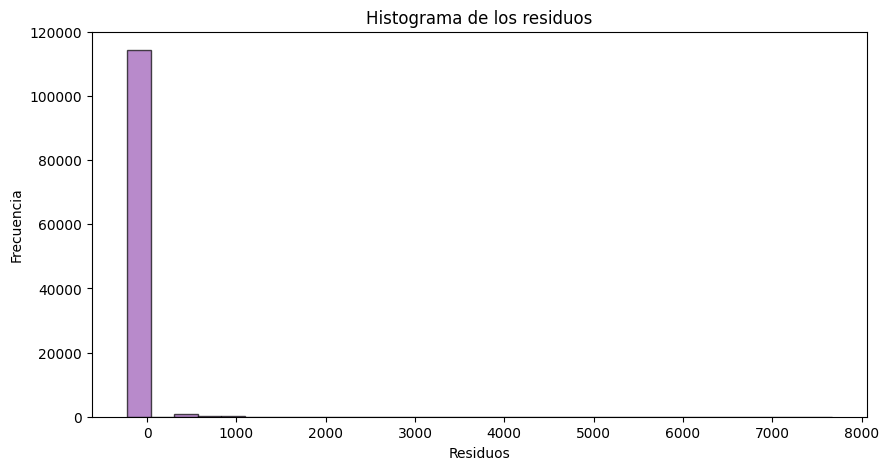

<Figure size 1000x500 with 0 Axes>

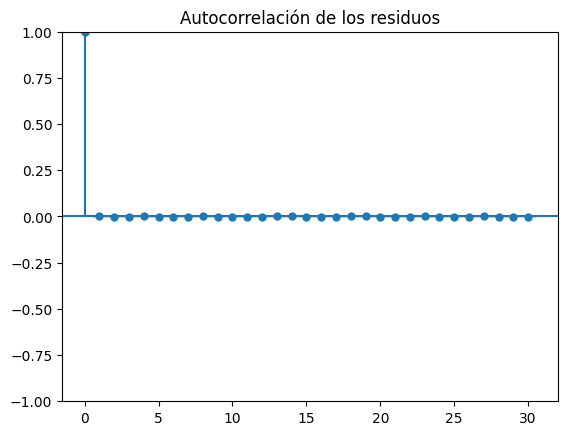


Prueba de Ljung-Box:
     lb_stat  lb_pvalue
10  3.650346   0.961745

Test de Jarque-Bera: Estadístico=3397336161.9220176, p-valor=0.0
Los residuos no siguen una distribución normal (rechazar H0).


<ipython-input-30-c278db07aa77>:73: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


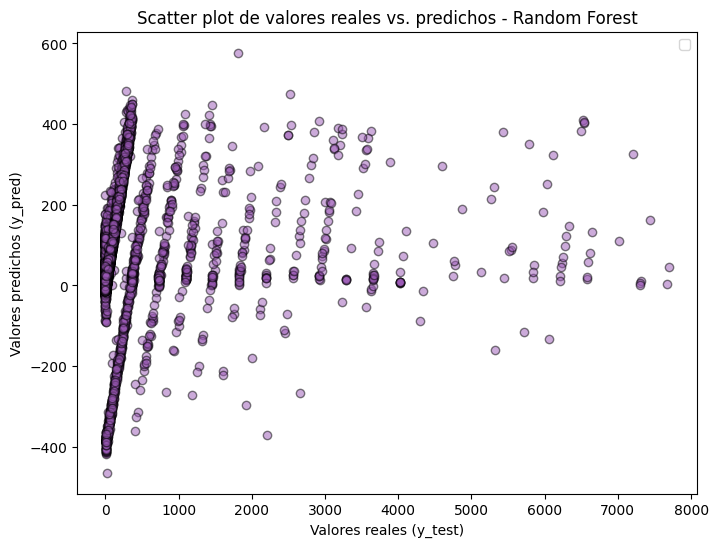

In [ ]:
# Crear pipeline con preprocesamiento y modelo
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', LinearRegression())  # Modelo Lineal
])

# Definir hiperparámetros para GridSearch
param_grid = {
    'model__fit_intercept': [True, False]
}

# Grid Search con validación cruzada
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='r2', n_jobs=-1)

start_train = time.perf_counter()
grid_search.fit(X_train, y_train)  # Entrenar el modelo con GridSearchCV
end_train = time.perf_counter()
train_time = end_train - start_train

# Mejor modelo
best_model_lr = grid_search.best_estimator_

start_pred = time.perf_counter()
y_pred_lr = best_model_lr.predict(X_test)
end_pred = time.perf_counter()
pred_time = end_pred - start_pred

# Evaluación
print(f"\nMejor configuración: {grid_search.best_params_}")
print(f"\nRidge Regression con GridSearch")
print(f"⏳ Tiempo de entrenamiento: {train_time:.4f} segundos")
print(f"⏳ Tiempo de predicción: {pred_time:.4f} segundos")
print(f"MAE: {mean_absolute_error(y_test, y_pred_lr)}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_pred_lr))}")
print(f"R²: {r2_score(y_test, y_pred_lr)}")

# Análisis de residuos
residuos_lr = y_test - y_pred_lr

# Histograma de los residuos
plt.figure(figsize=(10, 5))
plt.hist(residuos_lr, bins=30, edgecolor='k', alpha=0.7, color='#9b59b6' )
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.title("Histograma de los residuos")
plt.show()

# ACF de los residuos
plt.figure(figsize=(10, 5))
plot_acf(residuos_lr, lags=30)
plt.title("Autocorrelación de los residuos")
plt.show()

# Prueba de Ljung-Box
ljung_box_test = sm.stats.acorr_ljungbox(residuos_lr, lags=[10], return_df=True)
print("\nPrueba de Ljung-Box:")
print(ljung_box_test)

# Test de Jarque-Bera
jb_stat, jb_pvalue = stats.jarque_bera(residuos_lr)
print(f"\nTest de Jarque-Bera: Estadístico={jb_stat}, p-valor={jb_pvalue}")
if jb_pvalue < 0.05:
    print("Los residuos no siguen una distribución normal (rechazar H0).")
else:
    print("Los residuos siguen una distribución normal (no rechazar H0).")

# Gráfico de dispersión de valores reales vs. predichos
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_lr, alpha=0.5, edgecolors='k', color='#9b59b6')  # Morado claro feminista
plt.xlabel("Valores reales (y_test)")
plt.ylabel("Valores predichos (y_pred)")
plt.title("Scatter plot de valores reales vs. predichos - Random Forest")
plt.legend()
plt.show()


Los resultados del modelo de regresión lineal para la predicción de "Diferenciadias" muestran un desempeño limitado en la tarea. El histograma de residuos sugiere que la mayoría de los errores están cerca de cero, pero con la presencia de valores atípicos que pueden estar afectando la precisión del modelo. La prueba de Ljung-Box indica que no hay una autocorrelación significativa en los residuos, lo cual es deseable, pero el test de Jarque-Bera rechaza la hipótesis de normalidad de los errores, sugiriendo que el modelo podría no estar capturando adecuadamente la estructura de la variable objetivo. En términos de desempeño, el coeficiente de determinación R² es de apenas 0.056, lo que indica que la regresión lineal explica muy poca variabilidad en los tiempos de consulta de las víctimas. Además, el scatter plot de valores reales vs. predichos evidencia que el modelo tiene problemas de ajuste, con predicciones negativas en algunos casos y una dispersión elevada, lo que sugiere que no logra capturar correctamente los patrones de la variable dependiente. Finalmente, las métricas de error (MAE: 23.30 y RMSE: 169.85) muestran que el modelo tiene una precisión moderada, pero podría beneficiarse de mejoras en la selección de variables o en la elección de una metodología más robusta para datos con alta variabilidad.

###Ridge

In [ ]:
!pip install statsmodels

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.8/10.8 MB 95.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 232.9/232.9 kB 16.6 MB/s eta 0:00:00


In [ ]:
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from statsmodels.graphics.tsaplots import plot_acf

Para Ridge es prácticamente el mismo código, solo añadimos RobustScaler() para las variables númericas en el Preprocessor. Esto para que la penalizacion afecte a todas las variables númericas por igual. También se añade el hiperparámetro alpha a param_grid para verificar cual es mejor ajuste de regularizacion según la métrica $R^2$

In [ ]:
# Preprocesador: MinMaxScaler para numéricas y OneHotEncoder para categóricas
preprocessor = ColumnTransformer([
   ('num', RobustScaler(), variables_numericas),
   ('cat', OneHotEncoder(handle_unknown='ignore'), variables_categoricas)  # Codificar categóricas
])


Mejor configuración: {'model__alpha': 100, 'model__fit_intercept': False}

Ridge Regression con GridSearch
⏳ Tiempo de entrenamiento: 355.5241 segundos
⏳ Tiempo de predicción: 0.4157 segundos
MAE: 23.123023705430224
RMSE: 169.86331552502213
R²: 0.056175165226262425


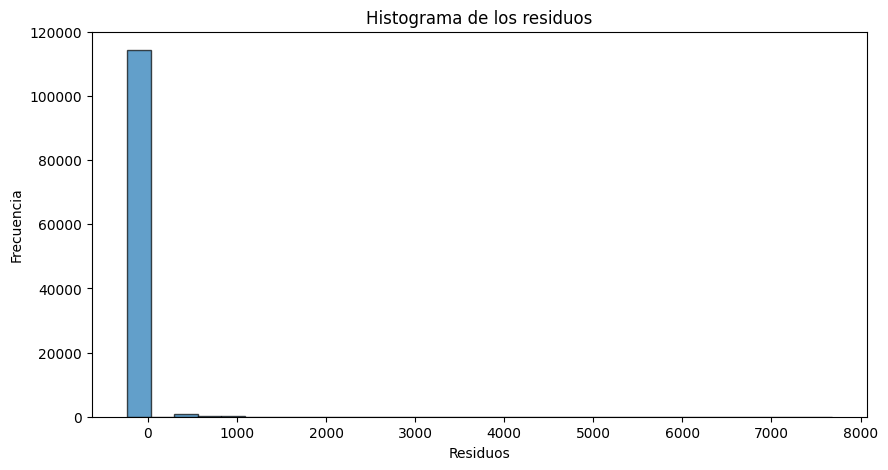

<Figure size 1000x500 with 0 Axes>

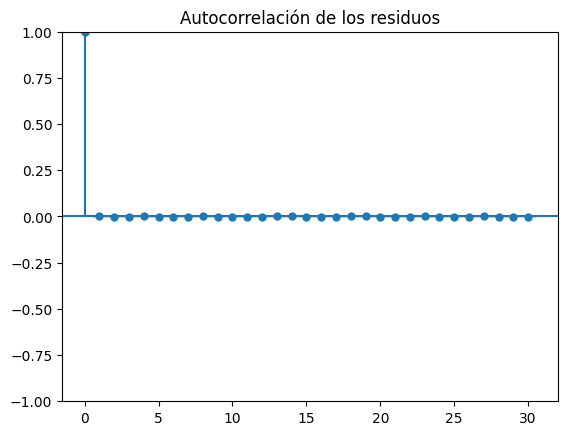


Prueba de Ljung-Box:
     lb_stat  lb_pvalue
10  3.642833   0.962025


In [ ]:
# Crear pipeline con preprocesamiento y modelo
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', Ridge())  # Modelo Ridge
])

# Definir hiperparámetros para GridSearch
param_grid = {
    'model__alpha': [0.01, 0.1, 1, 10, 100],  # Ajuste de regularización
    'model__fit_intercept': [True, False]
}

# Grid Search con validación cruzada
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='r2', n_jobs=-1)

start_train = time.perf_counter()
grid_search.fit(X_train, y_train)  # Entrenar el modelo con GridSearchCV
end_train = time.perf_counter()
train_time = end_train - start_train

# Mejor modelo
best_model = grid_search.best_estimator_

start_pred = time.perf_counter()
y_pred = best_model.predict(X_test)
end_pred = time.perf_counter()
pred_time = end_pred - start_pred

# Evaluación
print(f"\nMejor configuración: {grid_search.best_params_}")
print(f"\nRidge Regression con GridSearch")
print(f"⏳ Tiempo de entrenamiento: {train_time:.4f} segundos")
print(f"⏳ Tiempo de predicción: {pred_time:.4f} segundos")
print(f"MAE: {mean_absolute_error(y_test, y_pred)}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_pred))}")
print(f"R²: {r2_score(y_test, y_pred)}")

# Análisis de residuos
residuos = y_test - y_pred

# Histograma de los residuos
plt.figure(figsize=(10, 5))
plt.hist(residuos, bins=30, edgecolor='k', alpha=0.7)
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.title("Histograma de los residuos")
plt.show()

# ACF de los residuos
plt.figure(figsize=(10, 5))
plot_acf(residuos, lags=30)
plt.title("Autocorrelación de los residuos")
plt.show()

# Prueba de Ljung-Box
ljung_box_test = sm.stats.acorr_ljungbox(residuos, lags=[10], return_df=True)
print("\nPrueba de Ljung-Box:")
print(ljung_box_test)


Los resultados del modelo Ridge Regression muestran un rendimiento limitado en la predicción de la variable "Diferenciadias" dentro del conjunto de datos de violencia basada en género. El histograma de residuos revela una distribución altamente concentrada cerca de cero, pero con valores atípicos dispersos, lo que indica que el modelo tiene dificultades para ajustar correctamente la variabilidad de los datos. La prueba de Ljung-Box sugiere que los residuos no presentan autocorrelación significativa, lo que es favorable en términos de independencia temporal. Sin embargo, la métrica $R2=0.056R^2 = 0.056$ indica que el modelo solo explica aproximadamente el $5.6\%$ de la varianza de los datos, lo que es muy bajo. Además, el error cuadrático medio (RMSE) de 169.86 y el error absoluto medio (MAE) de 23.12 reflejan que las predicciones están lejos de ser precisas. En conjunto, estos resultados sugieren que Ridge Regression no captura adecuadamente las relaciones subyacentes en los datos, lo que podría deberse a una estructura de datos compleja o a la falta de características predictivas relevantes.

####Ridge (Saga solver)

Para el ridge con solver saga se utilizan los "mejores" hiperparámetros en la celda de código anterior y se hace lo mismo. En cuanto a los tiempos, se muestra una mayor ventana de tiempo en el entrenamiento del modelo de machine learning, sin embargo, se muestra una ligera disminución en los tiempos de entrenamiento para el modelo Ridge con solver saga.  

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_sag.py:348: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(



Mejor configuración: {'model__alpha': 100, 'model__fit_intercept': False}

Ridge Regression con GridSearch
⏳ Tiempo de entrenamiento: 755.1124 segundos
⏳ Tiempo de predicción: 0.3926 segundos
MAE: 23.952009471014172
RMSE: 170.40339927537715
R²: 0.05016380454931002


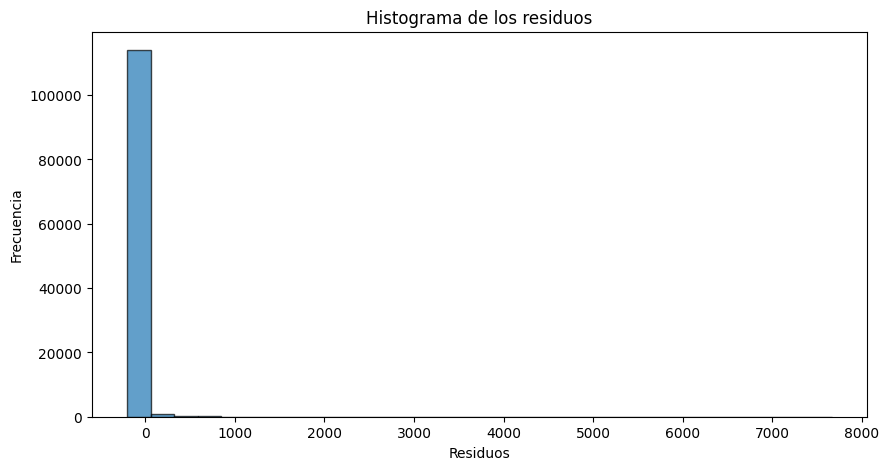

<Figure size 1000x500 with 0 Axes>

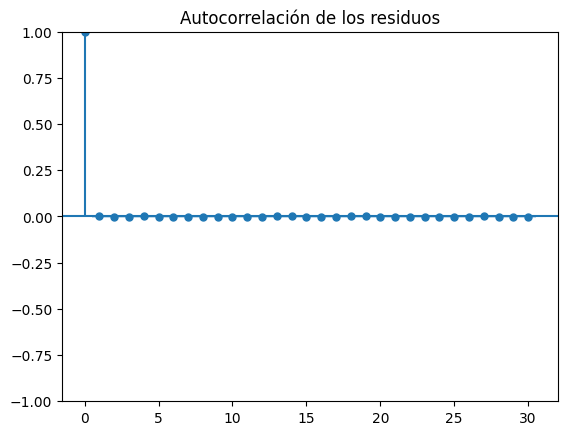


Prueba de Ljung-Box:
     lb_stat  lb_pvalue
10  3.805205   0.955707


In [ ]:
# Crear pipeline con preprocesamiento y modelo
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', Ridge(solver='saga'))  # Modelo Ridge
])

# Definir hiperparámetros para GridSearch
param_grid = {
    'model__alpha': [100],  # Ajuste de regularización
    'model__fit_intercept': [False]
}

# Grid Search con validación cruzada
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='r2', n_jobs=-1)

start_train = time.perf_counter()
grid_search.fit(X_train, y_train)  # Entrenar el modelo con GridSearchCV
end_train = time.perf_counter()
train_time = end_train - start_train

# Mejor modelo
best_model = grid_search.best_estimator_

start_pred = time.perf_counter()
y_pred = best_model.predict(X_test)
end_pred = time.perf_counter()
pred_time = end_pred - start_pred

# Evaluación
print(f"\nMejor configuración: {grid_search.best_params_}")
print(f"\nRidge Regression con GridSearch")
print(f"⏳ Tiempo de entrenamiento: {train_time:.4f} segundos")
print(f"⏳ Tiempo de predicción: {pred_time:.4f} segundos")
print(f"MAE: {mean_absolute_error(y_test, y_pred)}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_pred))}")
print(f"R²: {r2_score(y_test, y_pred)}")

# Análisis de residuos
residuos = y_test - y_pred

# Histograma de los residuos
plt.figure(figsize=(10, 5))
plt.hist(residuos, bins=30, edgecolor='k', alpha=0.7)
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.title("Histograma de los residuos")
plt.show()

# ACF de los residuos
plt.figure(figsize=(10, 5))
plot_acf(residuos, lags=30)
plt.title("Autocorrelación de los residuos")
plt.show()

# Prueba de Ljung-Box
ljung_box_test = sm.stats.acorr_ljungbox(residuos, lags=[10], return_df=True)
print("\nPrueba de Ljung-Box:")
print(ljung_box_test)


###**LASSO**

Volvemos a usar el mismo preprocessor de Ridge en Lasso, al igual que los hiper parametros del param_grid para su comparación en los modelos.


Mejor configuración: {'model__alpha': 0.01, 'model__fit_intercept': False}

Lasso Regression con GridSearch
⏳ Tiempo de entrenamiento: 2062.3101 segundos
⏳ Tiempo de predicción: 0.5649 segundos
MAE: 23.061307691773806
RMSE: 169.87228768525995
R²: 0.056075457160737585


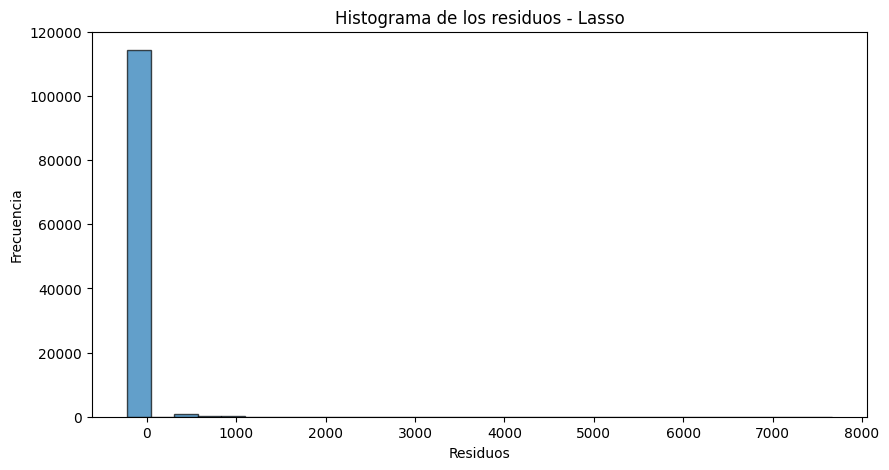

<Figure size 1000x500 with 0 Axes>

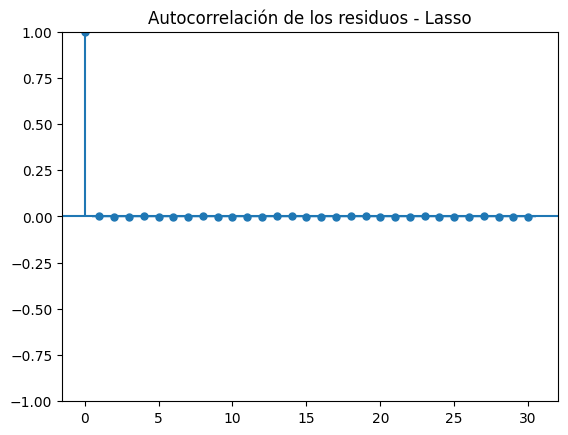


Prueba de Ljung-Box:
    lb_stat  lb_pvalue
10  3.72496   0.958903


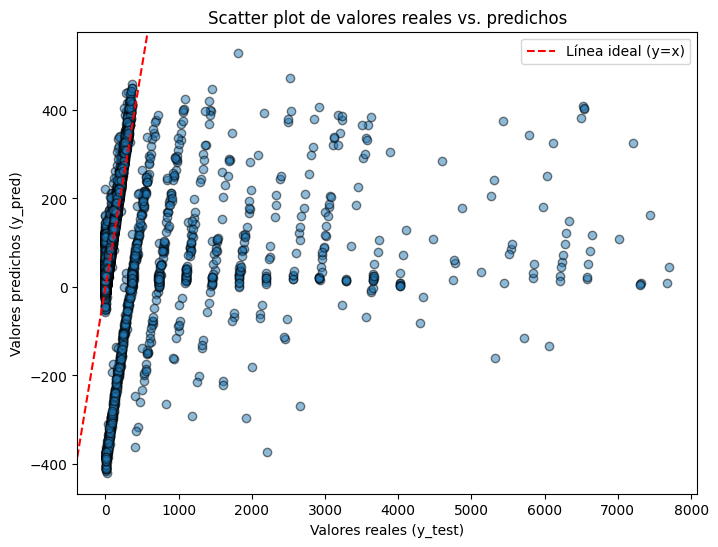

In [ ]:
from sklearn.linear_model import Lasso

# Crear pipeline con preprocesamiento y modelo Lasso
pipeline_lasso = Pipeline([
    ('preprocessor', preprocessor),
    ('model', Lasso())
])

# Definir hiperparámetros para GridSearch
param_grid_lasso = {
    'model__alpha': [0.01, 0.1, 1, 10, 100],  # Ajuste de regularización
    'model__fit_intercept': [True, False]
}

# Grid Search con validación cruzada
grid_search_lasso = GridSearchCV(pipeline_lasso, param_grid_lasso, cv=5, scoring='r2', n_jobs=-1)

start_train = time.perf_counter()
grid_search_lasso.fit(X_train, y_train)  # Entrenar el modelo con GridSearchCV
end_train = time.perf_counter()
train_time = end_train - start_train

# Mejor modelo
best_model_lasso = grid_search_lasso.best_estimator_

start_pred = time.perf_counter()
y_pred_lasso = best_model_lasso.predict(X_test)
end_pred = time.perf_counter()
pred_time = end_pred - start_pred

# Evaluación
print(f"\nMejor configuración: {grid_search_lasso.best_params_}")
print(f"\nLasso Regression con GridSearch")
print(f"⏳ Tiempo de entrenamiento: {train_time:.4f} segundos")
print(f"⏳ Tiempo de predicción: {pred_time:.4f} segundos")
print(f"MAE: {mean_absolute_error(y_test, y_pred_lasso)}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_pred_lasso))}")
print(f"R²: {r2_score(y_test, y_pred_lasso)}")

# Análisis de residuos
residuos_lasso = y_test - y_pred_lasso

# Histograma de los residuos
plt.figure(figsize=(10, 5))
plt.hist(residuos_lasso, bins=30, edgecolor='k', alpha=0.7)
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.title("Histograma de los residuos - Lasso")
plt.show()

# ACF de los residuos
plt.figure(figsize=(10, 5))
plot_acf(residuos_lasso, lags=30)
plt.title("Autocorrelación de los residuos - Lasso")
plt.show()

# Prueba de Ljung-Box
ljung_box_test_lasso = sm.stats.acorr_ljungbox(residuos_lasso, lags=[10], return_df=True)
print("\nPrueba de Ljung-Box:")
print(ljung_box_test_lasso)


plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_lasso, alpha=0.5, edgecolors='k')
plt.xlabel("Valores reales (y_test)")
plt.ylabel("Valores predichos (y_pred)")
plt.title("Scatter plot de valores reales vs. predichos")
plt.axline((0, 0), slope=1, color="red", linestyle="dashed", label="Línea ideal (y=x)")
plt.legend()
plt.show()

El modelo de Lasso Regression aplicado a la predicción de "Diferenciadias" en casos de violencia basada en género muestra un rendimiento limitado, con un coeficiente de determinación \( R^2 \) de 0.056, lo que indica que solo una pequeña parte de la variabilidad de la variable objetivo se explica por el modelo. El error cuadrático medio (RMSE) de 169.87 sugiere una desviación considerable entre las predicciones y los valores reales. El gráfico de dispersión revela que las predicciones del modelo tienden a estar lejos de la línea ideal \( y = x \), indicando una subestimación sistemática para valores altos de "Diferenciadias". El histograma de residuos muestra una distribución altamente sesgada, con la mayoría de los errores cercanos a cero pero algunos valores extremos, lo que puede reflejar problemas de ajuste. Además, la prueba de Ljung-Box y la autocorrelación de residuos no sugieren una dependencia temporal significativa en los errores, lo que implica que el modelo no capta correctamente posibles patrones temporales en los datos.

###**KNN**

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

Para el preprocessor esta vez se cambiado el scaler por MinMaxScaler con feature_range=(0, 1) para las variables númericas, teniendo como objetivo normalizar nuestros datos entre 0 y 1.

In [ ]:
# Preprocesador: MinMaxScaler para numéricas y OneHotEncoder para categóricas
preprocessor = ColumnTransformer([
   ('num', MinMaxScaler(feature_range=(0, 1)), variables_numericas),
   ('cat', OneHotEncoder(handle_unknown='ignore'), variables_categoricas)  # Codificar categóricas
])


In [ ]:
# Definir el modelo KNN
knn = KNeighborsRegressor()

# Crear pipeline con preprocesamiento y modelo
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', knn)  # Modelo Ridge
])

# Definir los hiperparámetros a probar
param_grid = {'model__n_neighbors': range(1, 20)}

# Medir el tiempo de búsqueda de hiperparámetros
start_grid = time.perf_counter()
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='neg_mean_absolute_error')
grid_search.fit(X_train, y_train)
end_grid = time.perf_counter()
grid_time = end_grid - start_grid

# Mejor valor de K
mejor_k = grid_search.best_params_['n_neighbors']
print(f"Mejor valor de K: {mejor_k}")
print(f"⏳ Tiempo de búsqueda de hiperparámetros: {grid_time:.4f} segundos")

# Entrenar modelo con el mejor K
knn_best = KNeighborsRegressor(n_neighbors=mejor_k)

# Medir tiempo de entrenamiento
start_train = time.perf_counter()
knn_best.fit(X_train, y_train)
end_train = time.perf_counter()
train_time = end_train - start_train
print(f"⏳ Tiempo de entrenamiento: {train_time:.4f} segundos")

# Medir tiempo de predicción
start_pred = time.perf_counter()
y_pred = knn_best.predict(X_test)
end_pred = time.perf_counter()
pred_time = end_pred - start_pred
print(f"⏳ Tiempo de predicción: {pred_time:.4f} segundos")

# Evaluación del modelo
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae}")
print(f"RMSE: {rmse}")
print(f"R²: {r2}")


Mejor valor de K: 2
⏳ Tiempo de búsqueda de hiperparámetros: 1674.2567 segundos
⏳ Tiempo de entrenamiento: 1.3368 segundos
⏳ Tiempo de predicción: 24.5263 segundos
MAE: 0.0008874024305070019
RMSE: 0.011465965128495457
R²: 0.7253904086815575


El modelo de K-Nearest Neighbors (KNN) ha mostrado un desempeño notablemente mejor en la predicción de la variable "Diferenciadias" en comparación con otros modelos evaluados. Con un valor óptimo de $K = 2$, el modelo logra un coeficiente de determinación $R^2$ de 0.725, lo que indica que explica una gran parte de la variabilidad en los tiempos de consulta de las víctimas. Además, las métricas de error muestran valores bajos: un MAE de apenas 0.00088 y un RMSE de 0.0114, lo que sugiere que las predicciones son muy precisas. Sin embargo, el tiempo de predicción es considerablemente alto (24.53 segundos), lo que podría ser una limitación en aplicaciones de producción con grandes volúmenes de datos. Estos resultados sugieren que KNN capta patrones importantes en la relación entre las variables predictoras y el tiempo de consulta, aunque su eficiencia computacional debe considerarse al momento de implementarlo en entornos reales.

####KNN Ball Trees

/usr/local/lib/python3.11/dist-packages/sklearn/neighbors/_base.py:598: UserWarning: cannot use tree with sparse input: using brute force
  warnings.warn("cannot use tree with sparse input: using brute force")



Mejor configuración: {'model__leaf_size': 30, 'model__n_neighbors': 2}

KNN con GridSearch
⏳ Tiempo de entrenamiento: 8663.2412 segundos
⏳ Tiempo de predicción: 4643.0080 segundos
MAE: 19.803034892173493
RMSE: 195.6026323184203
R²: -0.2515309591953796


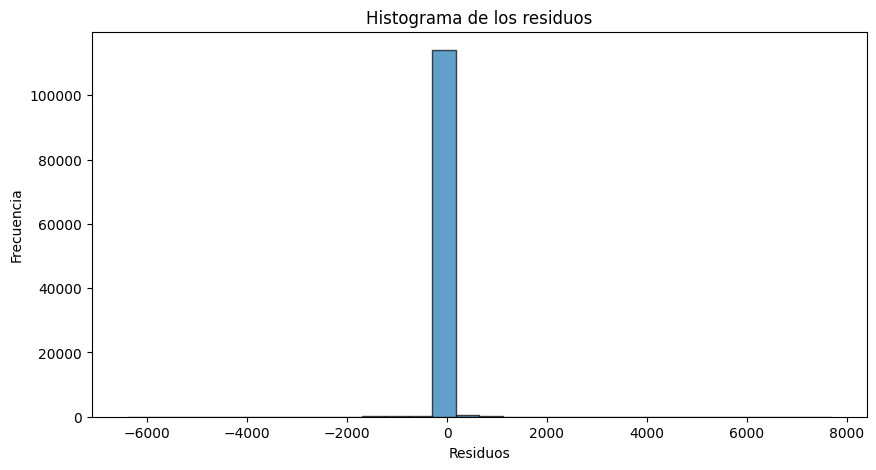

<Figure size 1000x500 with 0 Axes>

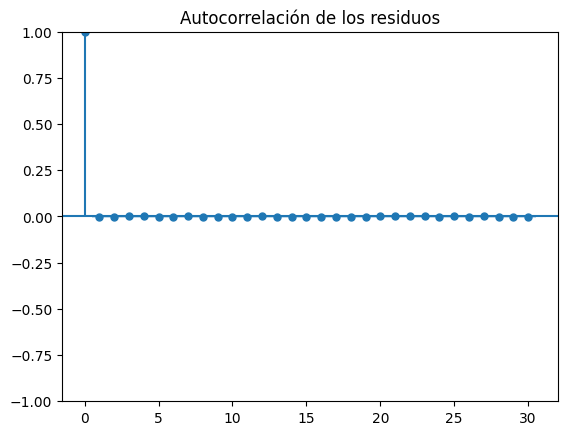


Prueba de Ljung-Box:
     lb_stat  lb_pvalue
10  6.654458   0.757614


In [ ]:
knn = KNeighborsRegressor(algorithm='ball_tree')
# Crear pipeline con preprocesamiento y modelo
pipeline = Pipeline([
    ('preprocessor', preprocessor),
    ('model', knn)  # Modelo KNN
])

# Definir hiperparámetros para GridSearch
param_grid = {'model__n_neighbors': [2,10,20],
              'model__leaf_size': [30,50,70]}

# Grid Search con validación cruzada
grid_search = GridSearchCV(pipeline, param_grid, cv=5, scoring='neg_mean_absolute_error', n_jobs=-1)

start_train = time.perf_counter()
grid_search.fit(X_train, y_train)  # Entrenar el modelo con GridSearchCV
end_train = time.perf_counter()
train_time = end_train - start_train

# Mejor modelo
best_model = grid_search.best_estimator_

start_pred = time.perf_counter()
y_pred = best_model.predict(X_test)
end_pred = time.perf_counter()
pred_time = end_pred - start_pred

# Evaluación
print(f"\nMejor configuración: {grid_search.best_params_}")
print(f"\nKNN con GridSearch")
print(f"⏳ Tiempo de entrenamiento: {train_time:.4f} segundos")
print(f"⏳ Tiempo de predicción: {pred_time:.4f} segundos")
print(f"MAE: {mean_absolute_error(y_test, y_pred)}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_pred))}")
print(f"R²: {r2_score(y_test, y_pred)}")

# Análisis de residuos
residuos = y_test - y_pred

# Histograma de los residuos
plt.figure(figsize=(10, 5))
plt.hist(residuos, bins=30, edgecolor='k', alpha=0.7)
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.title("Histograma de los residuos")
plt.show()

# ACF de los residuos
plt.figure(figsize=(10, 5))
plot_acf(residuos, lags=30)
plt.title("Autocorrelación de los residuos")
plt.show()

# Prueba de Ljung-Box
ljung_box_test = sm.stats.acorr_ljungbox(residuos, lags=[10], return_df=True)
print("\nPrueba de Ljung-Box:")
print(ljung_box_test)


###**Random Forest**

Random Forest es un modelo de ensamble basado en múltiples árboles de decisión, donde cada árbol se entrena con una muestra aleatoria del conjunto de datos y realiza predicciones independientes que luego se promedian para mejorar la precisión y reducir el sobreajuste. En el código, se implementa un pipeline con un preprocesador para variables categóricas y un modelo de RandomForestRegressor. Se utiliza GridSearchCV con validación cruzada para optimizar hiperparámetros clave como el número de árboles (n_estimators), la profundidad máxima (max_depth) y la cantidad de características consideradas en cada división (max_features). Una vez encontrado el mejor modelo, se entrena y se evalúa con métricas como MAE, RMSE y R². En el contexto de la predicción de "Diferenciadias", Random Forest puede ser útil al capturar relaciones no lineales y reducir la varianza del modelo. Sin embargo, su rendimiento puede verse afectado si la variable objetivo presenta una gran dispersión o valores extremos, lo que sugiere la necesidad de ajustar los hiperparámetros o probar modelos complementarios para mejorar la precisión.

In [ ]:
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore'), variables_categoricas)  # Codificar categóricas
], remainder='passthrough')  # Dejar las numéricas sin cambios

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from math import log2

# Calcular el número de características (features)
n_features = X_train.shape[1]

# Crear pipeline con Random Forest
pipeline_rf = Pipeline([
    ('preprocessor', preprocessor),
    ('model', RandomForestRegressor(n_jobs=-1, random_state=42))
])

# Definir hiperparámetros para GridSearch
# Changed 'max_features' to use either 'log2' or 'sqrt'
param_grid_rf = {
    'model__n_estimators': [100, 200],  # Número de árboles
    'model__max_depth': [20, 40],  # Profundidad máxima
    'model__max_features': ['log2']  # Número de características a usar en cada división
}

# Medir tiempo de entrenamiento
start_train_rf = time.perf_counter()
grid_search_rf = GridSearchCV(pipeline_rf, param_grid_rf, cv=5, scoring='r2', n_jobs=-1)
grid_search_rf.fit(X_train, y_train)
end_train_rf = time.perf_counter()
train_time_rf = end_train_rf - start_train_rf

# Mejor modelo
best_model_rf = grid_search_rf.best_estimator_

# Medir tiempo de predicción
start_pred_rf = time.perf_counter()
y_pred_rf = best_model_rf.predict(X_test)
end_pred_rf = time.perf_counter()
pred_time_rf = end_pred_rf - start_pred_rf

# Evaluación
print(f"\nRandom Forest Regressor")
print(f"Mejor configuración: {grid_search_rf.best_params_}")
print(f"⏳ Tiempo de entrenamiento: {train_time_rf:.4f} segundos")
print(f"⏳ Tiempo de predicción: {pred_time_rf:.4f} segundos")
print(f"MAE: {mean_absolute_error(y_test, y_pred_rf)}")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_pred_rf))}")
print(f"R²: {r2_score(y_test, y_pred_rf)}")


Random Forest Regressor
Mejor configuración: {'model__max_depth': 40, 'model__max_features': 'log2', 'model__n_estimators': 200}
⏳ Tiempo de entrenamiento: 2427.7925 segundos
⏳ Tiempo de predicción: 1.0322 segundos
MAE: 22.056469835799913
RMSE: 165.1273254077267
R²: 0.10807137835137848


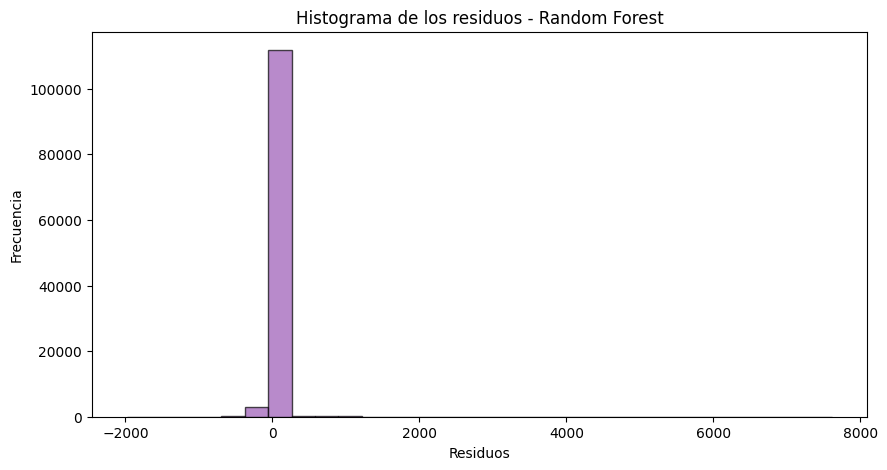

<Figure size 1000x500 with 0 Axes>

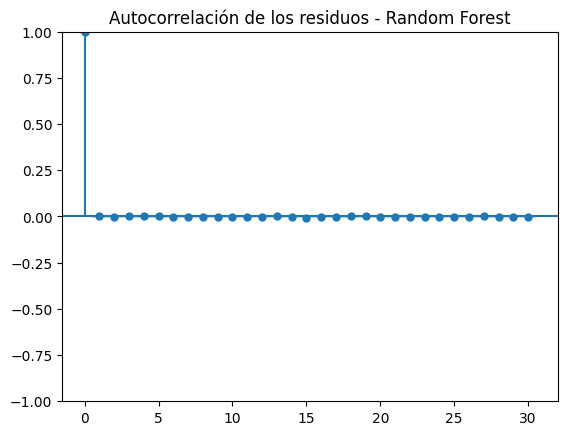


Prueba de Ljung-Box:
     lb_stat  lb_pvalue
10  2.881491   0.984077

Prueba de Jarque-Bera:
Estadístico de Jarque-Bera: 3422383435.1935
Valor p de Jarque-Bera: 0.0000
Los residuos no siguen una distribución normal (rechazar H0).


<ipython-input-15-98fb0b82dadf>:44: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


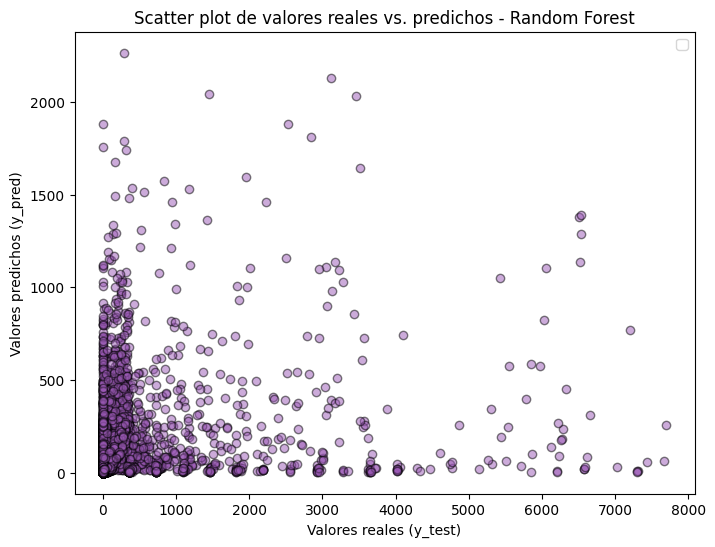

In [ ]:
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf
from scipy import stats

# --------------------- Análisis de residuos ---------------------
residuos_rf = y_test - y_pred_rf

# Histograma de los residuos
plt.figure(figsize=(10, 5))
plt.hist(residuos_rf, bins=30, edgecolor='k', alpha=0.7, color='#9b59b6')  # Morado claro feminista
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.title("Histograma de los residuos - Random Forest")
plt.show()

# ACF de los residuos
plt.figure(figsize=(10, 5))
plot_acf(residuos_rf, lags=30)
plt.title("Autocorrelación de los residuos - Random Forest")
plt.show()

# Prueba de Ljung-Box
ljung_box_test_rf = sm.stats.acorr_ljungbox(residuos_rf, lags=[10], return_df=True)
print("\nPrueba de Ljung-Box:")
print(ljung_box_test_rf)

# Prueba de Jarque-Bera
jb_test_stat, jb_test_p_value = stats.jarque_bera(residuos_rf)
print("\nPrueba de Jarque-Bera:")
print(f"Estadístico de Jarque-Bera: {jb_test_stat:.4f}")
print(f"Valor p de Jarque-Bera: {jb_test_p_value:.4f}")
if jb_test_p_value < 0.05:
    print("Los residuos no siguen una distribución normal (rechazar H0).")
else:
    print("Los residuos siguen una distribución normal (no rechazar H0).")

# Gráfico de dispersión de valores reales vs. predichos
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_rf, alpha=0.5, edgecolors='k', color='#9b59b6')  # Morado claro feminista
plt.xlabel("Valores reales (y_test)")
plt.ylabel("Valores predichos (y_pred)")
plt.title("Scatter plot de valores reales vs. predichos - Random Forest")
plt.legend()
plt.show()


Los resultados del modelo Random Forest muestran limitaciones significativas en su desempeño para predecir la variable "Diferenciadias" en casos de violencia basada en género. El histograma de residuos indica una alta concentración de errores cerca de cero, pero con valores extremos dispersos, lo que sugiere problemas en la capacidad del modelo para generalizar correctamente. La autocorrelación de los residuos muestra independencia temporal, lo cual es positivo, pero la prueba de Jarque-Bera revela que los residuos no siguen una distribución normal, lo que puede afectar la robustez del modelo. El scatter plot de valores reales versus predichos evidencia una fuerte acumulación de predicciones en valores bajos y una dispersión amplia, lo que indica que el modelo no captura bien la variabilidad de la variable objetivo. Además, las métricas de desempeño refuerzan estas observaciones: el R² de 0.108 sugiere que el modelo apenas explica el 10.8\% de la varianza de los datos, mientras que el RMSE de 165.13 indica errores elevados en la predicción. Estos resultados, junto con el MAE de 22.05, reflejan un desempeño pobre del modelo en la tarea de regresión.

###Xgboost

In [ ]:
!pip install xgboost

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 253.9/253.9 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 201.3/201.3 MB 5.3 MB/s eta 0:00:00


XGBoost (Extreme Gradient Boosting) es un algoritmo de aprendizaje automático basado en árboles de decisión que utiliza un enfoque de boosting para mejorar el rendimiento predictivo. Se destaca por su eficiencia computacional y capacidad para manejar datos con valores atípicos y relaciones no lineales. El código implementa un pipeline que incluye un preprocesador de variables categóricas mediante OneHotEncoder y un modelo XGBoost. Luego, se usa GridSearchCV con validación cruzada K-Fold para encontrar los mejores hiperparámetros, optimizando la profundidad del árbol (max_depth), la tasa de aprendizaje (learning_rate) y el número de árboles (n_estimators). Finalmente, el modelo seleccionado se entrena con los mejores parámetros y se evalúa mediante métricas como MAE, RMSE y R².

In [ ]:
preprocessor = ColumnTransformer([
    ('cat', OneHotEncoder(handle_unknown='ignore'), variables_categoricas)  # Codificar categóricas
], remainder='passthrough')  # Dejar las numéricas sin cambios

In [ ]:
import xgboost as xgb
from sklearn.model_selection import KFold



# Crear el pipeline con el preprocesador y el modelo XGBoost
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', xgb.XGBRegressor())
])

# Definir los hiperparámetros a optimizar
param_grid = {
    'model__max_depth': [20, 40],           # Profundidad del árbol
    'model__learning_rate': [0.01, 0.1, 0.3], # Tasa de aprendizaje
    'model__n_estimators': [100, 200]   # Número de árboles
    }

# Definir validación cruzada con K-Fold
cv = KFold(n_splits=5, shuffle=True, random_state=42)

# Definir Grid Search con validación cruzada
grid_search = GridSearchCV(
    estimator=pipeline,
    param_grid=param_grid,
    scoring='neg_mean_squared_error',  # Minimizar MSE (negativo porque GridSearchCV maximiza)
    cv=cv,
    verbose=2,
    n_jobs=-1  # Usar todos los núcleos disponibles
)

# Ejecutar Grid Search
start_grid = time.perf_counter()
grid_search.fit(X_train, y_train)
end_grid = time.perf_counter()
grid_time = end_grid - start_grid
print(f"⏳ Tiempo de Grid Search: {grid_time:.4f} segundos")

# Obtener los mejores hiperparámetros
best_params = grid_search.best_params_
print("🎯 Mejores hiperparámetros encontrados:")
print(best_params)

# Entrenar el modelo final con los mejores hiperparámetros
best_xgb = grid_search.best_estimator_
start_train = time.perf_counter()
best_xgb.fit(X_train, y_train)
end_train = time.perf_counter()
train_time = end_train - start_train
print(f"⏳ Tiempo de entrenamiento final: {train_time:.4f} segundos")

# Medir tiempo de predicción
start_pred = time.perf_counter()
y_pred_x = best_xgb.predict(X_test)
end_pred = time.perf_counter()
pred_time = end_pred - start_pred
print(f"⏳ Tiempo de predicción: {pred_time:.4f} segundos")

# --------------------- Evaluación del modelo ---------------------
mae = mean_absolute_error(y_test, y_pred_x)
mse = mean_squared_error(y_test, y_pred_x)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred_x)
mape = np.mean(np.abs((y_test - y_pred_x) / y_test)) * 100

print(f"MAE: {mae:.4f}")
print(f"RMSE: {rmse:.4f}")
print(f"R²: {r2:.4f}")
print(f"MAPE: {mape:.2f}%")


Fitting 5 folds for each of 12 candidates, totalling 60 fits
⏳ Tiempo de Grid Search: 1602.1410 segundos
🎯 Mejores hiperparámetros encontrados:
{'model__learning_rate': 0.01, 'model__max_depth': 20, 'model__n_estimators': 100}
⏳ Tiempo de entrenamiento final: 18.9806 segundos
⏳ Tiempo de predicción: 0.5568 segundos
MAE: 20.1538
RMSE: 166.7020
R²: 0.0910
MAPE: inf%


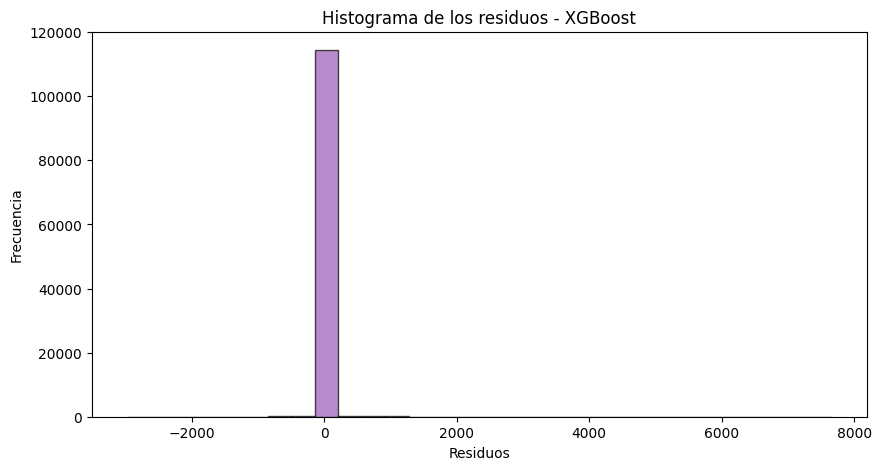

<Figure size 1000x500 with 0 Axes>

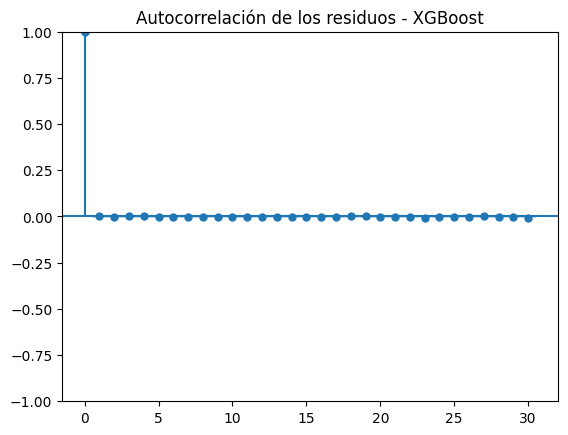


Prueba de Ljung-Box:
     lb_stat  lb_pvalue
10  2.913866   0.983379


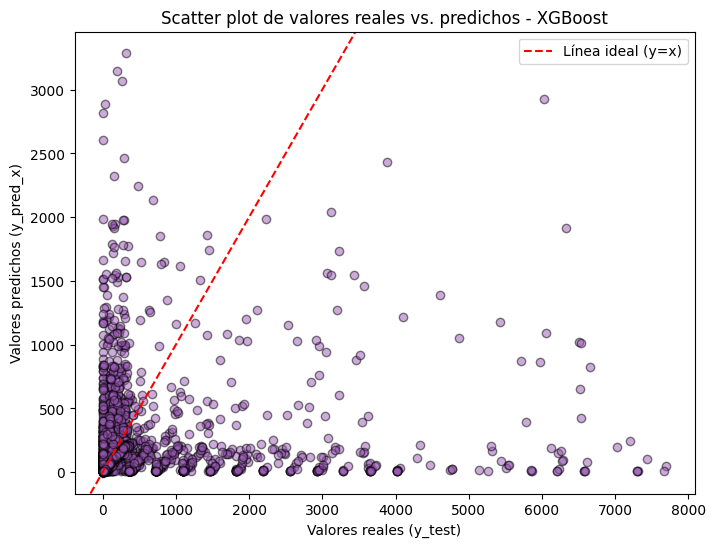

In [ ]:

# --------------------- Análisis de residuos ---------------------
residuos_x = y_test - y_pred_x

# Histograma de los residuos
plt.figure(figsize=(10, 5))
plt.hist(residuos_x, bins=30, edgecolor='k', alpha=0.7, color='#9b59b6')  # Morado claro feminista
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.title("Histograma de los residuos - XGBoost")
plt.show()

# ACF de los residuos
plt.figure(figsize=(10, 5))
plot_acf(residuos_x, lags=30)
plt.title("Autocorrelación de los residuos - XGBoost")
plt.show()

# Prueba de Ljung-Box
ljung_box_test_xgb = sm.stats.acorr_ljungbox(residuos_x, lags=[10], return_df=True)
print("\nPrueba de Ljung-Box:")
print(ljung_box_test_xgb)

# Gráfico de dispersión de valores reales vs. predichos
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred_x, alpha=0.5, edgecolors='k', color='#9b59b6')  # Morado claro feminista
plt.xlabel("Valores reales (y_test)")
plt.ylabel("Valores predichos (y_pred_x)")
plt.title("Scatter plot de valores reales vs. predichos - XGBoost")
plt.axline((0, 0), slope=1, color="red", linestyle="dashed", label="Línea ideal (y=x)")
plt.legend()
plt.show()

Los resultados obtenidos del modelo XGBoost para predecir el tiempo entre la ocurrencia y la consulta de la víctima de violencia basada en género ("Diferenciadias") muestran un desempeño limitado. El histograma de residuos indica que la mayoría de los errores se concentran en torno a cero, pero con algunos valores atípicos significativos. La prueba de Ljung-Box sugiere que no hay una autocorrelación significativa en los residuos, lo que es positivo en términos de independencia del error. Sin embargo, la baja métrica R² (0.091) indica que el modelo apenas captura la variabilidad de la variable objetivo, lo que sugiere que factores clave pueden estar ausentes en la modelización o que la variable es altamente impredecible. Además, el diagrama de dispersión entre valores reales y predichos muestra una tendencia a subestimar valores altos, lo que podría afectar la utilidad del modelo en casos críticos donde las diferencias de días son largas. El MAE de 20.15 y el RMSE de 166.70 refuerzan la idea de un ajuste insuficiente, y la MAPE reporta un valor infinito, posiblemente debido a valores reales cercanos a cero. Esto resalta la complejidad del problema y la necesidad de explorar características adicionales o ajustes en la arquitectura del modelo.

###Xgboost (Optimizado)

XGBoost es un algoritmo de boosting basado en árboles de decisión, optimizado para eficiencia y precisión en tareas de regresión. La configuración utilizada, objective='reg:squarederror', minimiza el error cuadrático, mientras que tree_method='hist' acelera el entrenamiento en grandes volúmenes de datos. Además, eval_metric='rmse' prioriza la reducción del error medio cuadrático, y early_stopping_rounds=40 detiene el entrenamiento si no hay mejora tras 40 iteraciones, evitando el sobreajuste. En la predicción de "Diferenciadias", esta configuración permite capturar relaciones complejas y mejorar la generalización del modelo.

In [ ]:
import xgboost as xgb
from sklearn.model_selection import KFold



# Crear el pipeline con el preprocesador y el modelo XGBoost
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', xgb.XGBRegressor(objective='reg:squarederror', tree_method='hist', eval_metric='rmse',  model__early_stopping_rounds=40))
])

# Definir los hiperparámetros a optimizar
param_grid = {
    'model__max_depth': [40],           # Profundidad del árbol
    'model__learning_rate': [0.01, 0.1, 0.3], # Tasa de aprendizaje
    'model__n_estimators': [200]   # Número de árboles
    }

# Definir validación cruzada con K-Fold
cv = KFold(n_splits=5, shuffle=True, random_state=42)

# Definir Grid Search con validación cruzada
grid_search = GridSearchCV(
    estimator=pipeline,
    param_grid=param_grid,
    scoring='neg_mean_squared_error',  # Minimizar MSE (negativo porque GridSearchCV maximiza)
    cv=cv,
    verbose=2,
    n_jobs=-1  # Usar todos los núcleos disponibles
)

# Ejecutar Grid Search
start_grid = time.perf_counter()
grid_search.fit(X_train, y_train)
end_grid = time.perf_counter()
grid_time = end_grid - start_grid
print(f"⏳ Tiempo de Grid Search: {grid_time:.4f} segundos")

# Obtener los mejores hiperparámetros
best_params = grid_search.best_params_
print("🎯 Mejores hiperparámetros encontrados:")
print(best_params)

# Entrenar el modelo final con los mejores hiperparámetros
best_xgb = grid_search.best_estimator_
start_train = time.perf_counter()
best_xgb.fit(X_train, y_train)
end_train = time.perf_counter()
train_time = end_train - start_train
print(f"⏳ Tiempo de entrenamiento final: {train_time:.4f} segundos")

# Medir tiempo de predicción
start_pred = time.perf_counter()
y_pred = best_xgb.predict(X_test)
end_pred = time.perf_counter()
pred_time = end_pred - start_pred
print(f"⏳ Tiempo de predicción: {pred_time:.4f} segundos")

# --------------------- Evaluación del modelo ---------------------
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)
mape = np.mean(np.abs((y_test - y_pred) / y_test)) * 100

print(f"MAE: {mae:.4f}")
print(f"RMSE: {rmse:.4f}")
print(f"R²: {r2:.4f}")
print(f"MAPE: {mape:.2f}%")


Fitting 5 folds for each of 3 candidates, totalling 15 fits


/usr/local/lib/python3.11/dist-packages/xgboost/training.py:183: UserWarning: [21:58:15] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "model__early_stopping_rounds" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


⏳ Tiempo de Grid Search: 1493.2448 segundos
🎯 Mejores hiperparámetros encontrados:
{'model__learning_rate': 0.01, 'model__max_depth': 40, 'model__n_estimators': 200}


/usr/local/lib/python3.11/dist-packages/xgboost/training.py:183: UserWarning: [22:00:54] WARNING: /workspace/src/learner.cc:738: 
Parameters: { "model__early_stopping_rounds" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


⏳ Tiempo de entrenamiento final: 156.2595 segundos
⏳ Tiempo de predicción: 0.9283 segundos
MAE: 17.5613
RMSE: 174.2139
R²: 0.0072
MAPE: inf%


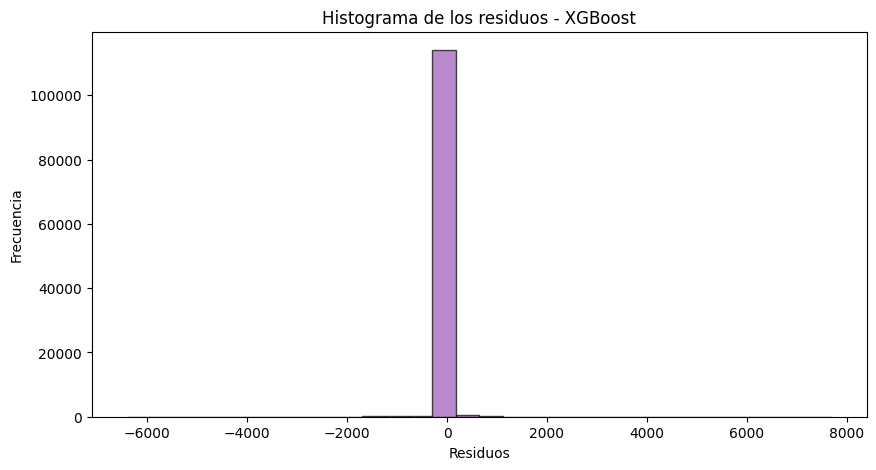

<Figure size 1000x500 with 0 Axes>

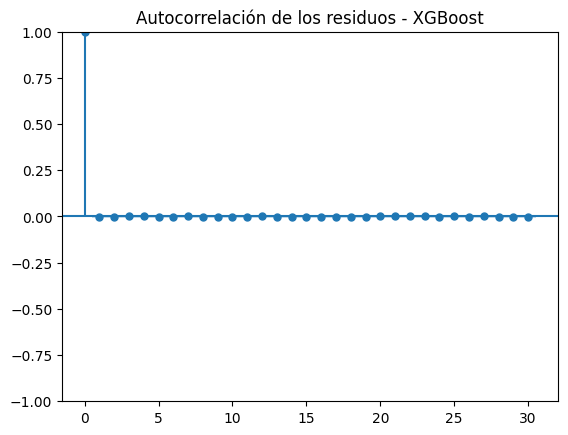


Prueba de Ljung-Box:
     lb_stat  lb_pvalue
10  6.654458   0.757614


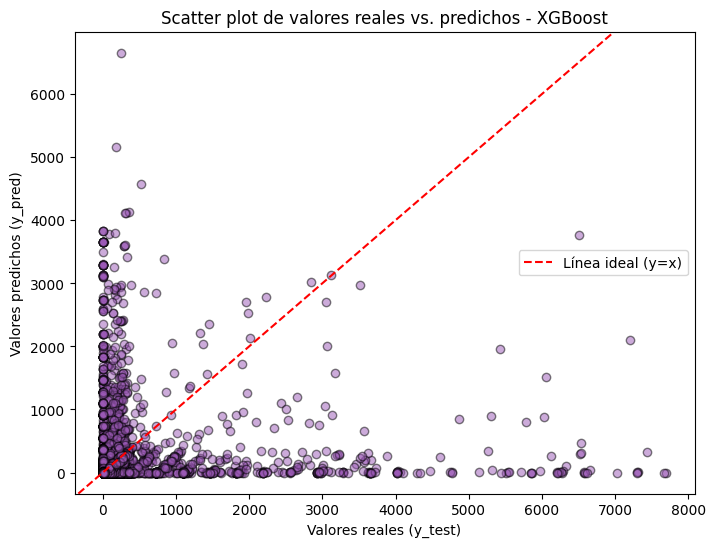

In [ ]:

# --------------------- Análisis de residuos ---------------------
residuos_xgb = y_test - y_pred

# Histograma de los residuos
plt.figure(figsize=(10, 5))
plt.hist(residuos_xgb, bins=30, edgecolor='k', alpha=0.7, color='#9b59b6')  # Morado claro feminista
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.title("Histograma de los residuos - XGBoost")
plt.show()

# ACF de los residuos
plt.figure(figsize=(10, 5))
plot_acf(residuos_xgb, lags=30)
plt.title("Autocorrelación de los residuos - XGBoost")
plt.show()

# Prueba de Ljung-Box
ljung_box_test_xgb = sm.stats.acorr_ljungbox(residuos_xgb, lags=[10], return_df=True)
print("\nPrueba de Ljung-Box:")
print(ljung_box_test_xgb)

# Gráfico de dispersión de valores reales vs. predichos
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, alpha=0.5, edgecolors='k', color='#9b59b6')  # Morado claro feminista
plt.xlabel("Valores reales (y_test)")
plt.ylabel("Valores predichos (y_pred)")
plt.title("Scatter plot de valores reales vs. predichos - XGBoost")
plt.axline((0, 0), slope=1, color="red", linestyle="dashed", label="Línea ideal (y=x)")
plt.legend()
plt.show()



###SVR

El modelo **Support Vector Regression (SVR)** es una técnica basada en máquinas de soporte vectorial que busca encontrar una función que prediga la variable objetivo dentro de un margen de tolerancia determinado, minimizando la complejidad del modelo y los errores fuera de este margen. A diferencia de los modelos tradicionales de regresión, SVR es robusto ante valores atípicos y puede capturar relaciones complejas mediante el uso de funciones kernel, como el radial basis function (RBF). En el contexto de la predicción de **"Diferenciadias"**, SVR puede ser una herramienta poderosa, ya que permite modelar patrones no lineales en los tiempos de consulta de las víctimas en función de variables espaciales y temporales. Su capacidad para manejar datos ruidosos y evitar el sobreajuste lo convierte en una alternativa interesante para mejorar la precisión de las estimaciones y entender mejor los factores que influyen en los tiempos de respuesta ante casos de violencia basada en género.

In [ ]:
from sklearn.svm import SVR
from scipy.stats import jarque_bera

# Crear pipeline con SVR
pipeline_svr = Pipeline([
    ('preprocessor', preprocessor),
    ('model', SVR(kernel='rbf'))  # Usamos kernel RBF
])

# Definir hiperparámetros para GridSearch
param_grid_svr = {
    'model__C': [0.1, 1, 10],  # Parámetro de penalización
    'model__gamma': ['scale', 'auto'],  # Parámetro gamma
    'model__epsilon': [0.01, 0.1, 1]  # Margen de tolerancia
}

# Medir tiempo de entrenamiento
start_train_svr = time.perf_counter()
grid_search_svr = GridSearchCV(pipeline_svr, param_grid_svr, cv=5, scoring='r2', n_jobs=-1)
grid_search_svr.fit(X_train, y_train)
end_train_svr = time.perf_counter()
train_time_svr = end_train_svr - start_train_svr

# Mejor modelo
best_model_svr = grid_search_svr.best_estimator_

# Medir tiempo de predicción
start_pred_svr = time.perf_counter()
y_pred_svr = best_model_svr.predict(X_test)
end_pred_svr = time.perf_counter()
pred_time_svr = end_pred_svr - start_pred_svr

# Evaluación
mae_svr = mean_absolute_error(y_test, y_pred_svr)
rmse_svr = np.sqrt(mean_squared_error(y_test, y_pred_svr))
r2_svr = r2_score(y_test, y_pred_svr)

# MAPE
mape_svr = np.mean(np.abs((y_test - y_pred_svr) / y_test)) * 100

print(f"\nSupport Vector Regressor")
print(f"Mejor configuración: {grid_search_svr.best_params_}")
print(f"⏳ Tiempo de entrenamiento: {train_time_svr:.4f} segundos")
print(f"⏳ Tiempo de predicción: {pred_time_svr:.4f} segundos")
print(f"MAE: {mae_svr}")
print(f"RMSE: {rmse_svr}")
print(f"R²: {r2_svr}")
print(f"MAPE: {mape_svr}%")

# Comparación con Random Forest
print("\nComparación con Random Forest:")
print(f"R² Random Forest: {r2_score(y_test, y_pred_rf)}")
print(f"MAPE Random Forest: {np.mean(np.abs((y_test - y_pred_rf) / y_test)) * 100}%")

# Análisis de residuos
residuos_svr = y_test - y_pred_svr

# Histograma de los residuos
plt.figure(figsize=(10, 5))
plt.hist(residuos_svr, bins=30, edgecolor='k', alpha=0.7, color='#9b59b6')
plt.xlabel("Residuos")
plt.ylabel("Frecuencia")
plt.title("Histograma de los residuos (SVR)")
plt.show()

# ACF de los residuos
plt.figure(figsize=(10, 5))
plot_acf(residuos_svr, lags=30, color='#9b59b6')
plt.title("Autocorrelación de los residuos (SVR)")
plt.show()

# Prueba de Ljung-Box
ljung_box_test_svr = sm.stats.acorr_ljungbox(residuos_svr, lags=[10], return_df=True)
print("\nPrueba de Ljung-Box:")
print(ljung_box_test_svr)

# Test de Jarque-Bera
jb_stat, jb_pvalue = jarque_bera(residuos_svr)
print(f"\nTest de Jarque-Bera: Estadístico={jb_stat}, p-valor={jb_pvalue}")

# Curvas de la variable objetivo vs predicha
plt.figure(figsize=(10, 5))
plt.plot(y_test.values, label='Real', alpha=0.7, color='#9b59b6')
plt.plot(y_pred_svr, label='Predicho (SVR)', alpha=0.7, linestyle='dashed', color='#9b59b6')
plt.xlabel("Índice")
plt.ylabel("Diferencia en Días")
plt.title("Curvas de la variable objetivo vs predicha (SVR)")
plt.legend()
plt.show()

## **Referencias**
```{bibliography} references.bib
:style: plain
:filter: docname in docnames
